# Multilevel/Hierarchical regression with R: `brms`, `rstanarm`, `bayesplot`, and `loo`

This workshop's goal—which is facilitated by this notebook—is to give attendees the confidence to conduct Bayesian regression analyses with `R` for their research projects.

[`brms`](https://paul-buerkner.github.io/brms/index.html) provides an interface to fit Bayesian generalized (non-)linear multivariate multilevel models using `Stan`.  The formula syntax is very similar to that of the package `lme4` to provide a familiar and simple interface for performing regression analyses.

[`rstanarm`](https://mc-stan.org/rstanarm/index.html) emulates other `R` model-fitting functions but uses `Stan` for the back-end estimation.  The primary target audience is people who would be open to Bayesian inference if using Bayesian software were easier but would use frequentist software otherwise.

[`bayesplot`](https://mc-stan.org/bayesplot/index.html) provides an extensive library of plotting functions for use after fitting Bayesian models (typically with MCMC).

[`loo`](https://mc-stan.org/loo/index.html) allows users to compute efficient approximate leave-one-out cross-validation for fitted Bayesian models, as well as model weights that can be used to average predictive distributions.

To motivate this workshop, we'll work with examples from [Regression and Other Stories](https://avehtari.github.io/ROS-Examples/examples.html), [Data Analysis Using Regression and Multilevel/Hierarchical Models](https://sites.stat.columbia.edu/gelman/arm/), and [Statistical Rethinking](https://xcelab.net/rm/) and go through the various steps of conducting regression analyses in a [Bayesian workflow](https://arxiv.org/abs/2011.01808). Hopefully, you will come away feeling confident you can use R to conduct regression analyses for your research projects.

# Table of Contents

## Multilevel/Hierarchical regression with [`rstanarm`](https://mc-stan.org/rstanarm/index.html) or [`brms`](https://paul-buerkner.github.io/brms/index.html)

### **Without** predictors

- ### Complete pooling

- ### No pooling

- ### Partial pooling (Multilevel/Hierarchical)

### **With** predictors

- ### Complete pooling

- ### No pooling

- ### Partial pooling (Multilevel/Hierarchical)

- ### Model comparison

---

## Load packages

In [ ]:
if (!require("pacman")) install.packages("pacman")
library("pacman")

In [ ]:
pacman::p_load("tidyverse",
               "brms",
               "bayesplot",
               "loo",
               "marginaleffects",
               "MASS",
               "modelr",
               "patchwork",
               "rstanarm",
               "tidybayes")

## Load Data into DataFrame

The data used in these examples is available in the following [GitHub repository](https://github.com/stan-dev/rstanarm/). For this example, we're working with the `radon` dataset from [Data Analysis Using Regression and Multilevel/Hierarchical Models](https://sites.stat.columbia.edu/gelman/arm/).

In [ ]:
radon <- read_csv('https://raw.githubusercontent.com/cbrownley/2025ODSCWest/refs/heads/main/data/radon.csv')
glimpse(radon)

Rows: 919 Columns: 29
── Column specification ────────────────────────────────────────────────────────
Delimiter: ","
chr  (5): state, state2, floor, basement, county
dbl (23): idnum, stfips, zip, region, typebldg, room, rep, stratum, wave, st...
lgl  (1): windoor

ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.


Rows: 919
Columns: 29
$ idnum     <dbl> 5540, 5665, 5666, 5667, 5668, 5670, 5671, 5672, 5673, 5674, …
$ state     <chr> "MN", "MN", "MN", "MN", "MN", "MN", "MN", "MN", "MN", "MN", …
$ state2    <chr> "MN", "MN", "MN", "MN", "MN", "MN", "MN", "MN", "MN", "MN", …
$ stfips    <dbl> 27, 27, 27, 27, 27, 27, 27, 27, 27, 27, 27, 27, 27, 27, 27, …
$ zip       <dbl> 56031, 55110, 55112, 55112, 55113, 55116, 55116, 55117, 5511…
$ region    <dbl> 5, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 5, 5, 5, …
$ typebldg  <dbl> 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 1, 1, 1, …
$ floor     <chr> "Basement", "Basement", "Basement", "Basement", "Basement", …
$ room      <dbl> 4, 4, 4, 2, 2, 7, 2, 2, 7, 4, 4, 2, 1, 4, 2, 2, 4, 4, 4, 4, …
$ basement  <chr> "Y", "Y", "Y", "Y", "Y", "Y", "Y", "Y", "Y", "Y", "Y", "Y", …
$ windoor   <lgl> NA, NA, NA, NA, NA, NA, NA, NA, NA, NA, NA, NA, NA, NA, NA, …
$ rep       <dbl> 4, 4, 1, 1, 5, 4, 2, 3, 3, 3, 5, 4, 2, 4, 2, 5, 4, 1, 4, 3, …
$ stratum   <dbl> 

## Explore data

In [ ]:
# sapply(radon, function(x) sum(is.na(x)))

# colSums(is.na(radon))

radon %>%
  summarise_all(~sum(is.na(.)))

idnum,state,state2,stfips,zip,region,typebldg,floor,room,basement,⋯,pcterr,adjwt,dupflag,zipflag,cntyfips,county,fips,Uppm,log_radon,log_u
<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,⋯,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>
0,0,0,0,0,0,0,0,0,41,⋯,0,0,0,0,0,0,0,0,0,0


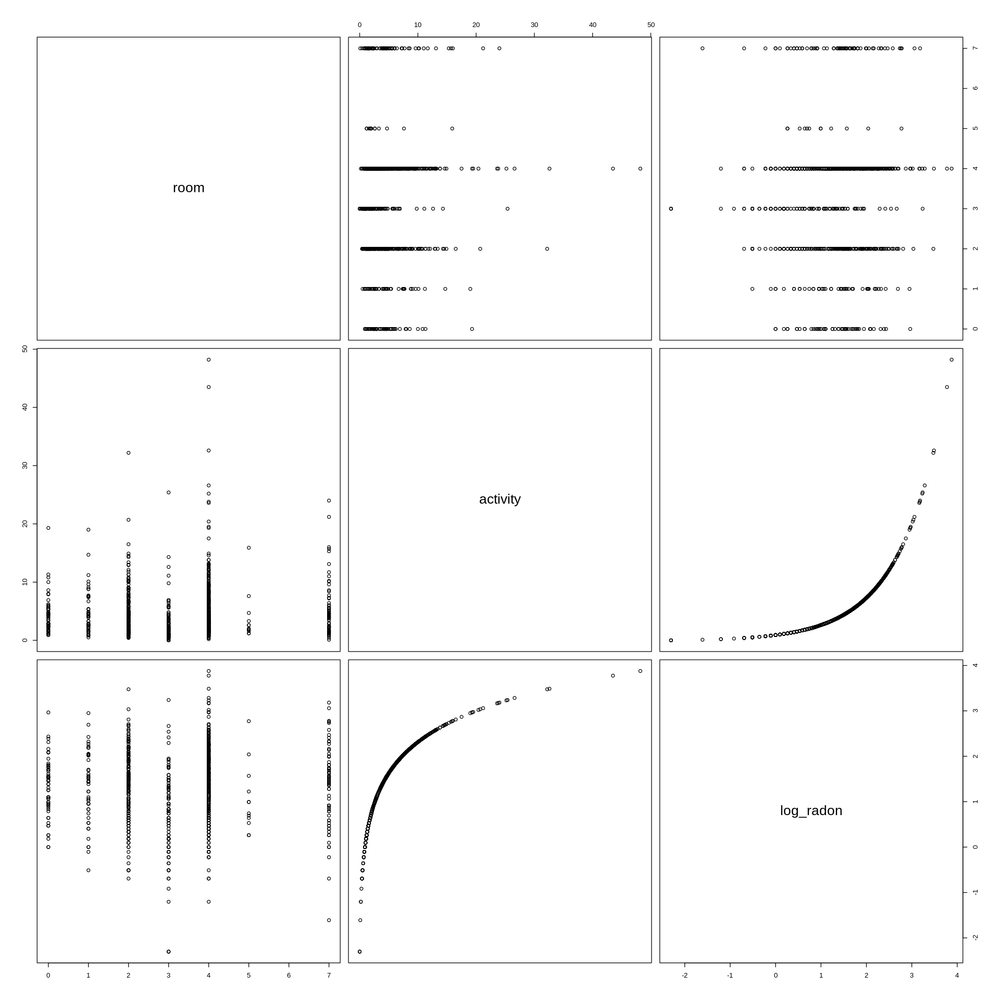

In [ ]:
options(repr.plot.width = 16, repr.plot.height = 16)
pairs(radon[,c('room', 'activity', 'log_radon')])

In [ ]:
summary(radon)

     idnum         state              state2              stfips  
 Min.   :5081   Length:919         Length:919         Min.   :27  
 1st Qu.:5310   Class :character   Class :character   1st Qu.:27  
 Median :5540   Mode  :character   Mode  :character   Median :27  
 Mean   :5540                                         Mean   :27  
 3rd Qu.:5770                                         3rd Qu.:27  
 Max.   :5999                                         Max.   :27  
      zip            region        typebldg        floor          
 Min.   :55007   Min.   :1.00   Min.   :0.000   Length:919        
 1st Qu.:55318   1st Qu.:2.00   1st Qu.:1.000   Class :character  
 Median :55746   Median :3.00   Median :1.000   Mode  :character  
 Mean   :55730   Mean   :3.12   Mean   :1.039                     
 3rd Qu.:56120   3rd Qu.:4.00   3rd Qu.:1.000                     
 Max.   :57006   Max.   :5.00   Max.   :5.000                     
      room         basement         windoor             rep   

---

## **Complete pooling** without predictors

In [ ]:
pooled_model <- stan_glm(
  formula = log_radon ~ 1,
  data = radon,
  refresh=0
)

pooled_model

stan_glm
 family:       gaussian [identity]
 formula:      log_radon ~ 1
 observations: 919
 predictors:   1
------
            Median MAD_SD
(Intercept) 1.3    0.0   

Auxiliary parameter(s):
      Median MAD_SD
sigma 0.8    0.0   

------
* For help interpreting the printed output see ?print.stanreg
* For info on the priors used see ?prior_summary.stanreg

## Plot prior parameter distributions

[Prior Choice Recommendations](https://github.com/stan-dev/stan/wiki/Prior-Choice-Recommendations)

1. Flat prior (not usually recommended).

2. Super-vague but proper prior: normal(0, 1e6) (not usually recommended).

3. Weakly informative prior, very weak: normal(0, 10).

4. Generic weakly informative prior: normal(0, 1).

5. Specific informative prior: normal(0.4, 0.2) or whatever. Sometimes this can be expressed as a scaling followed by a generic prior: theta = 0.4 + 0.2*z ; z ~ normal(0, 1).

The above numbers assume that parameters are roughly on unit scale, as is done in education (where 0 is average test score in some standard population (e.g., all students at a certain grade level) and 1 is sd of test scores in that population) or medicine (where 0 is zero dose and 1 is a standard dose such as 10mcg/day of cyanocobalamin, 1,000 IU/day cholecalciferol, etc.; these examples come from Sander Greenland).

In addition, statements such as "informative" or "weakly informative" depend crucially on what questions are being asked (a point that is related to the idea that [the prior can often only be understood in the context of the likelihood](http://www.stat.columbia.edu/~gelman/research/published/entropy-19-00555-v2.pdf)).

[Default (Weakly Informative) Prior Distributions](https://mc-stan.org/rstanarm/articles/priors.html)

With very few exceptions, the default priors in [`rstanarm`](https://mc-stan.org/rstanarm/articles/priors.html) —the priors used if they aren't specified— are not flat priors. Rather, the defaults are intended to be weakly informative. That is, they are designed to provide moderate regularization and help stabilize computation. For many (if not most) applications the defaults will perform well, but this is not guaranteed (there are no default priors that make sense for every possible model specification).

[Prior predictive checks](https://www.pymc.io/projects/docs/en/stable/learn/core_notebooks/posterior_predictive.html) are also a crucial part of the Bayesian modeling workflow. Basically, they have two main benefits:

* They allow you to check whether you are indeed incorporating scientific knowledge into your model - in short, they help you check how credible your assumptions before seeing the data are.

* They can help sampling considerably, especially for generalized linear models, where the outcome space and the parameter space diverge because of the link function.

[`prior_summary`](https://mc-stan.org/rstanarm/reference/prior_summary.stanreg.html): Summarize the priors used for an [`rstanarm`](https://mc-stan.org/rstanarm/articles/priors.html) model.

In [ ]:
prior_summary(pooled_model)

Priors for model 'pooled_model' 
------
Intercept (after predictors centered)
  Specified prior:
    ~ normal(location = 1.3, scale = 2.5)
  Adjusted prior:
    ~ normal(location = 1.3, scale = 2)

Auxiliary (sigma)
  Specified prior:
    ~ exponential(rate = 1)
  Adjusted prior:
    ~ exponential(rate = 1.2)
------
See help('prior_summary.stanreg') for more details

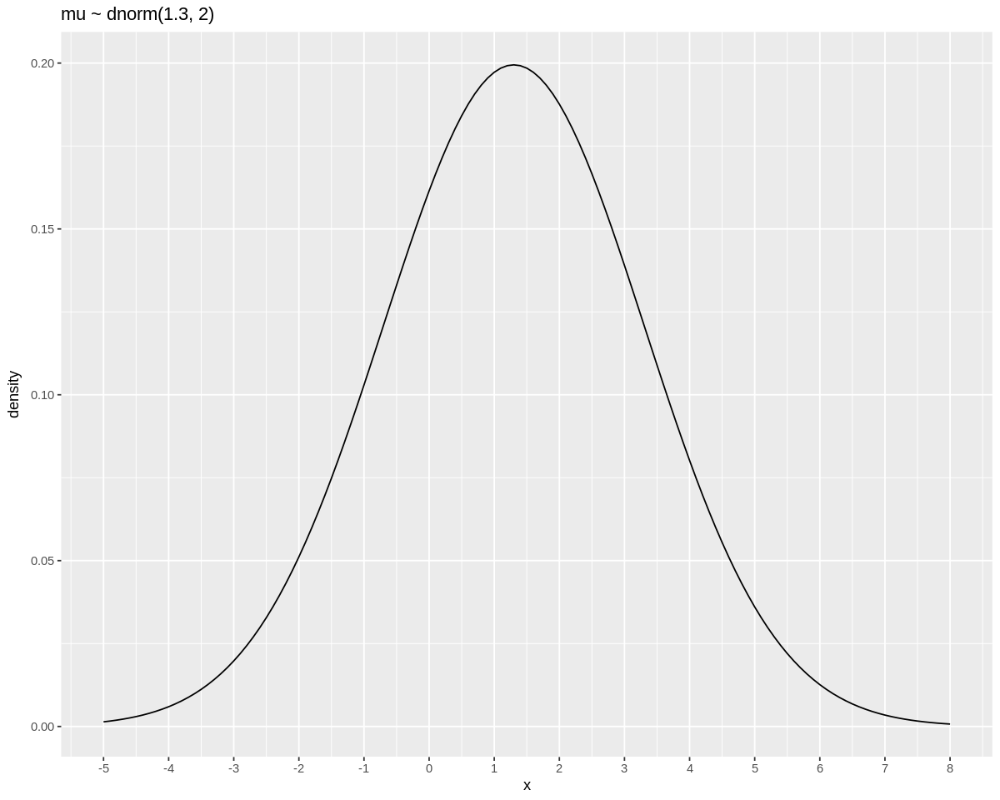

In [ ]:
options(repr.plot.width = 10, repr.plot.height = 8)
p1 <-
  tibble(x = seq(from = -5, to = 8, by = .1)) %>%

  ggplot(aes(x = x, y = dnorm(x, mean = 1.3, sd = 2))) +
  geom_line() +
  scale_x_continuous(breaks = seq(from = -5, to = 8, by = 1)) +
  labs(title = "mu ~ dnorm(1.3, 2)",
       y = "density")

p1

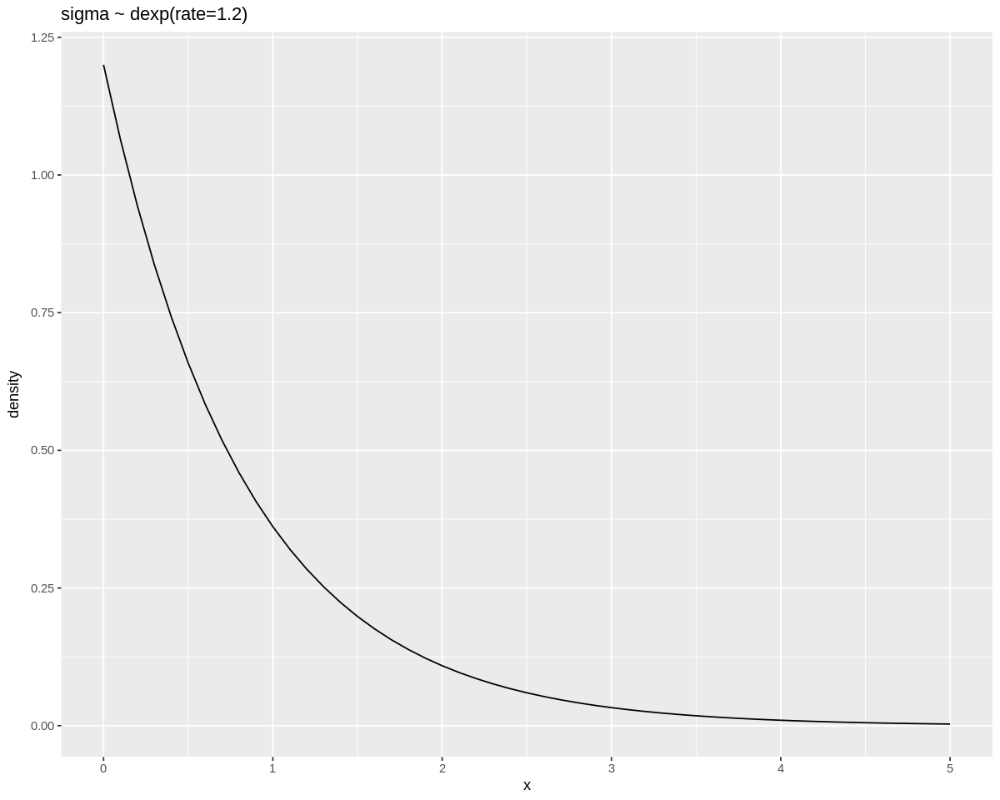

In [ ]:
options(repr.plot.width = 10, repr.plot.height = 8)
p2 <-
  tibble(x = seq(from = 0, to = 5, by = .1)) %>%

  ggplot(aes(x = x, y = dexp(x, rate = 1.2))) +
  geom_line() +
  scale_x_continuous(breaks = seq(from = 0, to = 5, by = 1)) +
  labs(title = "sigma ~ dexp(rate=1.2)",
       y = "density")

p2

## Fit model

[Fit](https://mc-stan.org/rstanarm/reference/stan_glm.html) the model using Stan.

`formula`, `data`, `subset`: Same as [glm](https://rdrr.io/r/stats/glm.html), but *we strongly advise against omitting the `data` argument*. Unless data is specified (and is a data frame) many post-estimation functions (including `update`, `loo`, `kfold`) are not guaranteed to work properly.

`iter`: The number of samples to draw from the posterior distribution. By default, all `rstanarm` modeling functions will run **four** randomly initialized Markov chains, each for `2000` iterations (including a warmup period of `1000` iterations that is discarded).

`chains`: The number of chains to sample. Running independent chains is important for some convergence statistics and can also reveal multiple modes in the posterior. By default, all `rstanarm` modeling functions will run **four** randomly initialized Markov chains, each for `2000` iterations (including a warmup period of `1000` iterations that is discarded).

`algorithm`: A string (possibly abbreviated) indicating the estimation approach to use. Can be `"sampling"` for MCMC (the **default**), `"optimizing"` for optimization, `"meanfield"` for variational inference with independent normal distributions, or `"fullrank"` for variational inference with a multivariate normal distribution. See [rstanarm-package](https://mc-stan.org/rstanarm/reference/rstanarm-package.html) for more details on the estimation algorithms.

[Markov Chain Monte Carlo (MCMC)](https://bookdown.org/content/4857/markov-chain-monte-carlo.html): This chapter introduces one commonplace example of [Fortuna](https://en.wikipedia.org/wiki/Rota_Fortunae#/media/File:Lydgate-siege-troy-wheel-fortune-detail.jpg) and [Minerva](https://en.wikipedia.org/wiki/Minerva#/media/File:Minerva-Vedder-Highsmith-detail-1.jpeg)'s cooperation: the estimation of posterior probability distributions using a stochastic process known as **Markov chain Monte Carlo (MCMC)** ([McElreath, 2020a, p. 263](https://bookdown.org/content/4857/markov-chain-monte-carlo.html#ref-mcelreathStatisticalRethinkingBayesian2020), **emphasis** in the original).

In [ ]:
pooled_model <- stan_glm(formula = log_radon ~ 1, data = radon, refresh=0)

pooled_model

stan_glm
 family:       gaussian [identity]
 formula:      log_radon ~ 1
 observations: 919
 predictors:   1
------
            Median MAD_SD
(Intercept) 1.3    0.0   

Auxiliary parameter(s):
      Median MAD_SD
sigma 0.8    0.0   

------
* For help interpreting the printed output see ?print.stanreg
* For info on the priors used see ?prior_summary.stanreg

In [ ]:
summary(pooled_model)


Model Info:
 function:     stan_glm
 family:       gaussian [identity]
 formula:      log_radon ~ 1
 algorithm:    sampling
 sample:       4000 (posterior sample size)
 priors:       see help('prior_summary')
 observations: 919
 predictors:   1

Estimates:
              mean   sd   10%   50%   90%
(Intercept) 1.3    0.0  1.2   1.3   1.3  
sigma       0.8    0.0  0.8   0.8   0.8  

Fit Diagnostics:
           mean   sd   10%   50%   90%
mean_PPD 1.3    0.0  1.2   1.3   1.3  

The mean_ppd is the sample average posterior predictive distribution of the outcome variable (for details see help('summary.stanreg')).

MCMC diagnostics
              mcse Rhat n_eff
(Intercept)   0.0  1.0  2701 
sigma         0.0  1.0  3055 
mean_PPD      0.0  1.0  3103 
log-posterior 0.0  1.0  1726 

For each parameter, mcse is Monte Carlo standard error, n_eff is a crude measure of effective sample size, and Rhat is the potential scale reduction factor on split chains (at convergence Rhat=1).

[Fitted model objects](https://mc-stan.org/rstanarm/reference/stanreg-objects.html)

The `rstanarm` model-fitting functions return an object of class `'stanreg'`, which is a list containing at a minimum the components listed below. Each stanreg object will also have additional classes (e.g. `'aov'`, `'betareg'`, `'glm'`, `'polr'`, etc.) and several additional components depending on the model and estimation algorithm.

[`summary`](https://mc-stan.org/rstanarm/reference/summary.stanreg.html): Summary method for stanreg objects. Summaries of parameter estimates and MCMC convergence diagnostics (Monte Carlo error, effective sample size, Rhat).

[Reference](https://mc-stan.org/rstanarm/reference/index.html)

* About `rstanarm`

* Fitting models

* Methods

* Additional documentation

## Plot MCMC diagnostics

[`mcmc_neff`](https://mc-stan.org/bayesplot/reference/MCMC-diagnostics.html): Ratios of effective sample size to total sample size as either points or a histogram. Values are colored using different shades (lighter is better). The chosen thresholds are somewhat arbitrary, but can be useful guidelines in practice.

[`mcmc_rhat`](https://mc-stan.org/bayesplot/reference/MCMC-diagnostics.html): [`R-hat`](https://mc-stan.org/bayesplot/articles/visual-mcmc-diagnostics.html#rhat-potential-scale-reduction-statistic) values as either points or a histogram. Values are colored using different shades (lighter is better). The chosen thresholds are somewhat arbitrary, but can be useful guidelines in practice.

[`mcmc_dens_overlay`](https://mc-stan.org/bayesplot/reference/MCMC-diagnostics.html): Various [types](https://mc-stan.org/bayesplot/reference/MCMC-distributions.html) of histograms and kernel density plots of MCMC draws.

[`mcmc_trace`](https://python.arviz.org/en/stable/examples/plot_trace.html): Trace and rank [plots](https://mc-stan.org/bayesplot/reference/MCMC-traces.html) of MCMC draws.

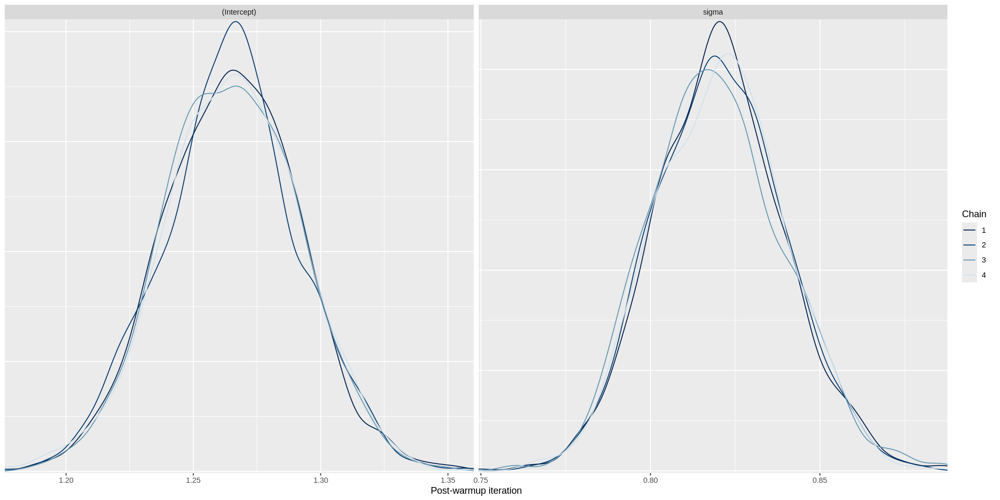

In [ ]:
options(repr.plot.width = 16, repr.plot.height = 8)
mcmc_dens_overlay(pooled_model) +
  xlab("Post-warmup iteration")

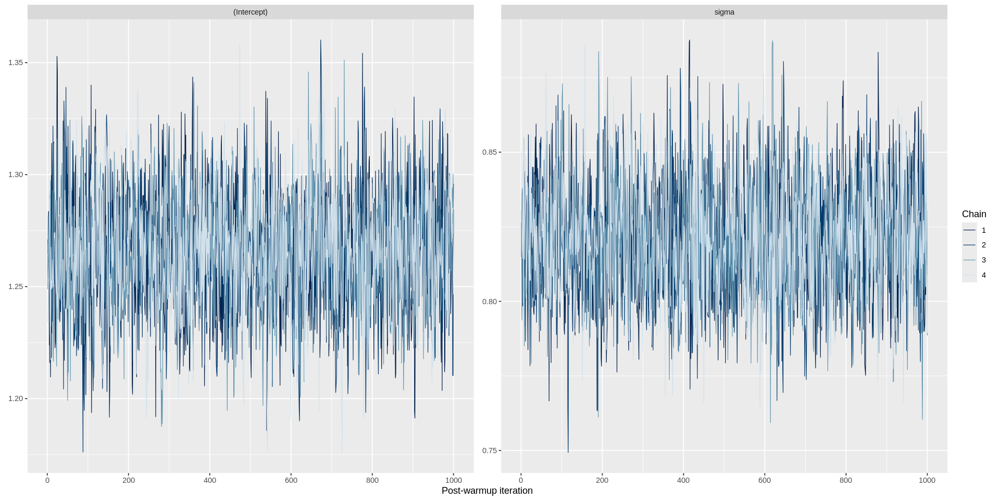

In [ ]:
options(repr.plot.width = 16, repr.plot.height = 8)
mcmc_trace(pooled_model) +
  xlab("Post-warmup iteration")

## Plot posterior distributions

The [posterior probability](https://en.wikipedia.org/wiki/Posterior_probability) is a type of [conditional probability](https://en.wikipedia.org/wiki/Conditional_probability) that results from [updating](https://en.wikipedia.org/wiki/Bayesian_updating) the [prior probability](https://en.wikipedia.org/wiki/Prior_probability) with information summarized by the [likelihood](https://en.wikipedia.org/wiki/Likelihood_function) via an application of [Bayes' rule](https://en.wikipedia.org/wiki/Bayes%27_rule).

Chapter 7 [The Posterior - The Goal of Bayesian
Inference](https://sites.math.rutgers.edu/~zeilberg/EM20/Lambert.pdf) in "A Student's Guide to Bayesian Statistics" by Ben Lambert

[`as.array` `as.matrix` `as.data.frame`](https://mc-stan.org/rstanarm/reference/as.matrix.stanreg.html): Extract the posterior sample. For models fit using MCMC (`algorithm="sampling"`), the posterior sample -the post-warmup draws from the posterior distribution- can be extracted from a fitted model object as a matrix, data frame, or array. The `as.matrix` and `as.data.frame` methods merge all chains together, whereas the `as.array` method keeps the chains separate.

[`pp_check`](https://mc-stan.org/bayesplot/reference/pp_check.html): Posterior (or prior) predictive checks (S3 generic and default method).

In [ ]:
post_pooled_model <- as.array(pooled_model)
dim(post_pooled_model)

[1] 1000    4    2

In [ ]:
dimnames(post_pooled_model)

$iterations
NULL

$chains
[1] "chain:1" "chain:2" "chain:3" "chain:4"

$parameters
[1] "(Intercept)" "sigma"

In [ ]:
post_pooled_model <- as.matrix(pooled_model)
dim(post_pooled_model)

[1] 4000    2

In [ ]:
dimnames(post_pooled_model)

$iterations
NULL

$parameters
[1] "(Intercept)" "sigma"

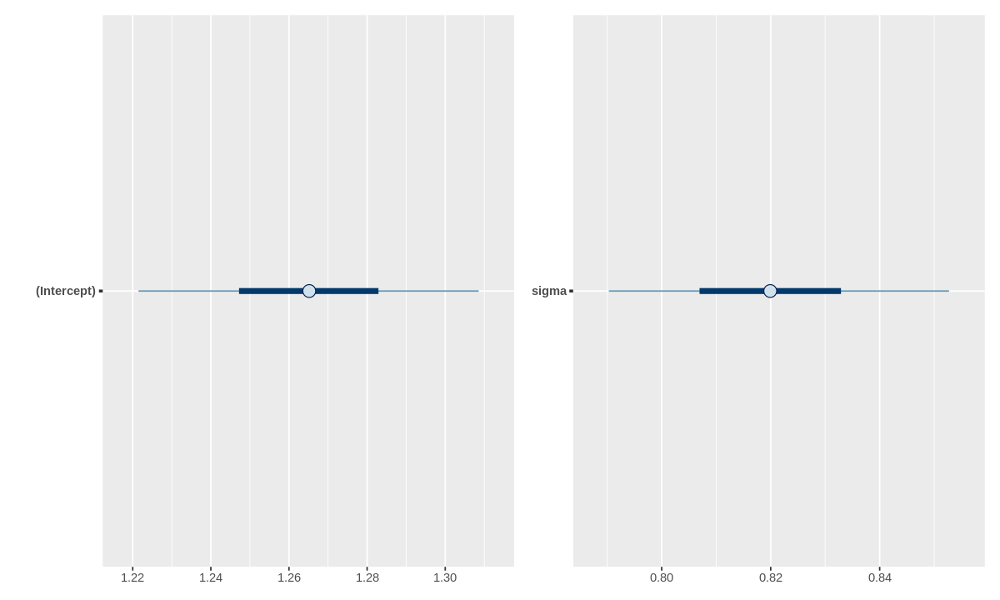

In [ ]:
options(repr.plot.width = 10, repr.plot.height = 6)
g1 <- mcmc_intervals(post_pooled_model, pars = c("(Intercept)"))
g2 <- mcmc_intervals(post_pooled_model, pars = c("sigma"))
g1 + g2

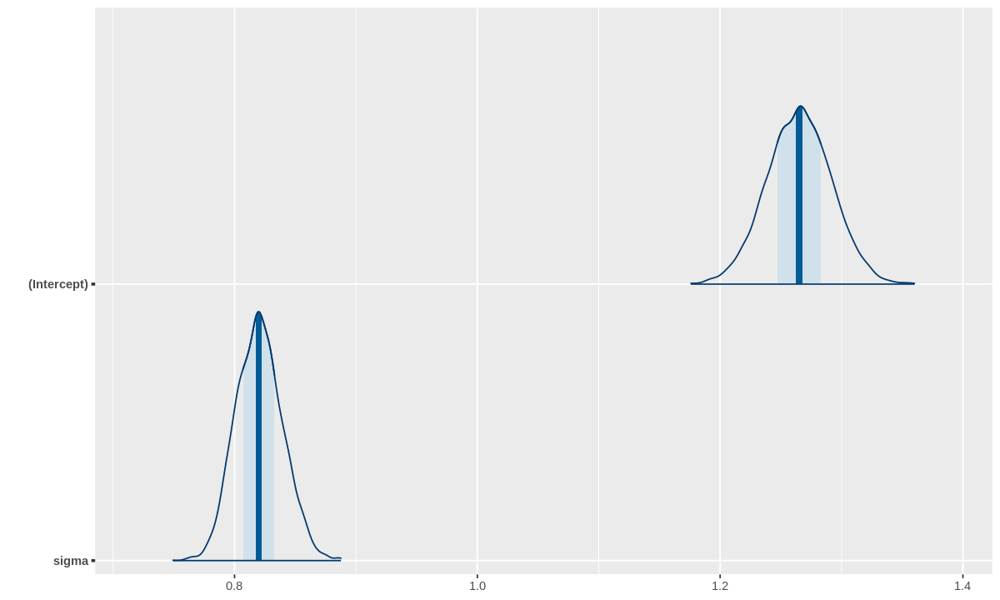

In [ ]:
options(repr.plot.width = 10, repr.plot.height = 6)
mcmc_areas(post_pooled_model)

`stat_bin()` using `bins = 30`. Pick better value `binwidth`.


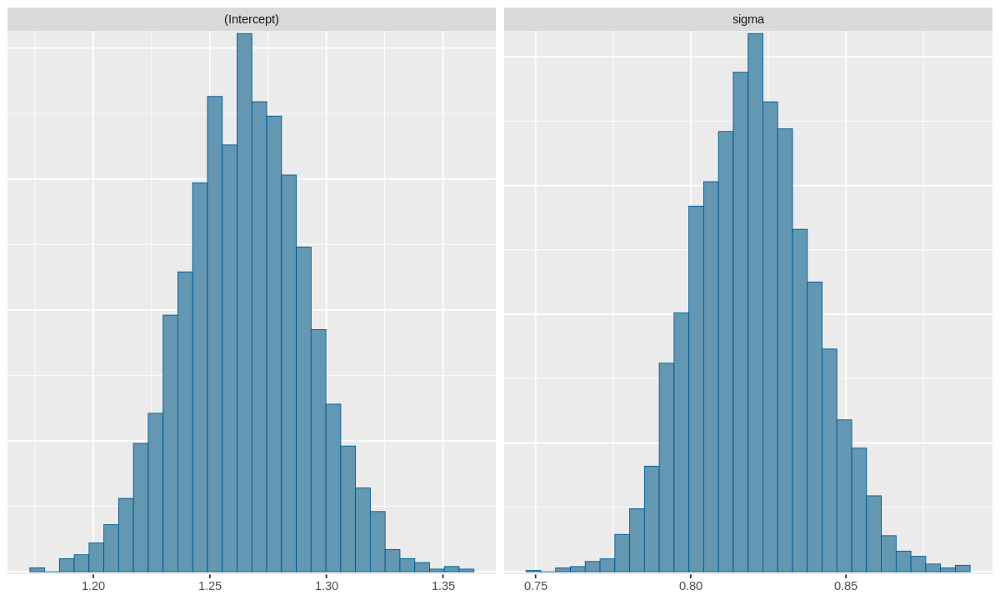

In [ ]:
options(repr.plot.width = 10, repr.plot.height = 6)
mcmc_hist(post_pooled_model)

Note: in most cases the default test statistic 'mean' is too weak to detect anything of interest.



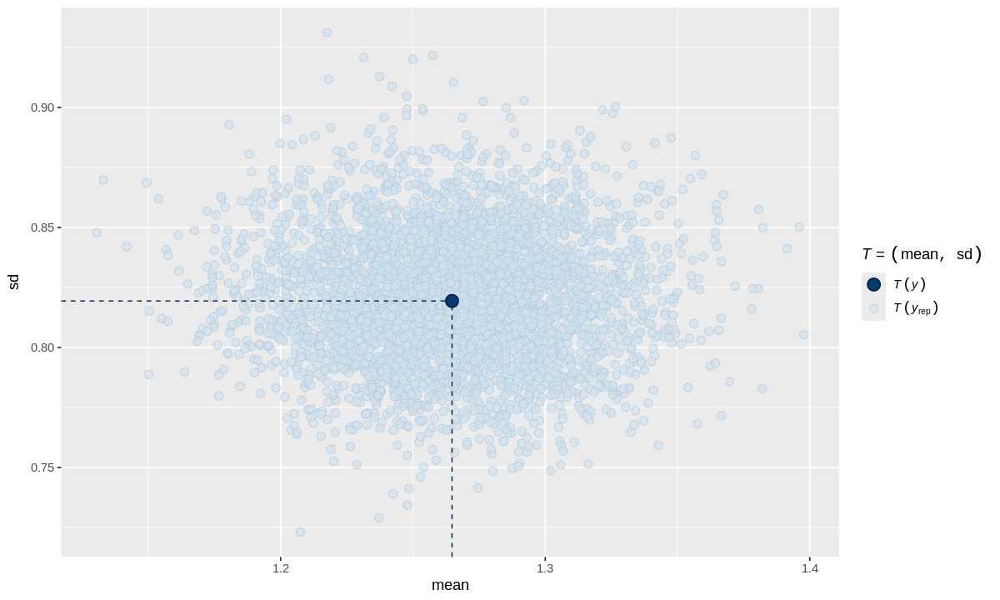

In [ ]:
pp_check(pooled_model, plotfun = "stat_2d", stat = c("mean", "sd"))

In [ ]:
print(pooled_model)

stan_glm
 family:       gaussian [identity]
 formula:      log_radon ~ 1
 observations: 919
 predictors:   1
------
            Median MAD_SD
(Intercept) 1.3    0.0   

Auxiliary parameter(s):
      Median MAD_SD
sigma 0.8    0.0   

------
* For help interpreting the printed output see ?print.stanreg
* For info on the priors used see ?prior_summary.stanreg


## Plot posterior predictive distributions

[Posterior predictive checks (PPCs)](https://www.pymc.io/projects/docs/en/stable/learn/core_notebooks/posterior_predictive.html) are a great way to validate a model. The idea is to generate data from the model using parameters from draws from the posterior.

Elaborating slightly, one can say that PPCs analyze the degree to which data generated from the model deviate from data generated from the true distribution. So, often you will want to know if, for example, your posterior distribution is approximating your underlying distribution. The visualization aspect of this model evaluation method is also great for a 'sense check' or explaining your model to others and getting criticism.

[Graphical posterior predictive checks (PPCs)](https://mc-stan.org/bayesplot/articles/graphical-ppcs.html)

The `bayesplot` package provides various plotting functions for graphical posterior predictive checking, that is, creating graphical displays comparing observed data to simulated data from the posterior predictive distribution ([Gabry et al, 2019](https://mc-stan.org/bayesplot/articles/graphical-ppcs.html#gabry2019)).

The idea behind [posterior predictive checking](https://mc-stan.org/docs/stan-users-guide/posterior-prediction.html) is simple: if a model is a good fit then we should be able to use it to generate data that looks a lot like the data we observed. To generate the data used for posterior predictive checks (PPCs) we simulate from the posterior predictive distribution. This is the distribution of the outcome variable implied by a model after using the observed data 𝑦 (a vector of 𝑁 outcome values) to update our beliefs about unknown model parameters 𝜃.

[`posterior_predict`](https://mc-stan.org/rstanarm/reference/posterior_predict.stanreg.html): The posterior predictive distribution is the distribution of the outcome implied by the model after using the observed data to update our beliefs about the unknown parameters in the model. Simulating data from the posterior predictive distribution using the observed predictors is useful for checking the fit of the model. Drawing from the posterior predictive distribution at interesting values of the predictors also lets us visualize how a manipulation of a predictor affects (a function of) the outcome(s). With new observations of predictor variables we can use the posterior predictive distribution to generate predicted outcomes.

[`ppc_dens_overlay`](https://mc-stan.org/bayesplot/reference/PPD-distributions.html): Plot posterior or prior predictive distributions. Each of these functions makes the same plot as the corresponding `ppc_` function but without plotting any observed data `y`.

Note: in most cases the default test statistic 'mean' is too weak to detect anything of interest.

`stat_bin()` using `bins = 30`. Pick better value `binwidth`.


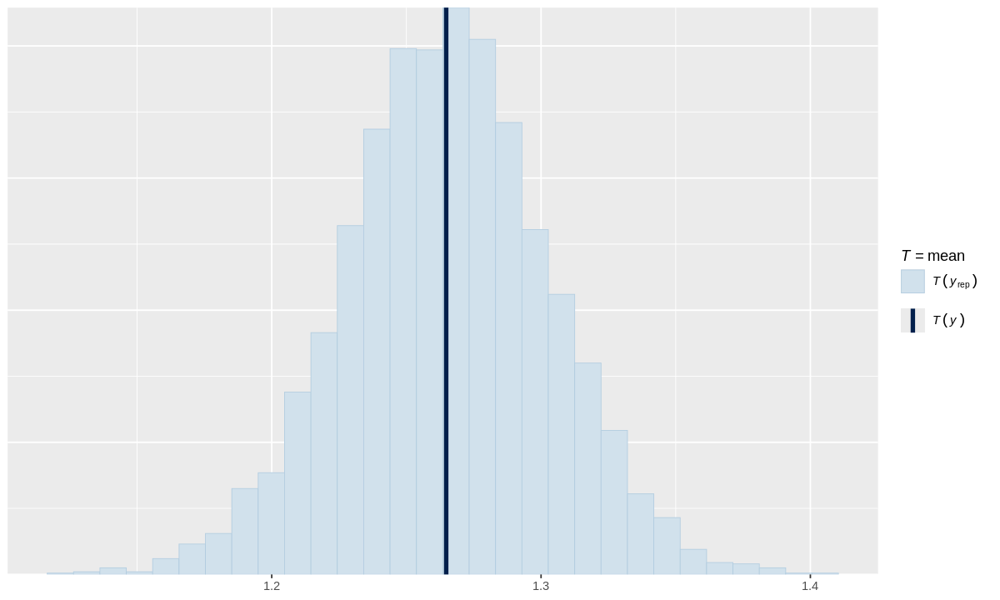

In [ ]:
pp_check(pooled_model, plotfun = "stat", stat = "mean")

`stat_bin()` using `bins = 30`. Pick better value `binwidth`.


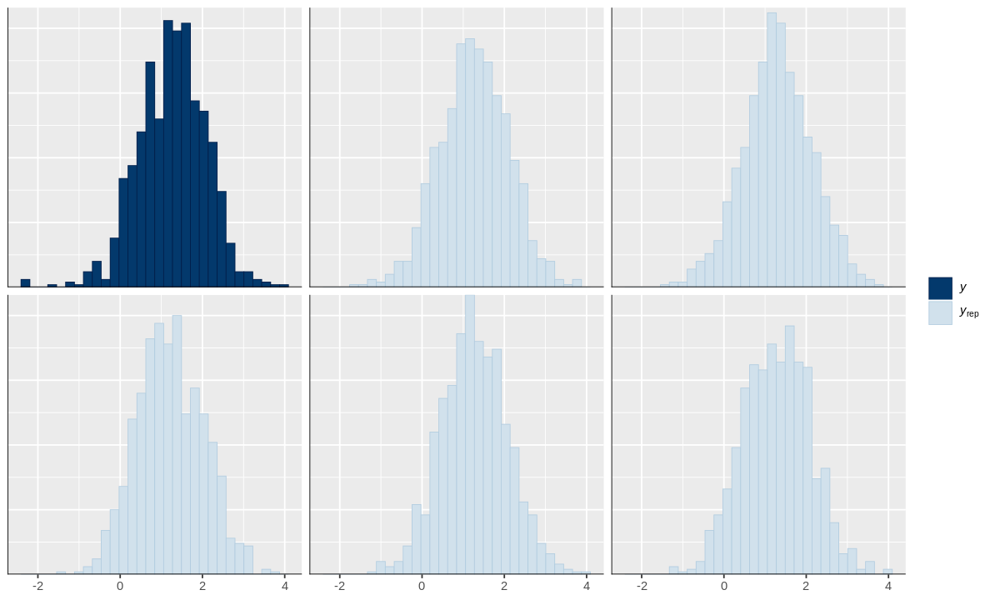

In [ ]:
pp_check(pooled_model, plotfun = "hist", nreps = 5)

In [ ]:
y <- radon$log_radon

In [ ]:
yrep_pooled <- posterior_predict(pooled_model, draws = 500)
dim(yrep_pooled)

[1] 500 919

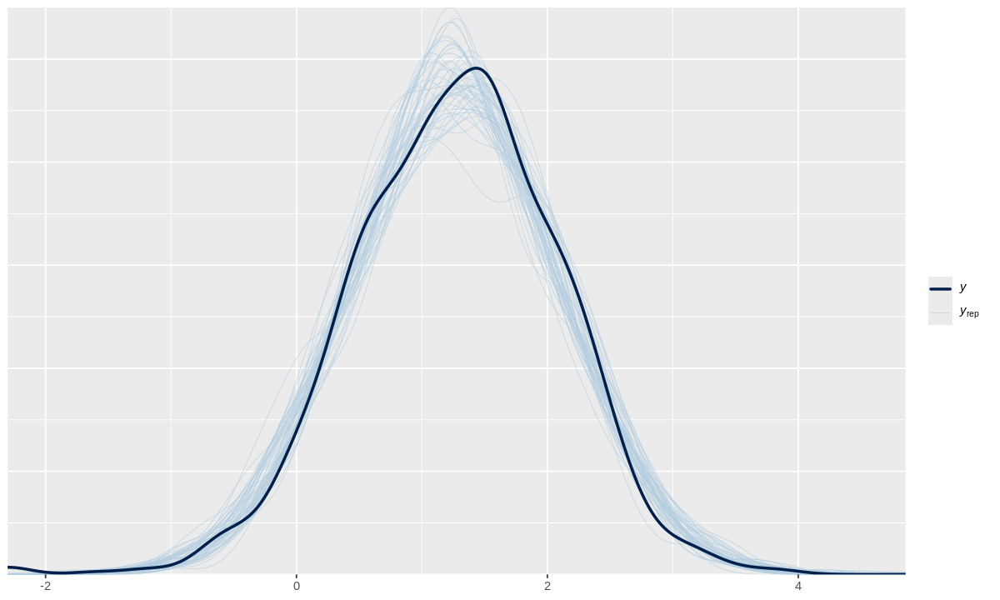

In [ ]:
ppc_dens_overlay(y, yrep_pooled[1:50, ])

[loo](https://mc-stan.org/loo/index.html): Efficient approximate leave-one-out cross-validation for fitted Bayesian models

From existing posterior simulation draws, we compute approximate `LOO-CV` using Pareto smoothed importance sampling (`PSIS`), a new procedure for regularizing importance weights. As a byproduct of our calculations, we also obtain approximate standard errors for estimated predictive errors and for comparing predictive errors between two models. We recommend `PSIS-LOO-CV` instead of `WAIC`, because `PSIS` provides useful diagnostics and effective sample size and Monte Carlo standard error estimates.

[`loo`](https://mc-stan.org/rstanarm/reference/loo.stanreg.html): For models fit using MCMC, compute approximate leave-one-out cross-validation (`LOO`, `LOOIC`) or, less preferably, the Widely Applicable Information Criterion (`WAIC`) using the loo package. (For 𝐾-fold cross-validation see `kfold.stanreg`.) Functions for model comparison, and model weighting/averaging are also provided.

Estimates the expected log pointwise predictive density (elpd) using Pareto-smoothed importance sampling leave-one-out cross-validation (PSIS-LOO-CV). Also calculates LOO's standard error and the effective number of parameters. Read more theory here https://arxiv.org/abs/1507.04544 and here https://arxiv.org/abs/1507.02646

In [ ]:
loo_pooled = loo(pooled_model)
loo_pooled


Computed from 4000 by 919 log-likelihood matrix.

         Estimate   SE
elpd_loo  -1122.5 26.0
p_loo         2.3  0.4
looic      2245.1 51.9
------
MCSE of elpd_loo is 0.0.
MCSE and ESS estimates assume independent draws (r_eff=1).

All Pareto k estimates are good (k < 0.7).
See help('pareto-k-diagnostic') for details.

[LOO package glossary](https://mc-stan.org/loo/reference/loo-glossary.html)

`elpd`: approximated expected log pointwise predictive density (elpd).

`se`: standard error of the elpd.

`p_loo`: effective number of parameters. If we have a well-specified model, we expect the estimated effective number of parameters (`p_loo`) to be smaller than or similar to the total number of parameters in the model.

Pareto 𝑘 diagnostic values are used to assess the reliability of the estimates. In addition to the proportion of leave-one-out folds with 𝑘 values in different intervals, the minimum of the effective sample sizes in that category is shown to give idea why higher 𝑘 values are bad.

---

## **No pooling** without predictors

In [ ]:
unpooled_model <- stan_glm(
  formula = log_radon ~ 0 + county,
  data = radon,
  refresh=0
)

unpooled_model

stan_glm
 family:       gaussian [identity]
 formula:      log_radon ~ 0 + county
 observations: 919
 predictors:   85
------
                        Median MAD_SD
countyAITKIN            0.7    0.4   
countyANOKA             0.9    0.1   
countyBECKER            1.1    0.4   
countyBELTRAMI          1.2    0.3   
countyBENTON            1.3    0.4   
countyBIG STONE         1.5    0.4   
countyBLUE EARTH        1.9    0.2   
countyBROWN             1.7    0.4   
countyCARLTON           1.0    0.2   
countyCARVER            1.2    0.3   
countyCASS              1.4    0.4   
countyCHIPPEWA          1.8    0.4   
countyCHISAGO           1.1    0.3   
countyCLAY              1.8    0.2   
countyCLEARWATER        1.0    0.4   
countyCOOK              0.7    0.5   
countyCOTTONWOOD        0.8    0.4   
countyCROW WING         1.0    0.2   
countyDAKOTA            1.3    0.1   
countyDODGE             1.8    0.4   
countyDOUGLAS           1.7    0.2   
countyFARIBAULT         0.7    0.3   


## Plot prior parameter distributions

[Prior Choice Recommendations](https://github.com/stan-dev/stan/wiki/Prior-Choice-Recommendations)

1. Flat prior (not usually recommended).

2. Super-vague but proper prior: normal(0, 1e6) (not usually recommended).

3. Weakly informative prior, very weak: normal(0, 10).

4. Generic weakly informative prior: normal(0, 1).

5. Specific informative prior: normal(0.4, 0.2) or whatever. Sometimes this can be expressed as a scaling followed by a generic prior: theta = 0.4 + 0.2*z ; z ~ normal(0, 1).

The above numbers assume that parameters are roughly on unit scale, as is done in education (where 0 is average test score in some standard population (e.g., all students at a certain grade level) and 1 is sd of test scores in that population) or medicine (where 0 is zero dose and 1 is a standard dose such as 10mcg/day of cyanocobalamin, 1,000 IU/day cholecalciferol, etc.; these examples come from Sander Greenland).

In addition, statements such as "informative" or "weakly informative" depend crucially on what questions are being asked (a point that is related to the idea that [the prior can often only be understood in the context of the likelihood](http://www.stat.columbia.edu/~gelman/research/published/entropy-19-00555-v2.pdf)).

[Default (Weakly Informative) Prior Distributions](https://mc-stan.org/rstanarm/articles/priors.html)

With very few exceptions, the default priors in [`rstanarm`](https://mc-stan.org/rstanarm/articles/priors.html) —the priors used if they aren't specified— are not flat priors. Rather, the defaults are intended to be weakly informative. That is, they are designed to provide moderate regularization and help stabilize computation. For many (if not most) applications the defaults will perform well, but this is not guaranteed (there are no default priors that make sense for every possible model specification).

[Prior predictive checks](https://www.pymc.io/projects/docs/en/stable/learn/core_notebooks/posterior_predictive.html) are also a crucial part of the Bayesian modeling workflow. Basically, they have two main benefits:

* They allow you to check whether you are indeed incorporating scientific knowledge into your model - in short, they help you check how credible your assumptions before seeing the data are.

* They can help sampling considerably, especially for generalized linear models, where the outcome space and the parameter space diverge because of the link function.

[`prior_summary`](https://mc-stan.org/rstanarm/reference/prior_summary.stanreg.html): Summarize the priors used for an [`rstanarm`](https://mc-stan.org/rstanarm/articles/priors.html) model.

In [ ]:
prior_summary(unpooled_model)

Priors for model 'unpooled_model' 
------

Coefficients
  Specified prior:
    ~ normal(location = [0,0,0,...], scale = [2.5,2.5,2.5,...])
  Adjusted prior:
    ~ normal(location = [0,0,0,...], scale = [31.10, 8.86,35.89,...])

Auxiliary (sigma)
  Specified prior:
    ~ exponential(rate = 1)
  Adjusted prior:
    ~ exponential(rate = 1.2)
------
See help('prior_summary.stanreg') for more details

## Fit model

[Fit](https://mc-stan.org/rstanarm/reference/stan_glm.html) the model using Stan.

`formula`, `data`, `subset`: Same as [glm](https://rdrr.io/r/stats/glm.html), but *we strongly advise against omitting the `data` argument*. Unless data is specified (and is a data frame) many post-estimation functions (including `update`, `loo`, `kfold`) are not guaranteed to work properly.

`iter`: The number of samples to draw from the posterior distribution. By default, all `rstanarm` modeling functions will run **four** randomly initialized Markov chains, each for `2000` iterations (including a warmup period of `1000` iterations that is discarded).

`chains`: The number of chains to sample. Running independent chains is important for some convergence statistics and can also reveal multiple modes in the posterior. By default, all `rstanarm` modeling functions will run **four** randomly initialized Markov chains, each for `2000` iterations (including a warmup period of `1000` iterations that is discarded).

`algorithm`: A string (possibly abbreviated) indicating the estimation approach to use. Can be `"sampling"` for MCMC (the **default**), `"optimizing"` for optimization, `"meanfield"` for variational inference with independent normal distributions, or `"fullrank"` for variational inference with a multivariate normal distribution. See [rstanarm-package](https://mc-stan.org/rstanarm/reference/rstanarm-package.html) for more details on the estimation algorithms.

[Markov Chain Monte Carlo (MCMC)](https://bookdown.org/content/4857/markov-chain-monte-carlo.html): This chapter introduces one commonplace example of [Fortuna](https://en.wikipedia.org/wiki/Rota_Fortunae#/media/File:Lydgate-siege-troy-wheel-fortune-detail.jpg) and [Minerva](https://en.wikipedia.org/wiki/Minerva#/media/File:Minerva-Vedder-Highsmith-detail-1.jpeg)'s cooperation: the estimation of posterior probability distributions using a stochastic process known as **Markov chain Monte Carlo (MCMC)** ([McElreath, 2020a, p. 263](https://bookdown.org/content/4857/markov-chain-monte-carlo.html#ref-mcelreathStatisticalRethinkingBayesian2020), **emphasis** in the original).

In [ ]:
unpooled_model <- stan_glm(
  formula = log_radon ~ 0 + county,
  data = radon,
  refresh=0
)

unpooled_model

stan_glm
 family:       gaussian [identity]
 formula:      log_radon ~ 0 + county
 observations: 919
 predictors:   85
------
                        Median MAD_SD
countyAITKIN            0.7    0.4   
countyANOKA             0.9    0.1   
countyBECKER            1.1    0.4   
countyBELTRAMI          1.2    0.3   
countyBENTON            1.3    0.4   
countyBIG STONE         1.5    0.5   
countyBLUE EARTH        1.9    0.2   
countyBROWN             1.7    0.4   
countyCARLTON           1.0    0.2   
countyCARVER            1.2    0.3   
countyCASS              1.4    0.3   
countyCHIPPEWA          1.7    0.4   
countyCHISAGO           1.1    0.3   
countyCLAY              1.8    0.2   
countyCLEARWATER        1.0    0.4   
countyCOOK              0.7    0.5   
countyCOTTONWOOD        0.7    0.4   
countyCROW WING         1.0    0.2   
countyDAKOTA            1.3    0.1   
countyDODGE             1.8    0.4   
countyDOUGLAS           1.7    0.3   
countyFARIBAULT         0.7    0.3   


In [ ]:
summary(unpooled_model)


Model Info:
 function:     stan_glm
 family:       gaussian [identity]
 formula:      log_radon ~ 0 + county
 algorithm:    sampling
 sample:       4000 (posterior sample size)
 priors:       see help('prior_summary')
 observations: 919
 predictors:   85

Estimates:
                          mean   sd   10%   50%   90%
countyAITKIN             0.7    0.4  0.2   0.7   1.2 
countyANOKA              0.9    0.1  0.8   0.9   1.0 
countyBECKER             1.1    0.5  0.5   1.1   1.7 
countyBELTRAMI           1.2    0.3  0.8   1.2   1.6 
countyBENTON             1.3    0.4  0.8   1.3   1.8 
countyBIG STONE          1.5    0.4  1.0   1.5   2.1 
countyBLUE EARTH         1.9    0.2  1.6   1.9   2.2 
countyBROWN              1.7    0.4  1.2   1.7   2.2 
countyCARLTON            1.0    0.2  0.7   1.0   1.3 
countyCARVER             1.2    0.3  0.8   1.2   1.6 
countyCASS               1.4    0.4  1.0   1.4   1.9 
countyCHIPPEWA           1.8    0.4  1.2   1.8   2.3 
countyCHISAGO            1.1  

[Fitted model objects](https://mc-stan.org/rstanarm/reference/stanreg-objects.html)

The `rstanarm` model-fitting functions return an object of class `'stanreg'`, which is a list containing at a minimum the components listed below. Each stanreg object will also have additional classes (e.g. `'aov'`, `'betareg'`, `'glm'`, `'polr'`, etc.) and several additional components depending on the model and estimation algorithm.

[`summary`](https://mc-stan.org/rstanarm/reference/summary.stanreg.html): Summary method for stanreg objects. Summaries of parameter estimates and MCMC convergence diagnostics (Monte Carlo error, effective sample size, Rhat).

[Reference](https://mc-stan.org/rstanarm/reference/index.html)

* About `rstanarm`

* Fitting models

* Methods

* Additional documentation

## Plot MCMC diagnostics

[`mcmc_neff`](https://mc-stan.org/bayesplot/reference/MCMC-diagnostics.html): Ratios of effective sample size to total sample size as either points or a histogram. Values are colored using different shades (lighter is better). The chosen thresholds are somewhat arbitrary, but can be useful guidelines in practice.

[`mcmc_rhat`](https://mc-stan.org/bayesplot/reference/MCMC-diagnostics.html): [`R-hat`](https://mc-stan.org/bayesplot/articles/visual-mcmc-diagnostics.html#rhat-potential-scale-reduction-statistic) values as either points or a histogram. Values are colored using different shades (lighter is better). The chosen thresholds are somewhat arbitrary, but can be useful guidelines in practice.

[`mcmc_dens_overlay`](https://mc-stan.org/bayesplot/reference/MCMC-diagnostics.html): Various [types](https://mc-stan.org/bayesplot/reference/MCMC-distributions.html) of histograms and kernel density plots of MCMC draws.

[`mcmc_trace`](https://python.arviz.org/en/stable/examples/plot_trace.html): Trace and rank [plots](https://mc-stan.org/bayesplot/reference/MCMC-traces.html) of MCMC draws.

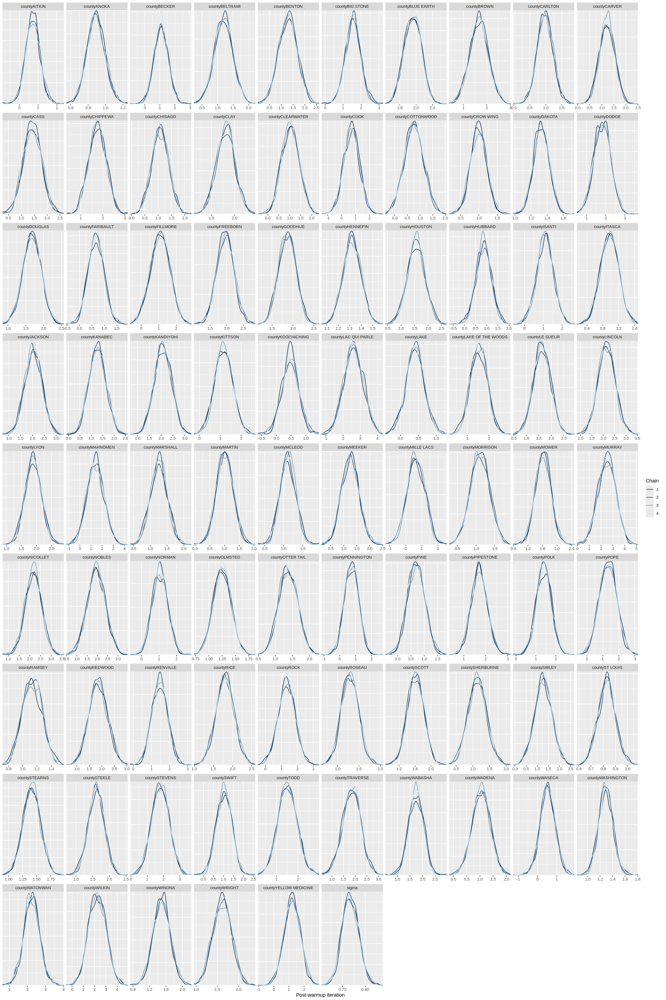

In [ ]:
options(repr.plot.width = 20, repr.plot.height = 30)
mcmc_dens_overlay(unpooled_model) +
  xlab("Post-warmup iteration")

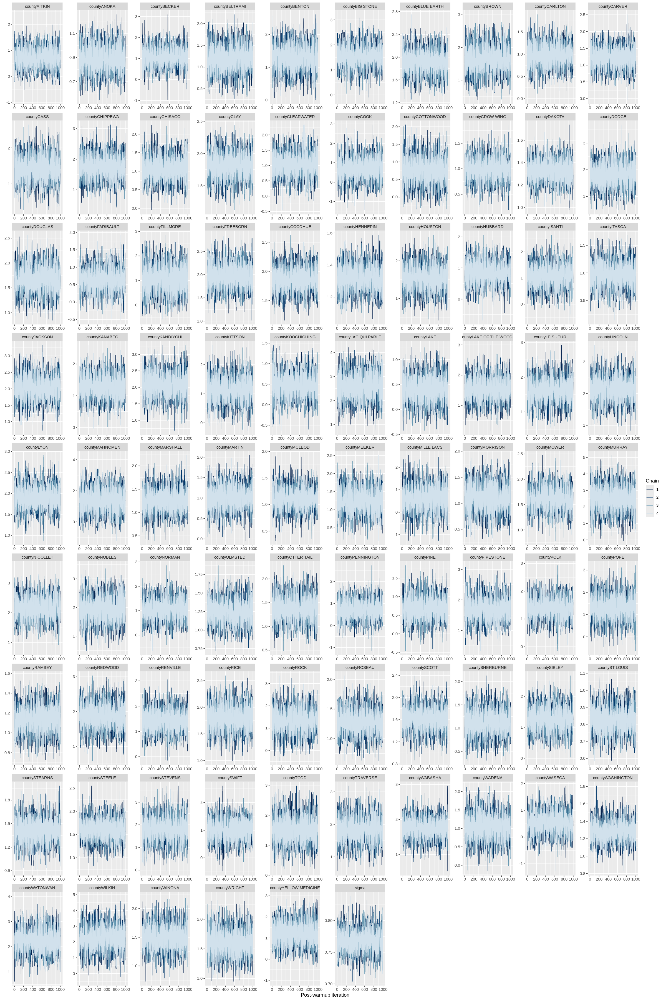

In [ ]:
options(repr.plot.width = 20, repr.plot.height = 30)
mcmc_trace(unpooled_model) +
  xlab("Post-warmup iteration")

## Plot posterior distributions

The [posterior probability](https://en.wikipedia.org/wiki/Posterior_probability) is a type of [conditional probability](https://en.wikipedia.org/wiki/Conditional_probability) that results from [updating](https://en.wikipedia.org/wiki/Bayesian_updating) the [prior probability](https://en.wikipedia.org/wiki/Prior_probability) with information summarized by the [likelihood](https://en.wikipedia.org/wiki/Likelihood_function) via an application of [Bayes' rule](https://en.wikipedia.org/wiki/Bayes%27_rule).

Chapter 7 [The Posterior - The Goal of Bayesian
Inference](https://sites.math.rutgers.edu/~zeilberg/EM20/Lambert.pdf) in "A Student's Guide to Bayesian Statistics" by Ben Lambert

[`as.array` `as.matrix` `as.data.frame`](https://mc-stan.org/rstanarm/reference/as.matrix.stanreg.html): Extract the posterior sample. For models fit using MCMC (`algorithm="sampling"`), the posterior sample -the post-warmup draws from the posterior distribution- can be extracted from a fitted model object as a matrix, data frame, or array. The `as.matrix` and `as.data.frame` methods merge all chains together, whereas the `as.array` method keeps the chains separate.

[`pp_check`](https://mc-stan.org/bayesplot/reference/pp_check.html): Posterior (or prior) predictive checks (S3 generic and default method).

In [ ]:
post_unpooled_model <- as.array(unpooled_model)
dim(post_unpooled_model)

[1] 1000    4   86

In [ ]:
dimnames(post_unpooled_model)

$iterations
NULL

$chains
[1] "chain:1" "chain:2" "chain:3" "chain:4"

$parameters
 [1] "countyAITKIN"            "countyANOKA"            
 [3] "countyBECKER"            "countyBELTRAMI"         
 [5] "countyBENTON"            "countyBIG STONE"        
 [7] "countyBLUE EARTH"        "countyBROWN"            
 [9] "countyCARLTON"           "countyCARVER"           
[11] "countyCASS"              "countyCHIPPEWA"         
[13] "countyCHISAGO"           "countyCLAY"             
[15] "countyCLEARWATER"        "countyCOOK"             
[17] "countyCOTTONWOOD"        "countyCROW WING"        
[19] "countyDAKOTA"            "countyDODGE"            
[21] "countyDOUGLAS"           "countyFARIBAULT"        
[23] "countyFILLMORE"          "countyFREEBORN"         
[25] "countyGOODHUE"           "countyHENNEPIN"         
[27] "countyHOUSTON"           "countyHUBBARD"          
[29] "countyISANTI"            "countyITASCA"           
[31] "countyJACKSON"           "countyKANABEC"          
[33] "countyKANDIYOHI"         "countyKITTSON"          
[35] "countyKOOCHICHING"       "countyLAC QUI PARLE"    
[37] "countyLAKE"              "countyLAKE OF THE WOODS"
[39] "countyLE SUEUR"          "countyLINCOLN"          
[41] "countyLYON"              "countyMAHNOMEN"         
[43] "countyMARSHALL"          "countyMARTIN"           
[45] "countyMCLEOD"            "countyMEEKER"           
[47] "countyMILLE LACS"        "countyMORRISON"         
[49] "countyMOWER"             "countyMURRAY"           
[51] "countyNICOLLET"          "countyNOBLES"           
[53] "countyNORMAN"            "countyOLMSTED"          
[55] "countyOTTER TAIL"        "countyPENNINGTON"       
[57] "countyPINE"              "countyPIPESTONE"        
[59] "countyPOLK"              "countyPOPE"             
[61] "countyRAMSEY"            "countyREDWOOD"          
[63] "countyRENVILLE"          "countyRICE"             
[65] "countyROCK"              "countyROSEAU"           
[67] "countySCOTT"             "countySHERBURNE"        
[69] "countySIBLEY"            "countyST LOUIS"         
[71] "countySTEARNS"           "countySTEELE"           
[73] "countySTEVENS"           "countySWIFT"            
[75] "countyTODD"              "countyTRAVERSE"         
[77] "countyWABASHA"           "countyWADENA"           
[79] "countyWASECA"            "countyWASHINGTON"       
[81] "countyWATONWAN"          "countyWILKIN"           
[83] "countyWINONA"            "countyWRIGHT"           
[85] "countyYELLOW MEDICINE"   "sigma"

In [ ]:
post_unpooled_model <- as.matrix(unpooled_model)
dim(post_unpooled_model)

[1] 4000   86

In [ ]:
dimnames(post_unpooled_model)

$iterations
NULL

$parameters
 [1] "countyAITKIN"            "countyANOKA"            
 [3] "countyBECKER"            "countyBELTRAMI"         
 [5] "countyBENTON"            "countyBIG STONE"        
 [7] "countyBLUE EARTH"        "countyBROWN"            
 [9] "countyCARLTON"           "countyCARVER"           
[11] "countyCASS"              "countyCHIPPEWA"         
[13] "countyCHISAGO"           "countyCLAY"             
[15] "countyCLEARWATER"        "countyCOOK"             
[17] "countyCOTTONWOOD"        "countyCROW WING"        
[19] "countyDAKOTA"            "countyDODGE"            
[21] "countyDOUGLAS"           "countyFARIBAULT"        
[23] "countyFILLMORE"          "countyFREEBORN"         
[25] "countyGOODHUE"           "countyHENNEPIN"         
[27] "countyHOUSTON"           "countyHUBBARD"          
[29] "countyISANTI"            "countyITASCA"           
[31] "countyJACKSON"           "countyKANABEC"          
[33] "countyKANDIYOHI"         "countyKITTSON"          
[35] "countyKOOCHICHING"       "countyLAC QUI PARLE"    
[37] "countyLAKE"              "countyLAKE OF THE WOODS"
[39] "countyLE SUEUR"          "countyLINCOLN"          
[41] "countyLYON"              "countyMAHNOMEN"         
[43] "countyMARSHALL"          "countyMARTIN"           
[45] "countyMCLEOD"            "countyMEEKER"           
[47] "countyMILLE LACS"        "countyMORRISON"         
[49] "countyMOWER"             "countyMURRAY"           
[51] "countyNICOLLET"          "countyNOBLES"           
[53] "countyNORMAN"            "countyOLMSTED"          
[55] "countyOTTER TAIL"        "countyPENNINGTON"       
[57] "countyPINE"              "countyPIPESTONE"        
[59] "countyPOLK"              "countyPOPE"             
[61] "countyRAMSEY"            "countyREDWOOD"          
[63] "countyRENVILLE"          "countyRICE"             
[65] "countyROCK"              "countyROSEAU"           
[67] "countySCOTT"             "countySHERBURNE"        
[69] "countySIBLEY"            "countyST LOUIS"         
[71] "countySTEARNS"           "countySTEELE"           
[73] "countySTEVENS"           "countySWIFT"            
[75] "countyTODD"              "countyTRAVERSE"         
[77] "countyWABASHA"           "countyWADENA"           
[79] "countyWASECA"            "countyWASHINGTON"       
[81] "countyWATONWAN"          "countyWILKIN"           
[83] "countyWINONA"            "countyWRIGHT"           
[85] "countyYELLOW MEDICINE"   "sigma"

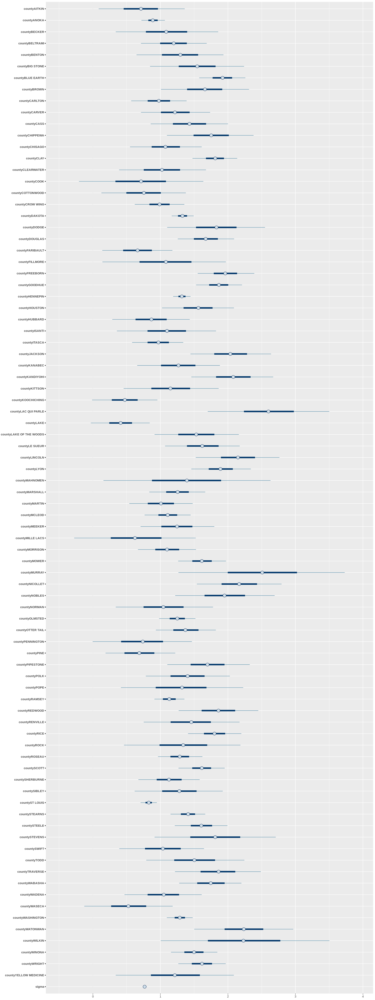

In [ ]:
options(repr.plot.width = 15, repr.plot.height = 40)
mcmc_intervals(post_unpooled_model)
# g1 <- mcmc_intervals(post_unpooled_model, pars = c("(Intercept)"))
# g2 <- mcmc_intervals(post_unpooled_model, pars = c("sigma"))
# g1 + g2

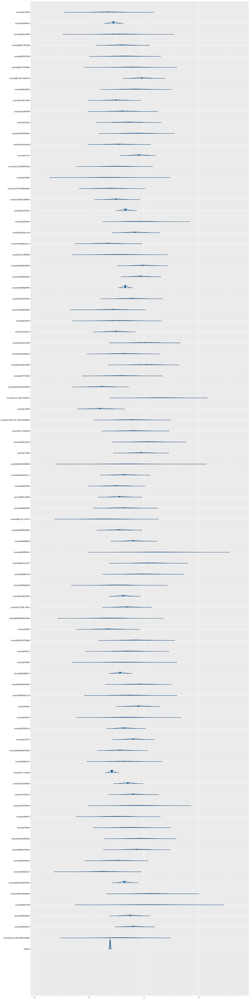

In [ ]:
options(repr.plot.width = 15, repr.plot.height = 60)
mcmc_areas(post_unpooled_model)

`stat_bin()` using `bins = 30`. Pick better value `binwidth`.


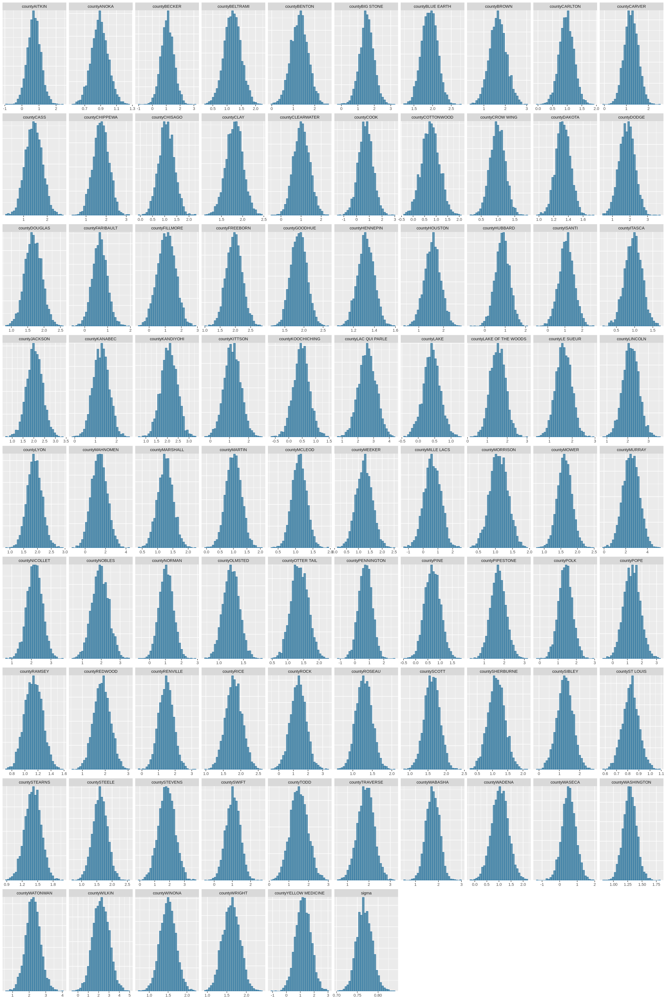

In [ ]:
options(repr.plot.width = 20, repr.plot.height = 30)
mcmc_hist(post_unpooled_model)

In [ ]:
print(unpooled_model)

stan_glm
 family:       gaussian [identity]
 formula:      log_radon ~ 0 + county
 observations: 919
 predictors:   85
------
                        Median MAD_SD
countyAITKIN            0.7    0.4   
countyANOKA             0.9    0.1   
countyBECKER            1.1    0.5   
countyBELTRAMI          1.2    0.3   
countyBENTON            1.3    0.4   
countyBIG STONE         1.5    0.4   
countyBLUE EARTH        1.9    0.2   
countyBROWN             1.7    0.4   
countyCARLTON           1.0    0.2   
countyCARVER            1.2    0.3   
countyCASS              1.4    0.4   
countyCHIPPEWA          1.8    0.4   
countyCHISAGO           1.1    0.3   
countyCLAY              1.8    0.2   
countyCLEARWATER        1.0    0.4   
countyCOOK              0.7    0.6   
countyCOTTONWOOD        0.8    0.4   
countyCROW WING         1.0    0.2   
countyDAKOTA            1.3    0.1   
countyDODGE             1.8    0.4   
countyDOUGLAS           1.7    0.3   
countyFARIBAULT         0.7    0.3   


## Plot posterior predictive distributions

[Posterior predictive checks (PPCs)](https://www.pymc.io/projects/docs/en/stable/learn/core_notebooks/posterior_predictive.html) are a great way to validate a model. The idea is to generate data from the model using parameters from draws from the posterior.

Elaborating slightly, one can say that PPCs analyze the degree to which data generated from the model deviate from data generated from the true distribution. So, often you will want to know if, for example, your posterior distribution is approximating your underlying distribution. The visualization aspect of this model evaluation method is also great for a 'sense check' or explaining your model to others and getting criticism.

[Graphical posterior predictive checks (PPCs)](https://mc-stan.org/bayesplot/articles/graphical-ppcs.html)

The `bayesplot` package provides various plotting functions for graphical posterior predictive checking, that is, creating graphical displays comparing observed data to simulated data from the posterior predictive distribution ([Gabry et al, 2019](https://mc-stan.org/bayesplot/articles/graphical-ppcs.html#gabry2019)).

The idea behind [posterior predictive checking](https://mc-stan.org/docs/stan-users-guide/posterior-prediction.html) is simple: if a model is a good fit then we should be able to use it to generate data that looks a lot like the data we observed. To generate the data used for posterior predictive checks (PPCs) we simulate from the posterior predictive distribution. This is the distribution of the outcome variable implied by a model after using the observed data 𝑦 (a vector of 𝑁 outcome values) to update our beliefs about unknown model parameters 𝜃.

[`posterior_predict`](https://mc-stan.org/rstanarm/reference/posterior_predict.stanreg.html): The posterior predictive distribution is the distribution of the outcome implied by the model after using the observed data to update our beliefs about the unknown parameters in the model. Simulating data from the posterior predictive distribution using the observed predictors is useful for checking the fit of the model. Drawing from the posterior predictive distribution at interesting values of the predictors also lets us visualize how a manipulation of a predictor affects (a function of) the outcome(s). With new observations of predictor variables we can use the posterior predictive distribution to generate predicted outcomes.

[`ppc_dens_overlay`](https://mc-stan.org/bayesplot/reference/PPD-distributions.html): Plot posterior or prior predictive distributions. Each of these functions makes the same plot as the corresponding `ppc_` function but without plotting any observed data `y`.

Note: in most cases the default test statistic 'mean' is too weak to detect anything of interest.

`stat_bin()` using `bins = 30`. Pick better value `binwidth`.


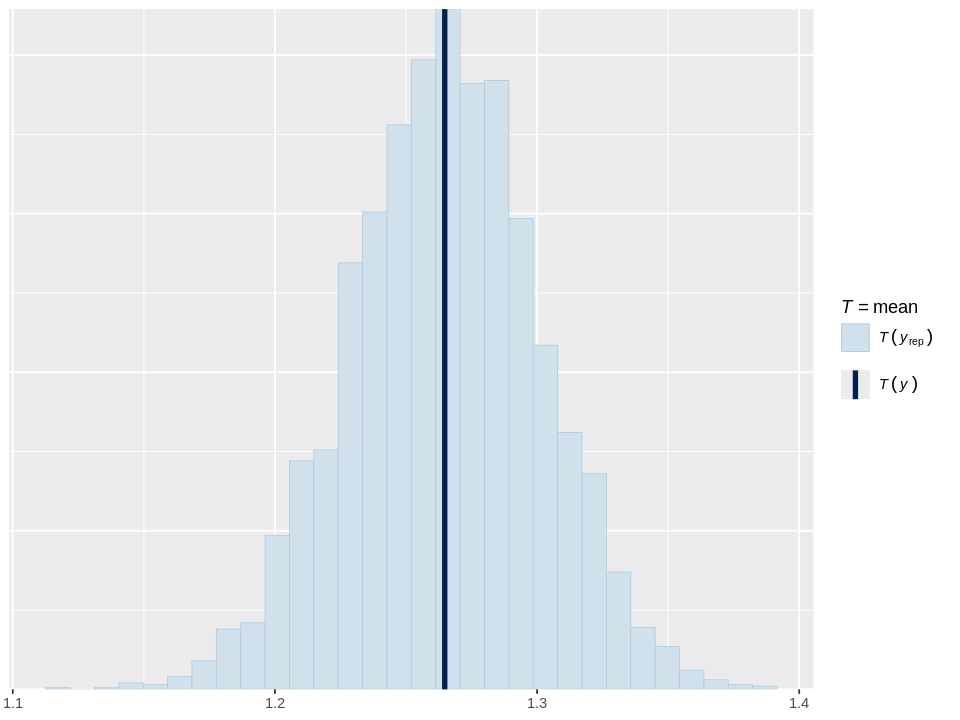

In [ ]:
options(repr.plot.width = 8, repr.plot.height = 6)
pp_check(unpooled_model, plotfun = "stat", stat = "mean")

`stat_bin()` using `bins = 30`. Pick better value `binwidth`.


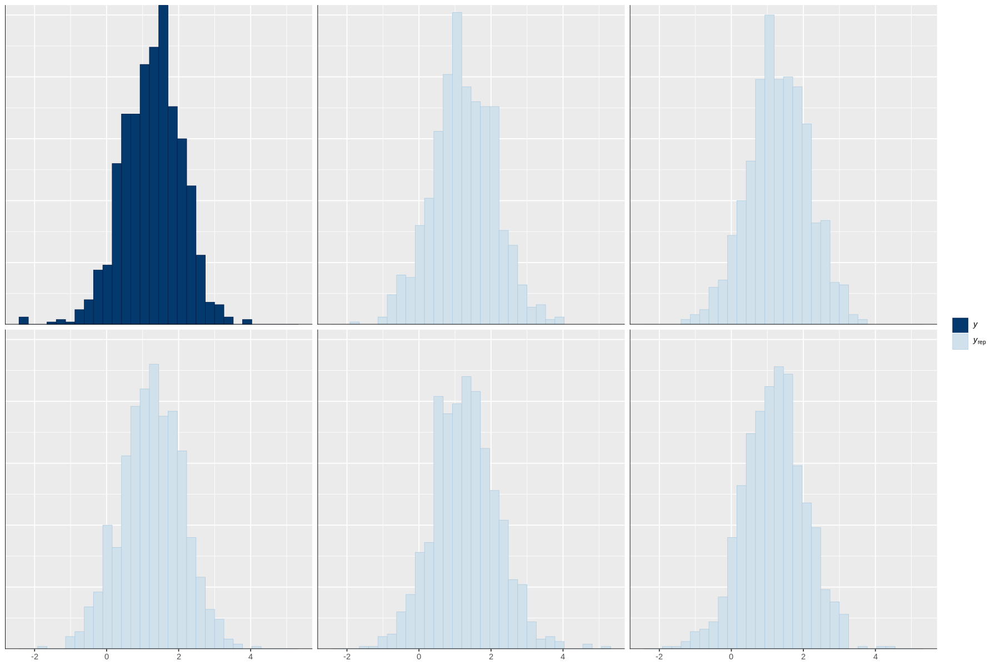

In [ ]:
options(repr.plot.width = 15, repr.plot.height = 10)
pp_check(unpooled_model, plotfun = "hist", nreps = 5)

In [ ]:
y <- radon$log_radon

In [ ]:
yrep_unpooled <- posterior_predict(unpooled_model, draws = 500)
dim(yrep_unpooled)

[1] 500 919

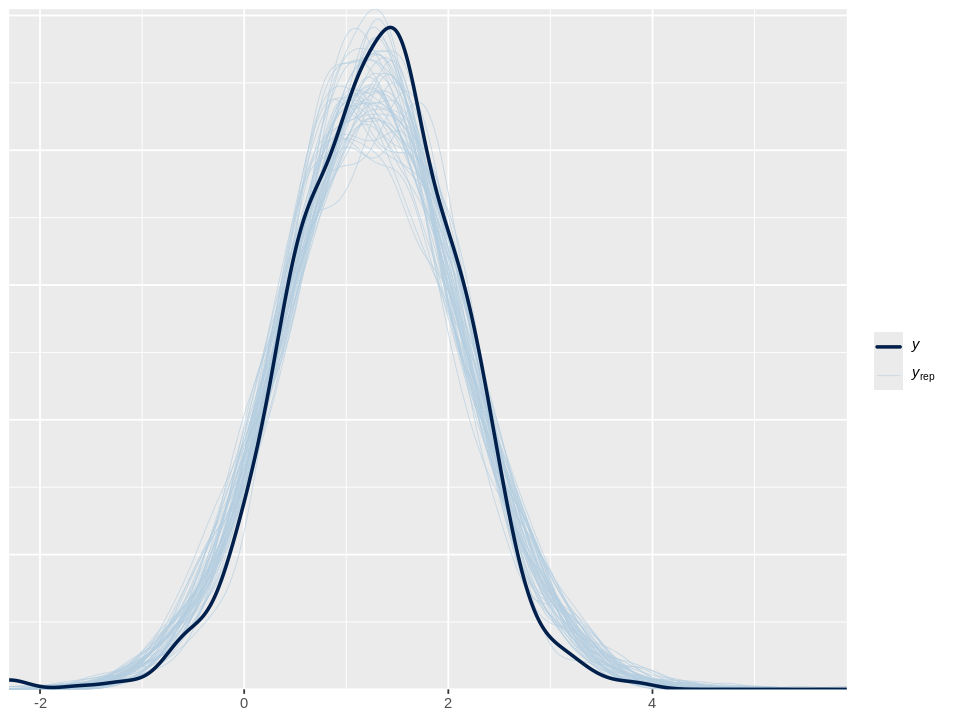

In [ ]:
options(repr.plot.width = 8, repr.plot.height = 6)
ppc_dens_overlay(y, yrep_unpooled[1:50, ])

[loo](https://mc-stan.org/loo/index.html): Efficient approximate leave-one-out cross-validation for fitted Bayesian models

From existing posterior simulation draws, we compute approximate `LOO-CV` using Pareto smoothed importance sampling (`PSIS`), a new procedure for regularizing importance weights. As a byproduct of our calculations, we also obtain approximate standard errors for estimated predictive errors and for comparing predictive errors between two models. We recommend `PSIS-LOO-CV` instead of `WAIC`, because `PSIS` provides useful diagnostics and effective sample size and Monte Carlo standard error estimates.

[`loo`](https://mc-stan.org/rstanarm/reference/loo.stanreg.html): For models fit using MCMC, compute approximate leave-one-out cross-validation (`LOO`, `LOOIC`) or, less preferably, the Widely Applicable Information Criterion (`WAIC`) using the loo package. (For 𝐾-fold cross-validation see `kfold.stanreg`.) Functions for model comparison, and model weighting/averaging are also provided.

Estimates the expected log pointwise predictive density (elpd) using Pareto-smoothed importance sampling leave-one-out cross-validation (PSIS-LOO-CV). Also calculates LOO's standard error and the effective number of parameters. Read more theory here https://arxiv.org/abs/1507.04544 and here https://arxiv.org/abs/1507.02646

In [ ]:
loo_unpooled = loo(unpooled_model)
loo_unpooled

Warning message:
“Found 5 observation(s) with a pareto_k > 0.7. We recommend calling 'loo' again with argument 'k_threshold = 0.7' in order to calculate the ELPD without the assumption that these observations are negligible. This will refit the model 5 times to compute the ELPDs for the problematic observations directly.
”



Computed from 4000 by 919 log-likelihood matrix.

         Estimate   SE
elpd_loo  -1110.9 29.1
p_loo        85.8  8.0
looic      2221.9 58.1
------
MCSE of elpd_loo is NA.
MCSE and ESS estimates assume independent draws (r_eff=1).

Pareto k diagnostic values:
                         Count Pct.    Min. ESS
(-Inf, 0.7]   (good)     914   99.5%   83      
   (0.7, 1]   (bad)        5    0.5%   <NA>    
   (1, Inf)   (very bad)   0    0.0%   <NA>    
See help('pareto-k-diagnostic') for details.

[LOO package glossary](https://mc-stan.org/loo/reference/loo-glossary.html)

`elpd`: approximated expected log pointwise predictive density (elpd).

`se`: standard error of the elpd.

`p_loo`: effective number of parameters. If we have a well-specified model, we expect the estimated effective number of parameters (`p_loo`) to be smaller than or similar to the total number of parameters in the model.

Pareto 𝑘 diagnostic values are used to assess the reliability of the estimates. In addition to the proportion of leave-one-out folds with 𝑘 values in different intervals, the minimum of the effective sample sizes in that category is shown to give idea why higher 𝑘 values are bad.

---

## **Partial pooling** without predictors

In [ ]:
partial_pooling_model <- stan_lmer(
  formula = log_radon ~ 1 + (1 | county),
  data = radon,
  refresh=0
)

partial_pooling_model

stan_lmer
 family:       gaussian [identity]
 formula:      log_radon ~ 1 + (1 | county)
 observations: 919
------
            Median MAD_SD
(Intercept) 1.4    0.0   

Auxiliary parameter(s):
      Median MAD_SD
sigma 0.8    0.0   

Error terms:
 Groups   Name        Std.Dev.
 county   (Intercept) 0.31    
 Residual             0.77    
Num. levels: county 85 

------
* For help interpreting the printed output see ?print.stanreg
* For info on the priors used see ?prior_summary.stanreg

## Plot prior parameter distributions

[Prior Choice Recommendations](https://github.com/stan-dev/stan/wiki/Prior-Choice-Recommendations)

1. Flat prior (not usually recommended).

2. Super-vague but proper prior: normal(0, 1e6) (not usually recommended).

3. Weakly informative prior, very weak: normal(0, 10).

4. Generic weakly informative prior: normal(0, 1).

5. Specific informative prior: normal(0.4, 0.2) or whatever. Sometimes this can be expressed as a scaling followed by a generic prior: theta = 0.4 + 0.2*z ; z ~ normal(0, 1).

The above numbers assume that parameters are roughly on unit scale, as is done in education (where 0 is average test score in some standard population (e.g., all students at a certain grade level) and 1 is sd of test scores in that population) or medicine (where 0 is zero dose and 1 is a standard dose such as 10mcg/day of cyanocobalamin, 1,000 IU/day cholecalciferol, etc.; these examples come from Sander Greenland).

In addition, statements such as "informative" or "weakly informative" depend crucially on what questions are being asked (a point that is related to the idea that [the prior can often only be understood in the context of the likelihood](http://www.stat.columbia.edu/~gelman/research/published/entropy-19-00555-v2.pdf)).

[Default (Weakly Informative) Prior Distributions](https://mc-stan.org/rstanarm/articles/priors.html)

With very few exceptions, the default priors in [`rstanarm`](https://mc-stan.org/rstanarm/articles/priors.html) —the priors used if they aren't specified— are not flat priors. Rather, the defaults are intended to be weakly informative. That is, they are designed to provide moderate regularization and help stabilize computation. For many (if not most) applications the defaults will perform well, but this is not guaranteed (there are no default priors that make sense for every possible model specification).

[Prior predictive checks](https://www.pymc.io/projects/docs/en/stable/learn/core_notebooks/posterior_predictive.html) are also a crucial part of the Bayesian modeling workflow. Basically, they have two main benefits:

* They allow you to check whether you are indeed incorporating scientific knowledge into your model - in short, they help you check how credible your assumptions before seeing the data are.

* They can help sampling considerably, especially for generalized linear models, where the outcome space and the parameter space diverge because of the link function.

[`prior_summary`](https://mc-stan.org/rstanarm/reference/prior_summary.stanreg.html): Summarize the priors used for an [`rstanarm`](https://mc-stan.org/rstanarm/articles/priors.html) model.

In [ ]:
prior_summary(partial_pooling_model)

Priors for model 'partial_pooling_model' 
------
Intercept (after predictors centered)
  Specified prior:
    ~ normal(location = 1.3, scale = 2.5)
  Adjusted prior:
    ~ normal(location = 1.3, scale = 2)

Auxiliary (sigma)
  Specified prior:
    ~ exponential(rate = 1)
  Adjusted prior:
    ~ exponential(rate = 1.2)

Covariance
 ~ decov(reg. = 1, conc. = 1, shape = 1, scale = 1)
------
See help('prior_summary.stanreg') for more details

## Fit model

[Fit](https://mc-stan.org/rstanarm/reference/stan_glm.html) the model using Stan.

`formula`, `data`, `subset`: Same as [glm](https://rdrr.io/r/stats/glm.html), but *we strongly advise against omitting the `data` argument*. Unless data is specified (and is a data frame) many post-estimation functions (including `update`, `loo`, `kfold`) are not guaranteed to work properly.

`iter`: The number of samples to draw from the posterior distribution. By default, all `rstanarm` modeling functions will run **four** randomly initialized Markov chains, each for `2000` iterations (including a warmup period of `1000` iterations that is discarded).

`chains`: The number of chains to sample. Running independent chains is important for some convergence statistics and can also reveal multiple modes in the posterior. By default, all `rstanarm` modeling functions will run **four** randomly initialized Markov chains, each for `2000` iterations (including a warmup period of `1000` iterations that is discarded).

`algorithm`: A string (possibly abbreviated) indicating the estimation approach to use. Can be `"sampling"` for MCMC (the **default**), `"optimizing"` for optimization, `"meanfield"` for variational inference with independent normal distributions, or `"fullrank"` for variational inference with a multivariate normal distribution. See [rstanarm-package](https://mc-stan.org/rstanarm/reference/rstanarm-package.html) for more details on the estimation algorithms.

[Markov Chain Monte Carlo (MCMC)](https://bookdown.org/content/4857/markov-chain-monte-carlo.html): This chapter introduces one commonplace example of [Fortuna](https://en.wikipedia.org/wiki/Rota_Fortunae#/media/File:Lydgate-siege-troy-wheel-fortune-detail.jpg) and [Minerva](https://en.wikipedia.org/wiki/Minerva#/media/File:Minerva-Vedder-Highsmith-detail-1.jpeg)'s cooperation: the estimation of posterior probability distributions using a stochastic process known as **Markov chain Monte Carlo (MCMC)** ([McElreath, 2020a, p. 263](https://bookdown.org/content/4857/markov-chain-monte-carlo.html#ref-mcelreathStatisticalRethinkingBayesian2020), **emphasis** in the original).

In [ ]:
partial_pooling_model <- stan_lmer(
  formula = log_radon ~ 1 + (1 | county),
  data = radon,
  refresh=0
)

partial_pooling_model

stan_lmer
 family:       gaussian [identity]
 formula:      log_radon ~ 1 + (1 | county)
 observations: 919
------
            Median MAD_SD
(Intercept) 1.4    0.0   

Auxiliary parameter(s):
      Median MAD_SD
sigma 0.8    0.0   

Error terms:
 Groups   Name        Std.Dev.
 county   (Intercept) 0.31    
 Residual             0.77    
Num. levels: county 85 

------
* For help interpreting the printed output see ?print.stanreg
* For info on the priors used see ?prior_summary.stanreg

In [ ]:
summary(partial_pooling_model)


Model Info:
 function:     stan_lmer
 family:       gaussian [identity]
 formula:      log_radon ~ 1 + (1 | county)
 algorithm:    sampling
 sample:       4000 (posterior sample size)
 priors:       see help('prior_summary')
 observations: 919
 groups:       county (85)

Estimates:
                                          mean   sd   10%   50%   90%
(Intercept)                              1.4    0.0  1.3   1.4   1.4 
b[(Intercept) county:AITKIN]            -0.2    0.2 -0.5  -0.2   0.1 
b[(Intercept) county:ANOKA]             -0.4    0.1 -0.6  -0.4  -0.3 
b[(Intercept) county:BECKER]            -0.1    0.2 -0.4  -0.1   0.2 
b[(Intercept) county:BELTRAMI]          -0.1    0.2 -0.3  -0.1   0.2 
b[(Intercept) county:BENTON]             0.0    0.2 -0.3   0.0   0.3 
b[(Intercept) county:BIG_STONE]          0.1    0.3 -0.3   0.1   0.4 
b[(Intercept) county:BLUE_EARTH]         0.4    0.2  0.2   0.4   0.6 
b[(Intercept) county:BROWN]              0.1    0.2 -0.2   0.1   0.4 
b[(Intercept) co

[Fitted model objects](https://mc-stan.org/rstanarm/reference/stanreg-objects.html)

The `rstanarm` model-fitting functions return an object of class `'stanreg'`, which is a list containing at a minimum the components listed below. Each stanreg object will also have additional classes (e.g. `'aov'`, `'betareg'`, `'glm'`, `'polr'`, etc.) and several additional components depending on the model and estimation algorithm.

[`summary`](https://mc-stan.org/rstanarm/reference/summary.stanreg.html): Summary method for stanreg objects. Summaries of parameter estimates and MCMC convergence diagnostics (Monte Carlo error, effective sample size, Rhat).

[Reference](https://mc-stan.org/rstanarm/reference/index.html)

* About `rstanarm`

* Fitting models

* Methods

* Additional documentation

## Plot MCMC diagnostics

[`mcmc_neff`](https://mc-stan.org/bayesplot/reference/MCMC-diagnostics.html): Ratios of effective sample size to total sample size as either points or a histogram. Values are colored using different shades (lighter is better). The chosen thresholds are somewhat arbitrary, but can be useful guidelines in practice.

[`mcmc_rhat`](https://mc-stan.org/bayesplot/reference/MCMC-diagnostics.html): [`R-hat`](https://mc-stan.org/bayesplot/articles/visual-mcmc-diagnostics.html#rhat-potential-scale-reduction-statistic) values as either points or a histogram. Values are colored using different shades (lighter is better). The chosen thresholds are somewhat arbitrary, but can be useful guidelines in practice.

[`mcmc_dens_overlay`](https://mc-stan.org/bayesplot/reference/MCMC-diagnostics.html): Various [types](https://mc-stan.org/bayesplot/reference/MCMC-distributions.html) of histograms and kernel density plots of MCMC draws.

[`mcmc_trace`](https://python.arviz.org/en/stable/examples/plot_trace.html): Trace and rank [plots](https://mc-stan.org/bayesplot/reference/MCMC-traces.html) of MCMC draws.

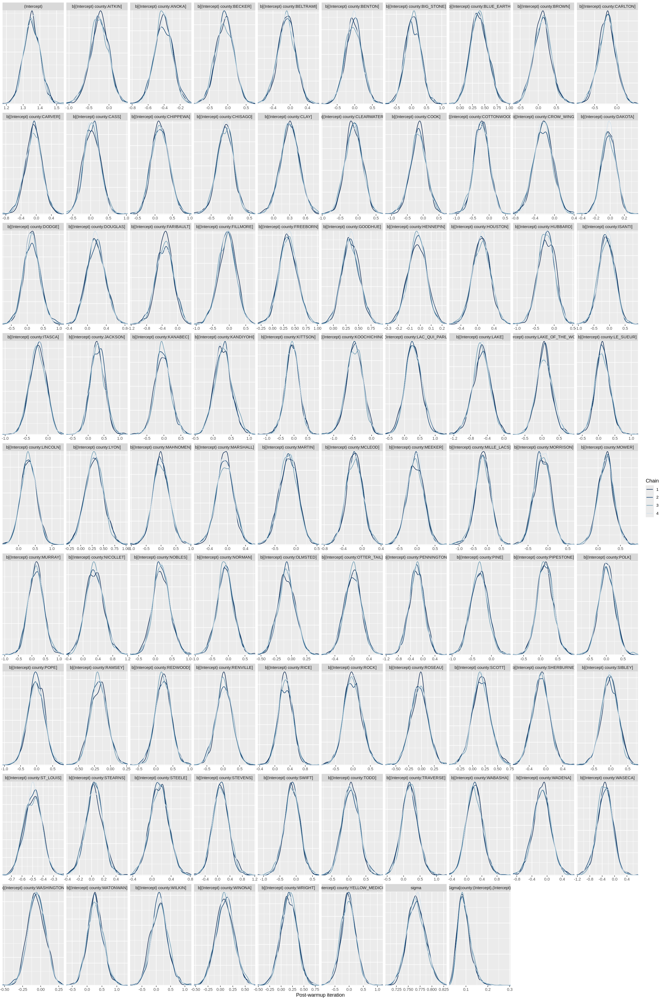

In [ ]:
options(repr.plot.width = 20, repr.plot.height = 30)
mcmc_dens_overlay(partial_pooling_model) +
  xlab("Post-warmup iteration")

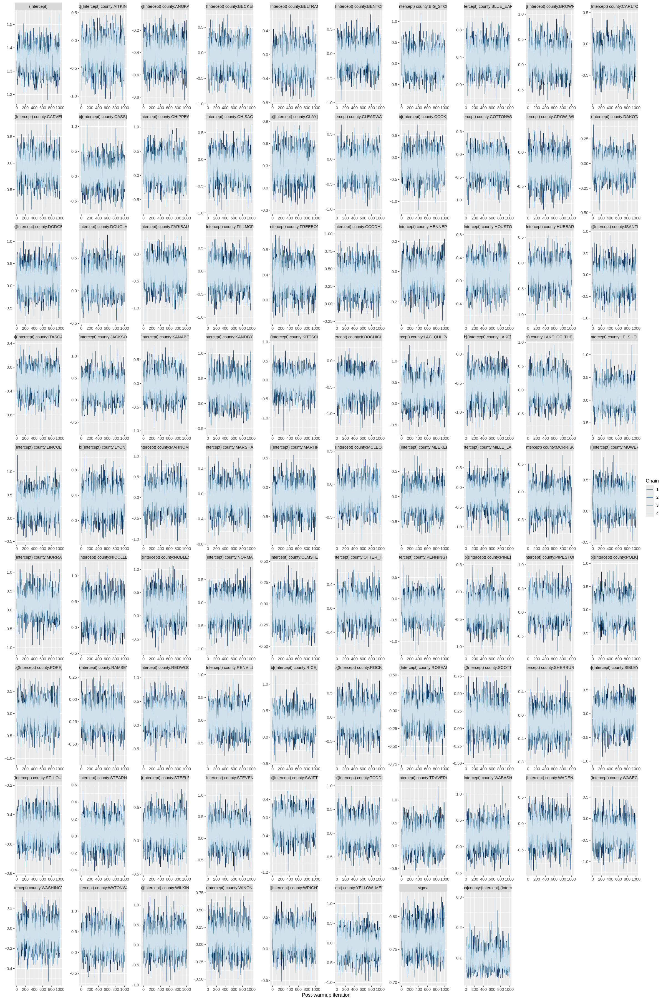

In [ ]:
options(repr.plot.width = 20, repr.plot.height = 30)
mcmc_trace(partial_pooling_model) +
  xlab("Post-warmup iteration")

## Plot posterior distributions

The [posterior probability](https://en.wikipedia.org/wiki/Posterior_probability) is a type of [conditional probability](https://en.wikipedia.org/wiki/Conditional_probability) that results from [updating](https://en.wikipedia.org/wiki/Bayesian_updating) the [prior probability](https://en.wikipedia.org/wiki/Prior_probability) with information summarized by the [likelihood](https://en.wikipedia.org/wiki/Likelihood_function) via an application of [Bayes' rule](https://en.wikipedia.org/wiki/Bayes%27_rule).

Chapter 7 [The Posterior - The Goal of Bayesian
Inference](https://sites.math.rutgers.edu/~zeilberg/EM20/Lambert.pdf) in "A Student's Guide to Bayesian Statistics" by Ben Lambert

[`as.array` `as.matrix` `as.data.frame`](https://mc-stan.org/rstanarm/reference/as.matrix.stanreg.html): Extract the posterior sample. For models fit using MCMC (`algorithm="sampling"`), the posterior sample -the post-warmup draws from the posterior distribution- can be extracted from a fitted model object as a matrix, data frame, or array. The `as.matrix` and `as.data.frame` methods merge all chains together, whereas the `as.array` method keeps the chains separate.

[`pp_check`](https://mc-stan.org/bayesplot/reference/pp_check.html): Posterior (or prior) predictive checks (S3 generic and default method).

In [ ]:
post_partial_pooling_model <- as.array(partial_pooling_model)
dim(post_partial_pooling_model)

[1] 1000    4   88

In [ ]:
dimnames(post_partial_pooling_model)

$iterations
NULL

$chains
[1] "chain:1" "chain:2" "chain:3" "chain:4"

$parameters
 [1] "(Intercept)"                            
 [2] "b[(Intercept) county:AITKIN]"           
 [3] "b[(Intercept) county:ANOKA]"            
 [4] "b[(Intercept) county:BECKER]"           
 [5] "b[(Intercept) county:BELTRAMI]"         
 [6] "b[(Intercept) county:BENTON]"           
 [7] "b[(Intercept) county:BIG_STONE]"        
 [8] "b[(Intercept) county:BLUE_EARTH]"       
 [9] "b[(Intercept) county:BROWN]"            
[10] "b[(Intercept) county:CARLTON]"          
[11] "b[(Intercept) county:CARVER]"           
[12] "b[(Intercept) county:CASS]"             
[13] "b[(Intercept) county:CHIPPEWA]"         
[14] "b[(Intercept) county:CHISAGO]"          
[15] "b[(Intercept) county:CLAY]"             
[16] "b[(Intercept) county:CLEARWATER]"       
[17] "b[(Intercept) county:COOK]"             
[18] "b[(Intercept) county:COTTONWOOD]"       
[19] "b[(Intercept) county:CROW_WING]"        
[20] "b[(Intercept) county:DAKOTA]"           
[21] "b[(Intercept) county:DODGE]"            
[22] "b[(Intercept) county:DOUGLAS]"          
[23] "b[(Intercept) county:FARIBAULT]"        
[24] "b[(Intercept) county:FILLMORE]"         
[25] "b[(Intercept) county:FREEBORN]"         
[26] "b[(Intercept) county:GOODHUE]"          
[27] "b[(Intercept) county:HENNEPIN]"         
[28] "b[(Intercept) county:HOUSTON]"          
[29] "b[(Intercept) county:HUBBARD]"          
[30] "b[(Intercept) county:ISANTI]"           
[31] "b[(Intercept) county:ITASCA]"           
[32] "b[(Intercept) county:JACKSON]"          
[33] "b[(Intercept) county:KANABEC]"          
[34] "b[(Intercept) county:KANDIYOHI]"        
[35] "b[(Intercept) county:KITTSON]"          
[36] "b[(Intercept) county:KOOCHICHING]"      
[37] "b[(Intercept) county:LAC_QUI_PARLE]"    
[38] "b[(Intercept) county:LAKE]"             
[39] "b[(Intercept) county:LAKE_OF_THE_WOODS]"
[40] "b[(Intercept) county:LE_SUEUR]"         
[41] "b[(Intercept) county:LINCOLN]"          
[42] "b[(Intercept) county:LYON]"             
[43] "b[(Intercept) county:MAHNOMEN]"         
[44] "b[(Intercept) county:MARSHALL]"         
[45] "b[(Intercept) county:MARTIN]"           
[46] "b[(Intercept) county:MCLEOD]"           
[47] "b[(Intercept) county:MEEKER]"           
[48] "b[(Intercept) county:MILLE_LACS]"       
[49] "b[(Intercept) county:MORRISON]"         
[50] "b[(Intercept) county:MOWER]"            
[51] "b[(Intercept) county:MURRAY]"           
[52] "b[(Intercept) county:NICOLLET]"         
[53] "b[(Intercept) county:NOBLES]"           
[54] "b[(Intercept) county:NORMAN]"           
[55] "b[(Intercept) county:OLMSTED]"          
[56] "b[(Intercept) county:OTTER_TAIL]"       
[57] "b[(Intercept) county:PENNINGTON]"       
[58] "b[(Intercept) county:PINE]"             
[59] "b[(Intercept) county:PIPESTONE]"        
[60] "b[(Intercept) county:POLK]"             
[61] "b[(Intercept) county:POPE]"             
[62] "b[(Intercept) county:RAMSEY]"           
[63] "b[(Intercept) county:REDWOOD]"          
[64] "b[(Intercept) county:RENVILLE]"         
[65] "b[(Intercept) county:RICE]"             
[66] "b[(Intercept) county:ROCK]"             
[67] "b[(Intercept) county:ROSEAU]"           
[68] "b[(Intercept) county:SCOTT]"            
[69] "b[(Intercept) county:SHERBURNE]"        
[70] "b[(Intercept) county:SIBLEY]"           
[71] "b[(Intercept) county:ST_LOUIS]"         
[72] "b[(Intercept) county:STEARNS]"          
[73] "b[(Intercept) county:STEELE]"           
[74] "b[(Intercept) county:STEVENS]"          
[75] "b[(Intercept) county:SWIFT]"            
[76] "b[(Intercept) county:TODD]"             
[77] "b[(Intercept) county:TRAVERSE]"         
[78] "b[(Intercept) county:WABASHA]"          
[79] "b[(Intercept) county:WADENA]"           
[80] "b[(Intercept) county:WASECA]"           
[81] "b[(Intercept) county:WASHINGTON]"       
[82] "b[(Intercept) county:WATONWAN]"         
[83] "b[(Intercept) county:WILKIN]"           
[84] "b[(Interce

In [ ]:
post_partial_pooling_model <- as.matrix(partial_pooling_model)
dim(post_partial_pooling_model)

[1] 4000   88

In [ ]:
dimnames(post_partial_pooling_model)

$iterations
NULL

$parameters
 [1] "(Intercept)"                            
 [2] "b[(Intercept) county:AITKIN]"           
 [3] "b[(Intercept) county:ANOKA]"            
 [4] "b[(Intercept) county:BECKER]"           
 [5] "b[(Intercept) county:BELTRAMI]"         
 [6] "b[(Intercept) county:BENTON]"           
 [7] "b[(Intercept) county:BIG_STONE]"        
 [8] "b[(Intercept) county:BLUE_EARTH]"       
 [9] "b[(Intercept) county:BROWN]"            
[10] "b[(Intercept) county:CARLTON]"          
[11] "b[(Intercept) county:CARVER]"           
[12] "b[(Intercept) county:CASS]"             
[13] "b[(Intercept) county:CHIPPEWA]"         
[14] "b[(Intercept) county:CHISAGO]"          
[15] "b[(Intercept) county:CLAY]"             
[16] "b[(Intercept) county:CLEARWATER]"       
[17] "b[(Intercept) county:COOK]"             
[18] "b[(Intercept) county:COTTONWOOD]"       
[19] "b[(Intercept) county:CROW_WING]"        
[20] "b[(Intercept) county:DAKOTA]"           
[21] "b[(Intercept) county:DODGE]"            
[22] "b[(Intercept) county:DOUGLAS]"          
[23] "b[(Intercept) county:FARIBAULT]"        
[24] "b[(Intercept) county:FILLMORE]"         
[25] "b[(Intercept) county:FREEBORN]"         
[26] "b[(Intercept) county:GOODHUE]"          
[27] "b[(Intercept) county:HENNEPIN]"         
[28] "b[(Intercept) county:HOUSTON]"          
[29] "b[(Intercept) county:HUBBARD]"          
[30] "b[(Intercept) county:ISANTI]"           
[31] "b[(Intercept) county:ITASCA]"           
[32] "b[(Intercept) county:JACKSON]"          
[33] "b[(Intercept) county:KANABEC]"          
[34] "b[(Intercept) county:KANDIYOHI]"        
[35] "b[(Intercept) county:KITTSON]"          
[36] "b[(Intercept) county:KOOCHICHING]"      
[37] "b[(Intercept) county:LAC_QUI_PARLE]"    
[38] "b[(Intercept) county:LAKE]"             
[39] "b[(Intercept) county:LAKE_OF_THE_WOODS]"
[40] "b[(Intercept) county:LE_SUEUR]"         
[41] "b[(Intercept) county:LINCOLN]"          
[42] "b[(Intercept) county:LYON]"             
[43] "b[(Intercept) county:MAHNOMEN]"         
[44] "b[(Intercept) county:MARSHALL]"         
[45] "b[(Intercept) county:MARTIN]"           
[46] "b[(Intercept) county:MCLEOD]"           
[47] "b[(Intercept) county:MEEKER]"           
[48] "b[(Intercept) county:MILLE_LACS]"       
[49] "b[(Intercept) county:MORRISON]"         
[50] "b[(Intercept) county:MOWER]"            
[51] "b[(Intercept) county:MURRAY]"           
[52] "b[(Intercept) county:NICOLLET]"         
[53] "b[(Intercept) county:NOBLES]"           
[54] "b[(Intercept) county:NORMAN]"           
[55] "b[(Intercept) county:OLMSTED]"          
[56] "b[(Intercept) county:OTTER_TAIL]"       
[57] "b[(Intercept) county:PENNINGTON]"       
[58] "b[(Intercept) county:PINE]"             
[59] "b[(Intercept) county:PIPESTONE]"        
[60] "b[(Intercept) county:POLK]"             
[61] "b[(Intercept) county:POPE]"             
[62] "b[(Intercept) county:RAMSEY]"           
[63] "b[(Intercept) county:REDWOOD]"          
[64] "b[(Intercept) county:RENVILLE]"         
[65] "b[(Intercept) county:RICE]"             
[66] "b[(Intercept) county:ROCK]"             
[67] "b[(Intercept) county:ROSEAU]"           
[68] "b[(Intercept) county:SCOTT]"            
[69] "b[(Intercept) county:SHERBURNE]"        
[70] "b[(Intercept) county:SIBLEY]"           
[71] "b[(Intercept) county:ST_LOUIS]"         
[72] "b[(Intercept) county:STEARNS]"          
[73] "b[(Intercept) county:STEELE]"           
[74] "b[(Intercept) county:STEVENS]"          
[75] "b[(Intercept) county:SWIFT]"            
[76] "b[(Intercept) county:TODD]"             
[77] "b[(Intercept) county:TRAVERSE]"         
[78] "b[(Intercept) county:WABASHA]"          
[79] "b[(Intercept) county:WADENA]"           
[80] "b[(Intercept) county:WASECA]"           
[81] "b[(Intercept) county:WASHINGTON]"       
[82] "b[(Intercept) county:WATONWAN]"         
[83] "b[(Intercept) county:WILKIN]"           
[84] "b[(Intercept) county:WINONA]"           
[85] "b[(Intercept) co

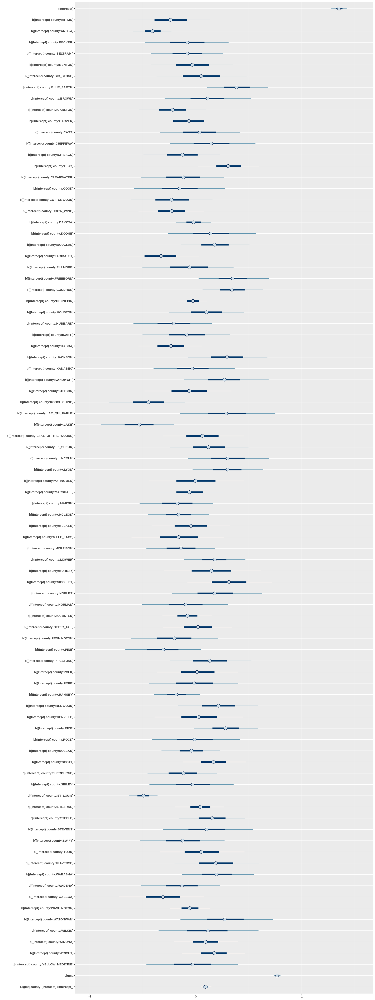

In [ ]:
options(repr.plot.width = 15, repr.plot.height = 40)
mcmc_intervals(post_partial_pooling_model)
# g1 <- mcmc_intervals(post_partial_pooling_model, pars = c("(Intercept)"))
# g2 <- mcmc_intervals(post_partial_pooling_model, pars = c("sigma"))
# g1 + g2

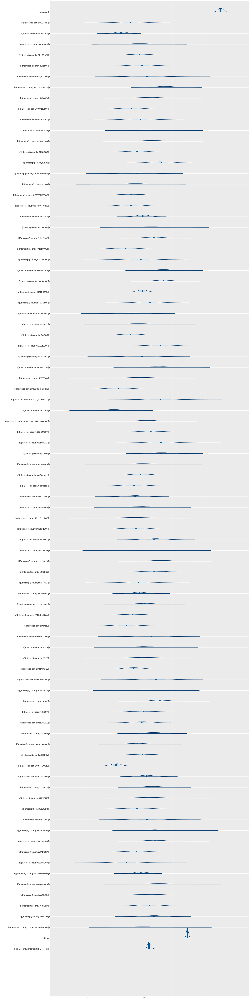

In [ ]:
options(repr.plot.width = 15, repr.plot.height = 60)
mcmc_areas(post_partial_pooling_model)

`stat_bin()` using `bins = 30`. Pick better value `binwidth`.


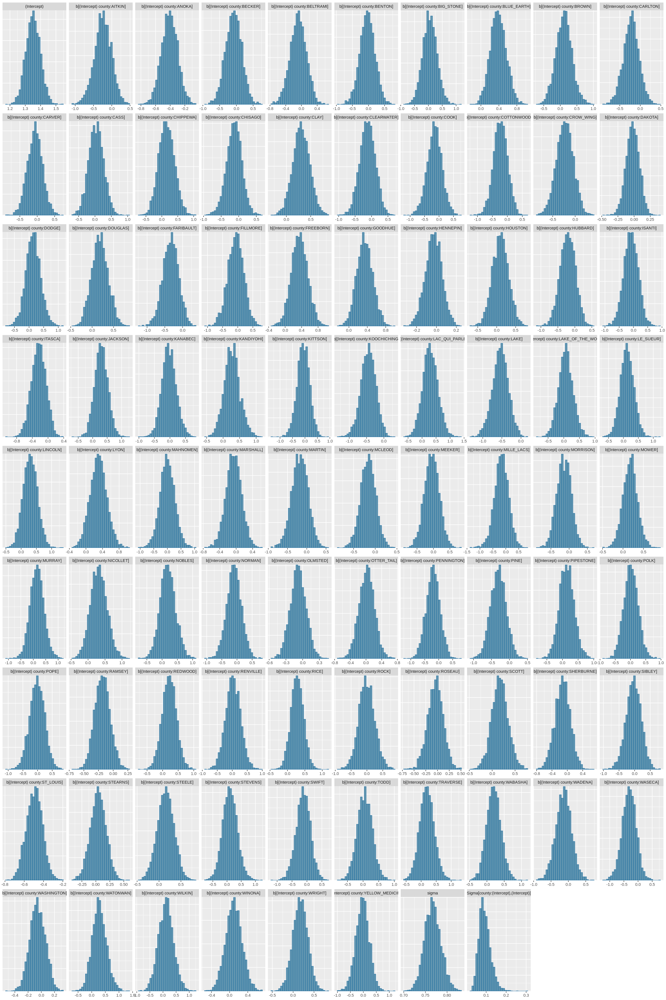

In [ ]:
options(repr.plot.width = 20, repr.plot.height = 30)
mcmc_hist(post_partial_pooling_model)

In [ ]:
print(partial_pooling_model)

stan_lmer
 family:       gaussian [identity]
 formula:      log_radon ~ 1 + (1 | county)
 observations: 919
------
            Median MAD_SD
(Intercept) 1.4    0.0   

Auxiliary parameter(s):
      Median MAD_SD
sigma 0.8    0.0   

Error terms:
 Groups   Name        Std.Dev.
 county   (Intercept) 0.31    
 Residual             0.77    
Num. levels: county 85 

------
* For help interpreting the printed output see ?print.stanreg
* For info on the priors used see ?prior_summary.stanreg


## Plot posterior predictive distributions

[Posterior predictive checks (PPCs)](https://www.pymc.io/projects/docs/en/stable/learn/core_notebooks/posterior_predictive.html) are a great way to validate a model. The idea is to generate data from the model using parameters from draws from the posterior.

Elaborating slightly, one can say that PPCs analyze the degree to which data generated from the model deviate from data generated from the true distribution. So, often you will want to know if, for example, your posterior distribution is approximating your underlying distribution. The visualization aspect of this model evaluation method is also great for a 'sense check' or explaining your model to others and getting criticism.

[Graphical posterior predictive checks (PPCs)](https://mc-stan.org/bayesplot/articles/graphical-ppcs.html)

The `bayesplot` package provides various plotting functions for graphical posterior predictive checking, that is, creating graphical displays comparing observed data to simulated data from the posterior predictive distribution ([Gabry et al, 2019](https://mc-stan.org/bayesplot/articles/graphical-ppcs.html#gabry2019)).

The idea behind [posterior predictive checking](https://mc-stan.org/docs/stan-users-guide/posterior-prediction.html) is simple: if a model is a good fit then we should be able to use it to generate data that looks a lot like the data we observed. To generate the data used for posterior predictive checks (PPCs) we simulate from the posterior predictive distribution. This is the distribution of the outcome variable implied by a model after using the observed data 𝑦 (a vector of 𝑁 outcome values) to update our beliefs about unknown model parameters 𝜃.

[`posterior_predict`](https://mc-stan.org/rstanarm/reference/posterior_predict.stanreg.html): The posterior predictive distribution is the distribution of the outcome implied by the model after using the observed data to update our beliefs about the unknown parameters in the model. Simulating data from the posterior predictive distribution using the observed predictors is useful for checking the fit of the model. Drawing from the posterior predictive distribution at interesting values of the predictors also lets us visualize how a manipulation of a predictor affects (a function of) the outcome(s). With new observations of predictor variables we can use the posterior predictive distribution to generate predicted outcomes.

[`ppc_dens_overlay`](https://mc-stan.org/bayesplot/reference/PPD-distributions.html): Plot posterior or prior predictive distributions. Each of these functions makes the same plot as the corresponding `ppc_` function but without plotting any observed data `y`.

Note: in most cases the default test statistic 'mean' is too weak to detect anything of interest.

`stat_bin()` using `bins = 30`. Pick better value `binwidth`.


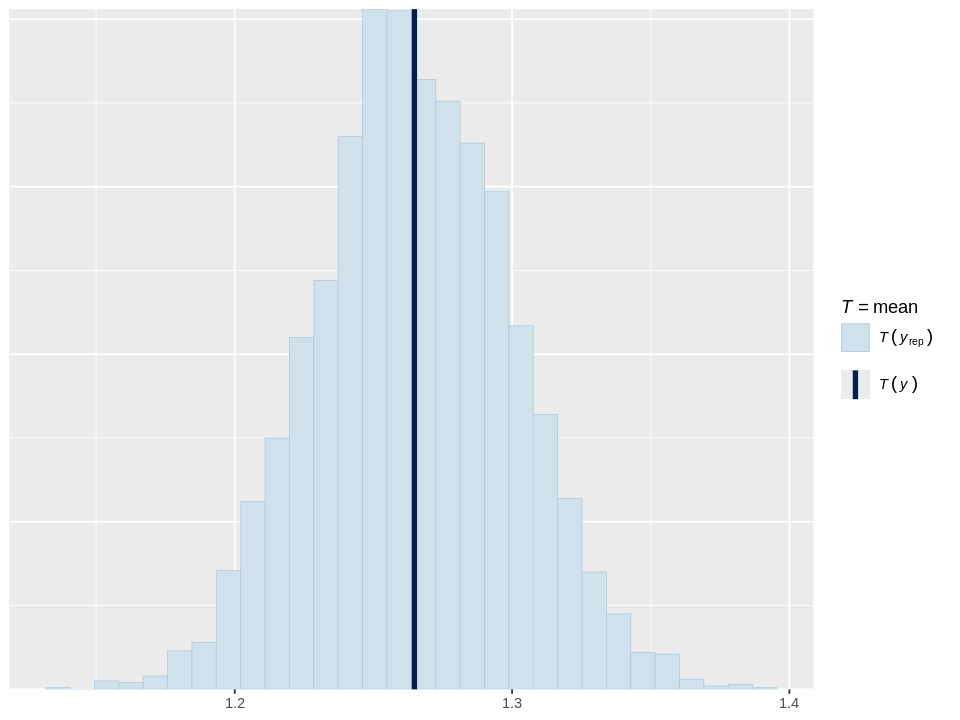

In [ ]:
options(repr.plot.width = 8, repr.plot.height = 6)
pp_check(partial_pooling_model, plotfun = "stat", stat = "mean")

`stat_bin()` using `bins = 30`. Pick better value `binwidth`.


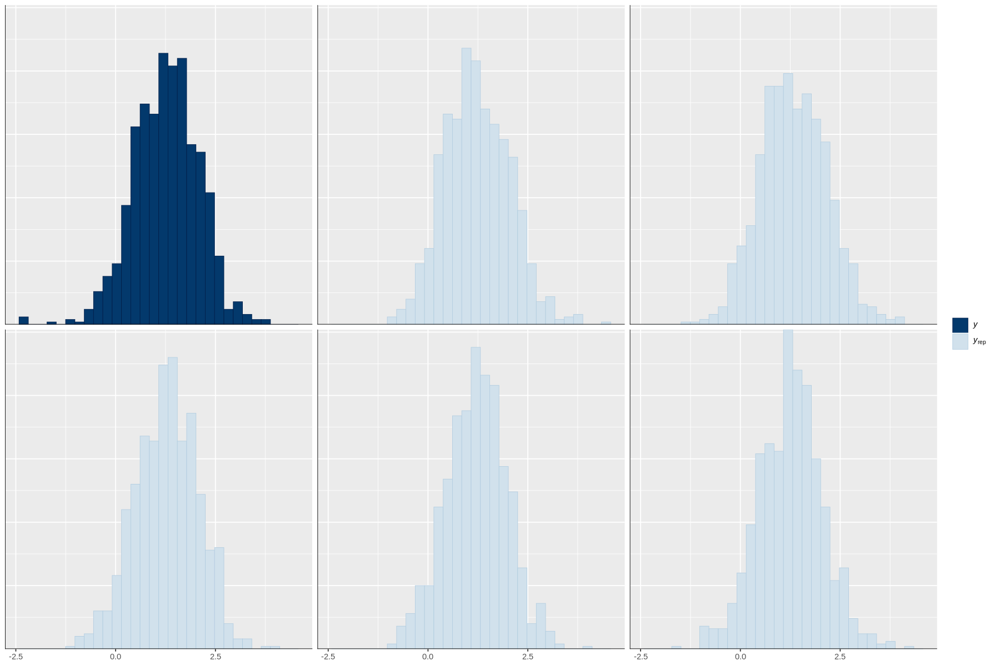

In [ ]:
options(repr.plot.width = 15, repr.plot.height = 10)
pp_check(partial_pooling_model, plotfun = "hist", nreps = 5)

In [ ]:
y <- radon$log_radon

In [ ]:
yrep_partial_pooling <- posterior_predict(partial_pooling_model, draws = 500)
dim(yrep_partial_pooling)

[1] 500 919

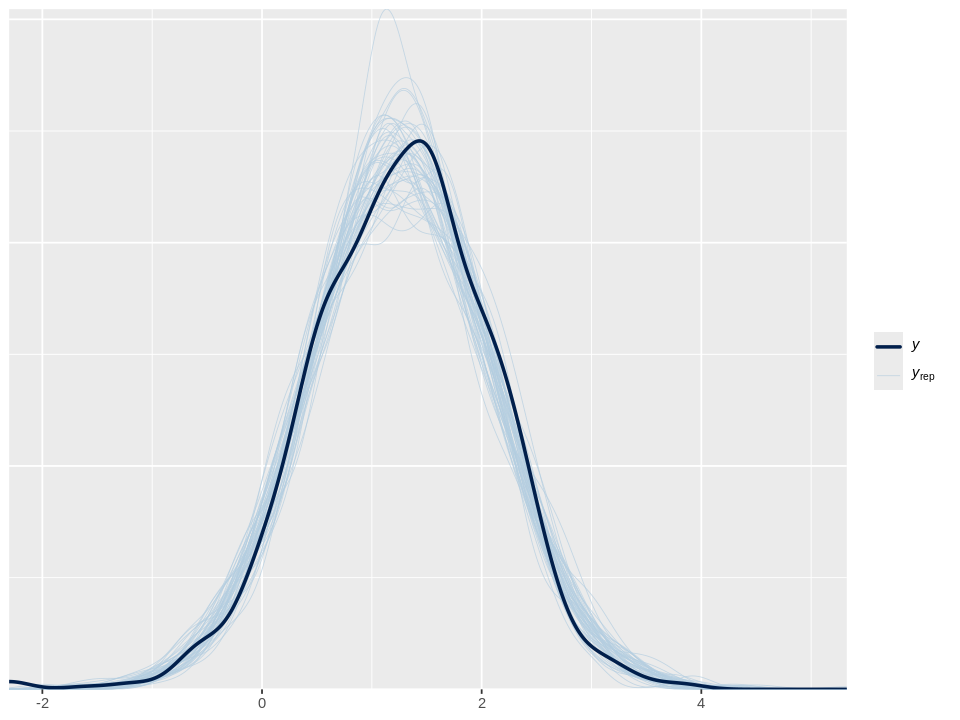

In [ ]:
options(repr.plot.width = 8, repr.plot.height = 6)
ppc_dens_overlay(y, yrep_partial_pooling[1:50, ])

[loo](https://mc-stan.org/loo/index.html): Efficient approximate leave-one-out cross-validation for fitted Bayesian models

From existing posterior simulation draws, we compute approximate `LOO-CV` using Pareto smoothed importance sampling (`PSIS`), a new procedure for regularizing importance weights. As a byproduct of our calculations, we also obtain approximate standard errors for estimated predictive errors and for comparing predictive errors between two models. We recommend `PSIS-LOO-CV` instead of `WAIC`, because `PSIS` provides useful diagnostics and effective sample size and Monte Carlo standard error estimates.

[`loo`](https://mc-stan.org/rstanarm/reference/loo.stanreg.html): For models fit using MCMC, compute approximate leave-one-out cross-validation (`LOO`, `LOOIC`) or, less preferably, the Widely Applicable Information Criterion (`WAIC`) using the loo package. (For 𝐾-fold cross-validation see `kfold.stanreg`.) Functions for model comparison, and model weighting/averaging are also provided.

Estimates the expected log pointwise predictive density (elpd) using Pareto-smoothed importance sampling leave-one-out cross-validation (PSIS-LOO-CV). Also calculates LOO's standard error and the effective number of parameters. Read more theory here https://arxiv.org/abs/1507.04544 and here https://arxiv.org/abs/1507.02646

In [ ]:
loo_partial_pooled = loo(partial_pooling_model)
loo_partial_pooled


Computed from 4000 by 919 log-likelihood matrix.

         Estimate   SE
elpd_loo  -1084.0 28.9
p_loo        44.7  4.2
looic      2168.0 57.8
------
MCSE of elpd_loo is 0.2.
MCSE and ESS estimates assume independent draws (r_eff=1).

All Pareto k estimates are good (k < 0.7).
See help('pareto-k-diagnostic') for details.

[LOO package glossary](https://mc-stan.org/loo/reference/loo-glossary.html)

`elpd`: approximated expected log pointwise predictive density (elpd).

`se`: standard error of the elpd.

`p_loo`: effective number of parameters. If we have a well-specified model, we expect the estimated effective number of parameters (`p_loo`) to be smaller than or similar to the total number of parameters in the model.

Pareto 𝑘 diagnostic values are used to assess the reliability of the estimates. In addition to the proportion of leave-one-out folds with 𝑘 values in different intervals, the minimum of the effective sample sizes in that category is shown to give idea why higher 𝑘 values are bad.

---

## Compare models

In [ ]:
# Compute LOO objects for each model
loo_pooled <- loo(pooled_model)
loo_unpooled <- loo(unpooled_model)
loo_partial_pooled <- loo(partial_pooling_model)

In [ ]:
# Compare models
comparison <- loo_compare(
  loo_pooled,
  loo_unpooled,
  loo_partial_pooled
)

# Round to 2 decimals
print(round(comparison, 2))

                      elpd_diff se_diff
partial_pooling_model   0.0       0.0  
unpooled_model        -26.9       6.7  
pooled_model          -38.5       9.3  


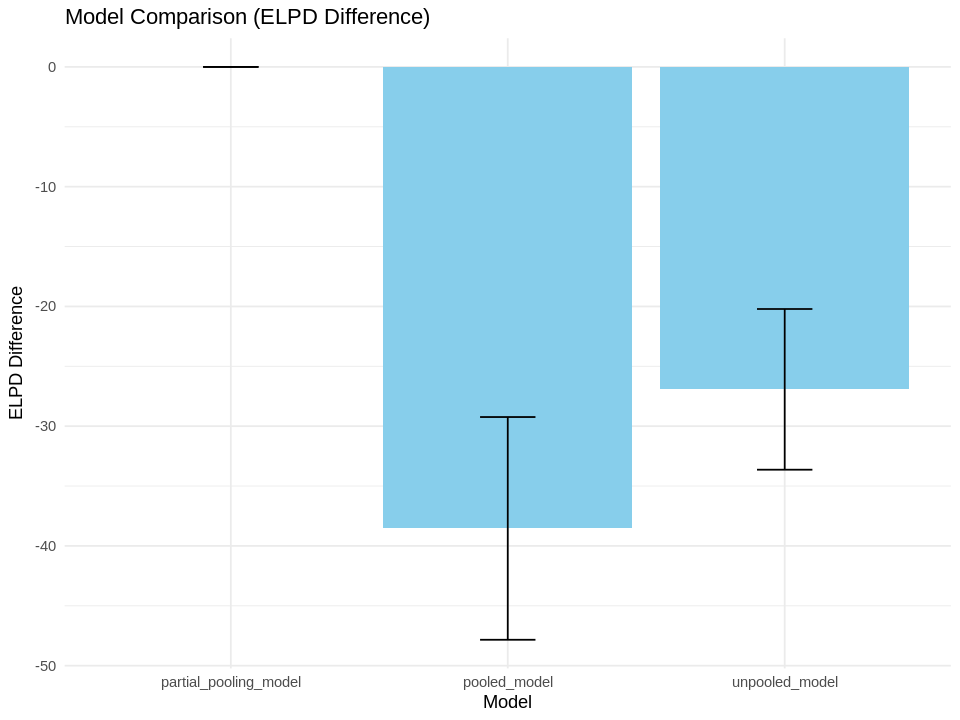

In [ ]:
plot_data <- as.data.frame(comparison)
plot_data$model_name <- rownames(plot_data)

ggplot(plot_data, aes(x = model_name, y = elpd_diff)) +
  geom_bar(stat = "identity", fill = "skyblue") +
  geom_errorbar(aes(ymin = elpd_diff - se_diff, ymax = elpd_diff + se_diff), width = 0.2) +
  labs(title = "Model Comparison (ELPD Difference)",
       x = "Model",
       y = "ELPD Difference") +
  theme_minimal()

---

# **Complete pooling** with predictors

In [ ]:
radon$floor <- ifelse(radon$floor == "Basement", 0, 1)

In [ ]:
pooled_model <- stan_glm(
  formula = log_radon ~ floor,
  data = radon,
  refresh=0
)

pooled_model

stan_glm
 family:       gaussian [identity]
 formula:      log_radon ~ floor
 observations: 919
 predictors:   2
------
            Median MAD_SD
(Intercept)  1.4    0.0  
floor       -0.6    0.1  

Auxiliary parameter(s):
      Median MAD_SD
sigma 0.8    0.0   

------
* For help interpreting the printed output see ?print.stanreg
* For info on the priors used see ?prior_summary.stanreg

## Plot prior parameter distributions

[Prior Choice Recommendations](https://github.com/stan-dev/stan/wiki/Prior-Choice-Recommendations)

1. Flat prior (not usually recommended).

2. Super-vague but proper prior: normal(0, 1e6) (not usually recommended).

3. Weakly informative prior, very weak: normal(0, 10).

4. Generic weakly informative prior: normal(0, 1).

5. Specific informative prior: normal(0.4, 0.2) or whatever. Sometimes this can be expressed as a scaling followed by a generic prior: theta = 0.4 + 0.2*z ; z ~ normal(0, 1).

The above numbers assume that parameters are roughly on unit scale, as is done in education (where 0 is average test score in some standard population (e.g., all students at a certain grade level) and 1 is sd of test scores in that population) or medicine (where 0 is zero dose and 1 is a standard dose such as 10mcg/day of cyanocobalamin, 1,000 IU/day cholecalciferol, etc.; these examples come from Sander Greenland).

In addition, statements such as "informative" or "weakly informative" depend crucially on what questions are being asked (a point that is related to the idea that [the prior can often only be understood in the context of the likelihood](http://www.stat.columbia.edu/~gelman/research/published/entropy-19-00555-v2.pdf)).

[Default (Weakly Informative) Prior Distributions](https://mc-stan.org/rstanarm/articles/priors.html)

With very few exceptions, the default priors in [`rstanarm`](https://mc-stan.org/rstanarm/articles/priors.html) —the priors used if they aren't specified— are not flat priors. Rather, the defaults are intended to be weakly informative. That is, they are designed to provide moderate regularization and help stabilize computation. For many (if not most) applications the defaults will perform well, but this is not guaranteed (there are no default priors that make sense for every possible model specification).

[Prior predictive checks](https://www.pymc.io/projects/docs/en/stable/learn/core_notebooks/posterior_predictive.html) are also a crucial part of the Bayesian modeling workflow. Basically, they have two main benefits:

* They allow you to check whether you are indeed incorporating scientific knowledge into your model - in short, they help you check how credible your assumptions before seeing the data are.

* They can help sampling considerably, especially for generalized linear models, where the outcome space and the parameter space diverge because of the link function.

[`prior_summary`](https://mc-stan.org/rstanarm/reference/prior_summary.stanreg.html): Summarize the priors used for an [`rstanarm`](https://mc-stan.org/rstanarm/articles/priors.html) model.

In [ ]:
prior_summary(pooled_model)

Priors for model 'pooled_model' 
------
Intercept (after predictors centered)
  Specified prior:
    ~ normal(location = 1.3, scale = 2.5)
  Adjusted prior:
    ~ normal(location = 1.3, scale = 2)

Coefficients
  Specified prior:
    ~ normal(location = 0, scale = 2.5)
  Adjusted prior:
    ~ normal(location = 0, scale = 5.5)

Auxiliary (sigma)
  Specified prior:
    ~ exponential(rate = 1)
  Adjusted prior:
    ~ exponential(rate = 1.2)
------
See help('prior_summary.stanreg') for more details

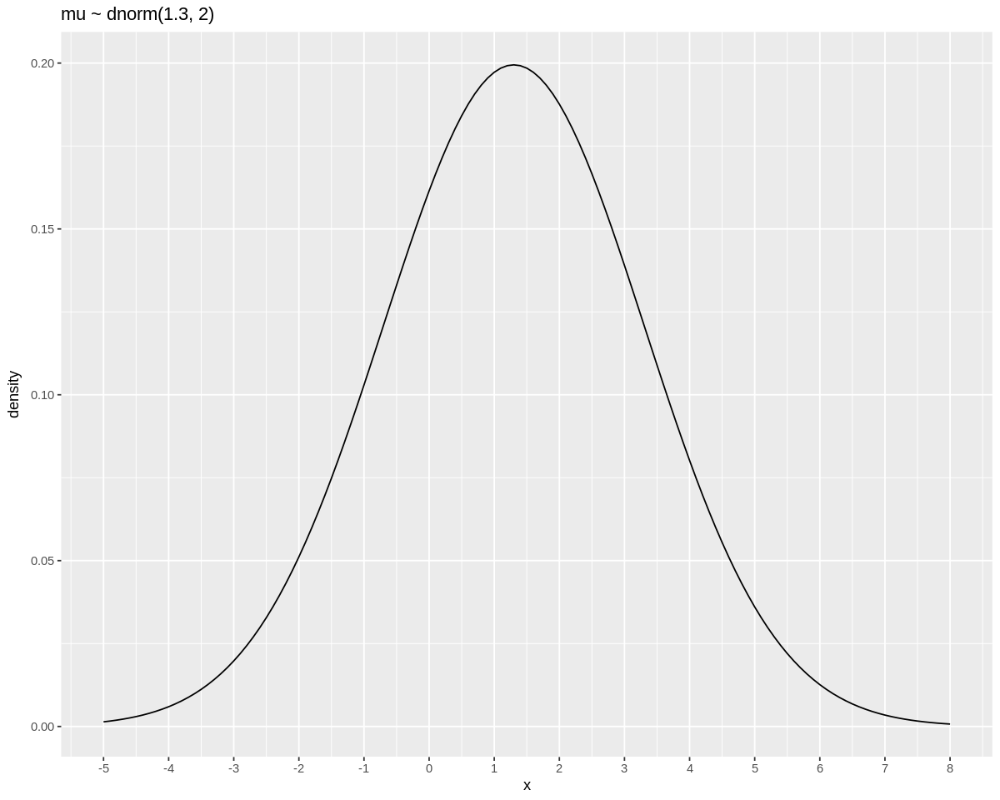

In [ ]:
options(repr.plot.width = 10, repr.plot.height = 8)
p1 <-
  tibble(x = seq(from = -5, to = 8, by = .1)) %>%

  ggplot(aes(x = x, y = dnorm(x, mean = 1.3, sd = 2))) +
  geom_line() +
  scale_x_continuous(breaks = seq(from = -5, to = 8, by = 1)) +
  labs(title = "mu ~ dnorm(1.3, 2)",
       y = "density")

p1

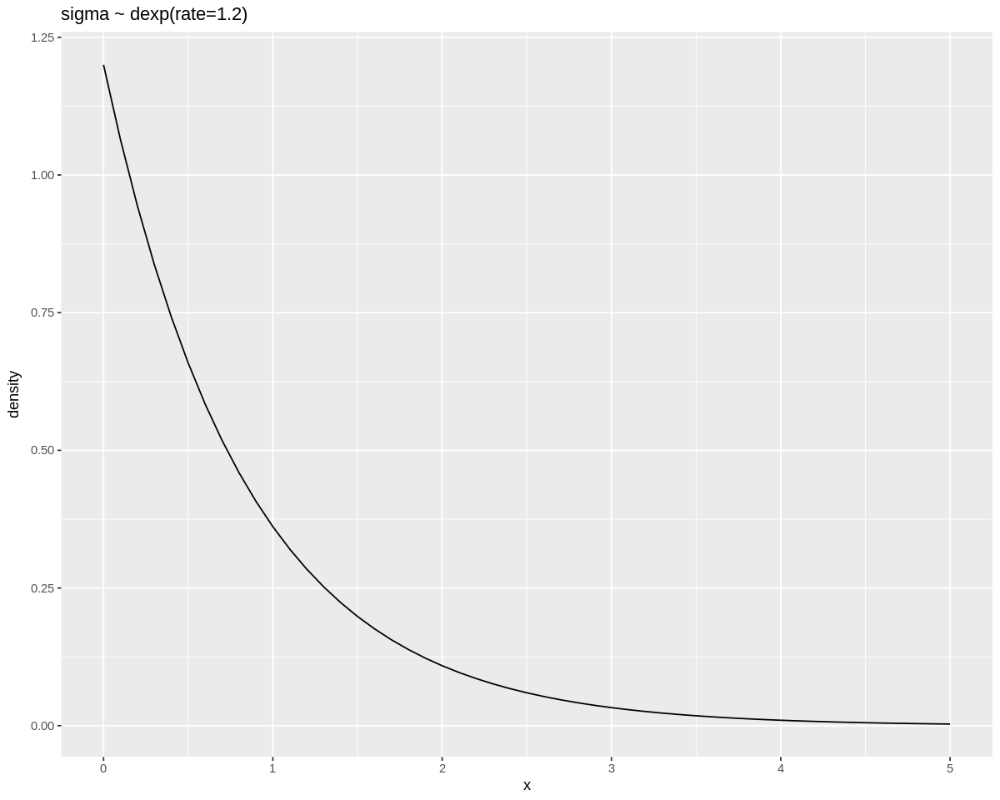

In [ ]:
options(repr.plot.width = 10, repr.plot.height = 8)
p2 <-
  tibble(x = seq(from = 0, to = 5, by = .1)) %>%

  ggplot(aes(x = x, y = dexp(x, rate = 1.2))) +
  geom_line() +
  scale_x_continuous(breaks = seq(from = 0, to = 5, by = 1)) +
  labs(title = "sigma ~ dexp(rate=1.2)",
       y = "density")

p2

## Fit model

[Fit](https://mc-stan.org/rstanarm/reference/stan_glm.html) the model using Stan.

`formula`, `data`, `subset`: Same as [glm](https://rdrr.io/r/stats/glm.html), but *we strongly advise against omitting the `data` argument*. Unless data is specified (and is a data frame) many post-estimation functions (including `update`, `loo`, `kfold`) are not guaranteed to work properly.

`iter`: The number of samples to draw from the posterior distribution. By default, all `rstanarm` modeling functions will run **four** randomly initialized Markov chains, each for `2000` iterations (including a warmup period of `1000` iterations that is discarded).

`chains`: The number of chains to sample. Running independent chains is important for some convergence statistics and can also reveal multiple modes in the posterior. By default, all `rstanarm` modeling functions will run **four** randomly initialized Markov chains, each for `2000` iterations (including a warmup period of `1000` iterations that is discarded).

`algorithm`: A string (possibly abbreviated) indicating the estimation approach to use. Can be `"sampling"` for MCMC (the **default**), `"optimizing"` for optimization, `"meanfield"` for variational inference with independent normal distributions, or `"fullrank"` for variational inference with a multivariate normal distribution. See [rstanarm-package](https://mc-stan.org/rstanarm/reference/rstanarm-package.html) for more details on the estimation algorithms.

[Markov Chain Monte Carlo (MCMC)](https://bookdown.org/content/4857/markov-chain-monte-carlo.html): This chapter introduces one commonplace example of [Fortuna](https://en.wikipedia.org/wiki/Rota_Fortunae#/media/File:Lydgate-siege-troy-wheel-fortune-detail.jpg) and [Minerva](https://en.wikipedia.org/wiki/Minerva#/media/File:Minerva-Vedder-Highsmith-detail-1.jpeg)'s cooperation: the estimation of posterior probability distributions using a stochastic process known as **Markov chain Monte Carlo (MCMC)** ([McElreath, 2020a, p. 263](https://bookdown.org/content/4857/markov-chain-monte-carlo.html#ref-mcelreathStatisticalRethinkingBayesian2020), **emphasis** in the original).

In [ ]:
pooled_model <- stan_glm(
  formula = log_radon ~ floor,
  data = radon,
  refresh=0
)

pooled_model

stan_glm
 family:       gaussian [identity]
 formula:      log_radon ~ floor
 observations: 919
 predictors:   2
------
            Median MAD_SD
(Intercept)  1.4    0.0  
floor       -0.6    0.1  

Auxiliary parameter(s):
      Median MAD_SD
sigma 0.8    0.0   

------
* For help interpreting the printed output see ?print.stanreg
* For info on the priors used see ?prior_summary.stanreg

In [ ]:
summary(pooled_model)


Model Info:
 function:     stan_glm
 family:       gaussian [identity]
 formula:      log_radon ~ floor
 algorithm:    sampling
 sample:       4000 (posterior sample size)
 priors:       see help('prior_summary')
 observations: 919
 predictors:   2

Estimates:
              mean   sd   10%   50%   90%
(Intercept)  1.4    0.0  1.3   1.4   1.4 
floor       -0.6    0.1 -0.7  -0.6  -0.5 
sigma        0.8    0.0  0.8   0.8   0.8 

Fit Diagnostics:
           mean   sd   10%   50%   90%
mean_PPD 1.3    0.0  1.2   1.3   1.3  

The mean_ppd is the sample average posterior predictive distribution of the outcome variable (for details see help('summary.stanreg')).

MCMC diagnostics
              mcse Rhat n_eff
(Intercept)   0.0  1.0  3874 
floor         0.0  1.0  4038 
sigma         0.0  1.0  4001 
mean_PPD      0.0  1.0  3995 
log-posterior 0.0  1.0  1796 

For each parameter, mcse is Monte Carlo standard error, n_eff is a crude measure of effective sample size, and Rhat is the potential scale

[Fitted model objects](https://mc-stan.org/rstanarm/reference/stanreg-objects.html)

The `rstanarm` model-fitting functions return an object of class `'stanreg'`, which is a list containing at a minimum the components listed below. Each stanreg object will also have additional classes (e.g. `'aov'`, `'betareg'`, `'glm'`, `'polr'`, etc.) and several additional components depending on the model and estimation algorithm.

[`summary`](https://mc-stan.org/rstanarm/reference/summary.stanreg.html): Summary method for stanreg objects. Summaries of parameter estimates and MCMC convergence diagnostics (Monte Carlo error, effective sample size, Rhat).

[Reference](https://mc-stan.org/rstanarm/reference/index.html)

* About `rstanarm`

* Fitting models

* Methods

* Additional documentation

## Plot MCMC diagnostics

[`mcmc_neff`](https://mc-stan.org/bayesplot/reference/MCMC-diagnostics.html): Ratios of effective sample size to total sample size as either points or a histogram. Values are colored using different shades (lighter is better). The chosen thresholds are somewhat arbitrary, but can be useful guidelines in practice.

[`mcmc_rhat`](https://mc-stan.org/bayesplot/reference/MCMC-diagnostics.html): [`R-hat`](https://mc-stan.org/bayesplot/articles/visual-mcmc-diagnostics.html#rhat-potential-scale-reduction-statistic) values as either points or a histogram. Values are colored using different shades (lighter is better). The chosen thresholds are somewhat arbitrary, but can be useful guidelines in practice.

[`mcmc_dens_overlay`](https://mc-stan.org/bayesplot/reference/MCMC-diagnostics.html): Various [types](https://mc-stan.org/bayesplot/reference/MCMC-distributions.html) of histograms and kernel density plots of MCMC draws.

[`mcmc_trace`](https://python.arviz.org/en/stable/examples/plot_trace.html): Trace and rank [plots](https://mc-stan.org/bayesplot/reference/MCMC-traces.html) of MCMC draws.

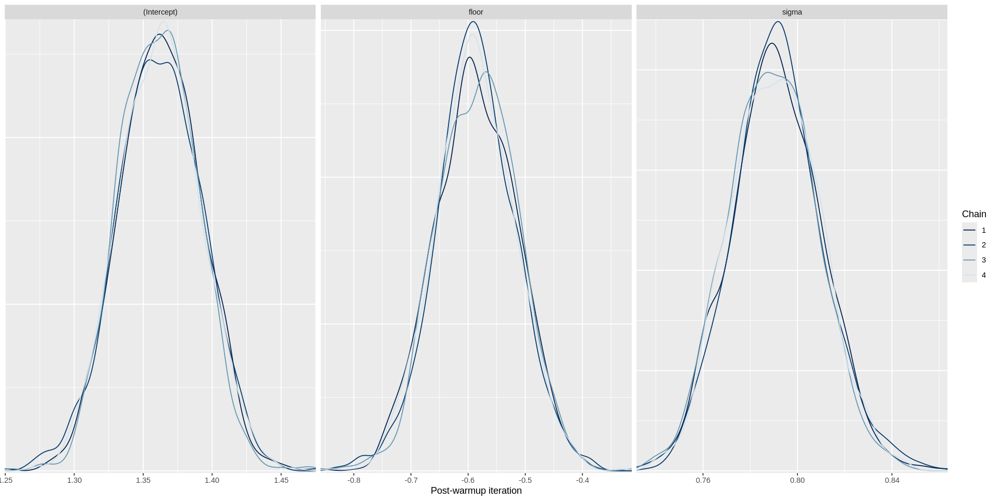

In [ ]:
options(repr.plot.width = 16, repr.plot.height = 8)
mcmc_dens_overlay(pooled_model) +
  xlab("Post-warmup iteration")

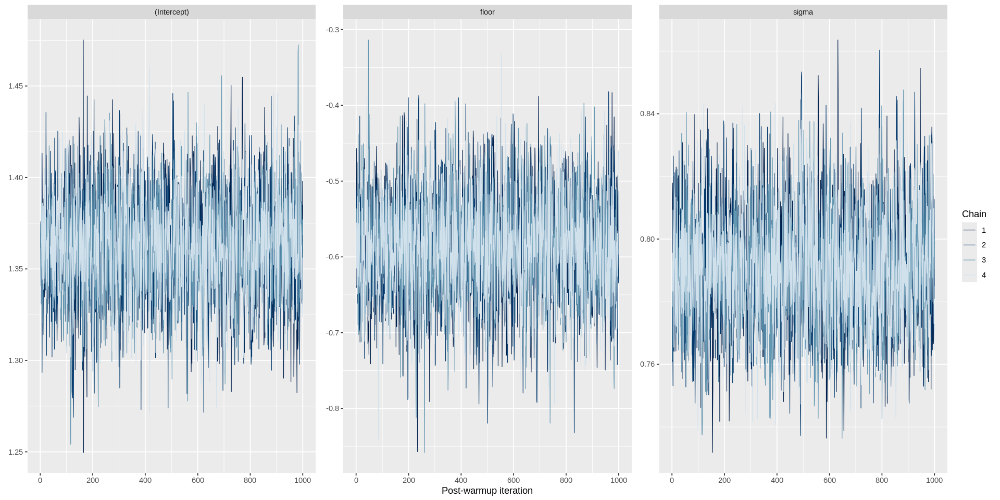

In [ ]:
options(repr.plot.width = 16, repr.plot.height = 8)
mcmc_trace(pooled_model) +
  xlab("Post-warmup iteration")

## Plot posterior distributions

The [posterior probability](https://en.wikipedia.org/wiki/Posterior_probability) is a type of [conditional probability](https://en.wikipedia.org/wiki/Conditional_probability) that results from [updating](https://en.wikipedia.org/wiki/Bayesian_updating) the [prior probability](https://en.wikipedia.org/wiki/Prior_probability) with information summarized by the [likelihood](https://en.wikipedia.org/wiki/Likelihood_function) via an application of [Bayes' rule](https://en.wikipedia.org/wiki/Bayes%27_rule).

Chapter 7 [The Posterior - The Goal of Bayesian
Inference](https://sites.math.rutgers.edu/~zeilberg/EM20/Lambert.pdf) in "A Student's Guide to Bayesian Statistics" by Ben Lambert

[`as.array` `as.matrix` `as.data.frame`](https://mc-stan.org/rstanarm/reference/as.matrix.stanreg.html): Extract the posterior sample. For models fit using MCMC (`algorithm="sampling"`), the posterior sample -the post-warmup draws from the posterior distribution- can be extracted from a fitted model object as a matrix, data frame, or array. The `as.matrix` and `as.data.frame` methods merge all chains together, whereas the `as.array` method keeps the chains separate.

[`pp_check`](https://mc-stan.org/bayesplot/reference/pp_check.html): Posterior (or prior) predictive checks (S3 generic and default method).

In [ ]:
post_pooled_model <- as.array(pooled_model)
dim(post_pooled_model)

[1] 1000    4    3

In [ ]:
dimnames(post_pooled_model)

$iterations
NULL

$chains
[1] "chain:1" "chain:2" "chain:3" "chain:4"

$parameters
[1] "(Intercept)" "floor"       "sigma"

In [ ]:
post_pooled_model <- as.matrix(pooled_model)
dim(post_pooled_model)

[1] 4000    3

In [ ]:
dimnames(post_pooled_model)

$iterations
NULL

$parameters
[1] "(Intercept)" "floor"       "sigma"

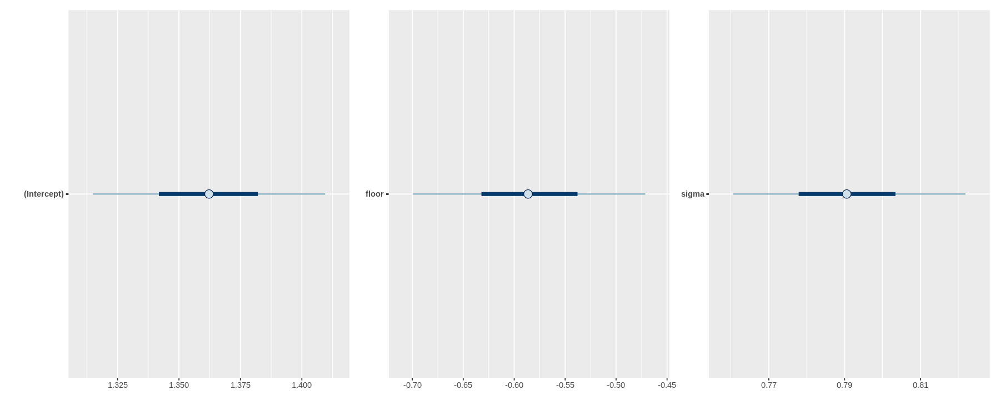

In [ ]:
options(repr.plot.width = 15, repr.plot.height = 6)
g1 <- mcmc_intervals(post_pooled_model, pars = c("(Intercept)"))
g2 <- mcmc_intervals(post_pooled_model, pars = c("floor"))
g3 <- mcmc_intervals(post_pooled_model, pars = c("sigma"))
g1 + g2 + g3

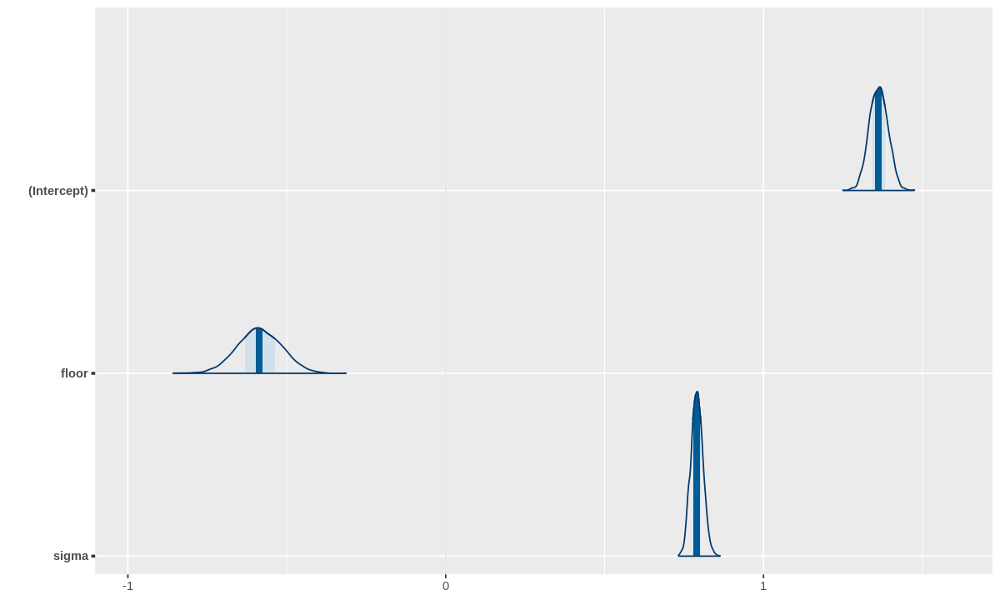

In [ ]:
options(repr.plot.width = 10, repr.plot.height = 6)
mcmc_areas(post_pooled_model)

`stat_bin()` using `bins = 30`. Pick better value `binwidth`.


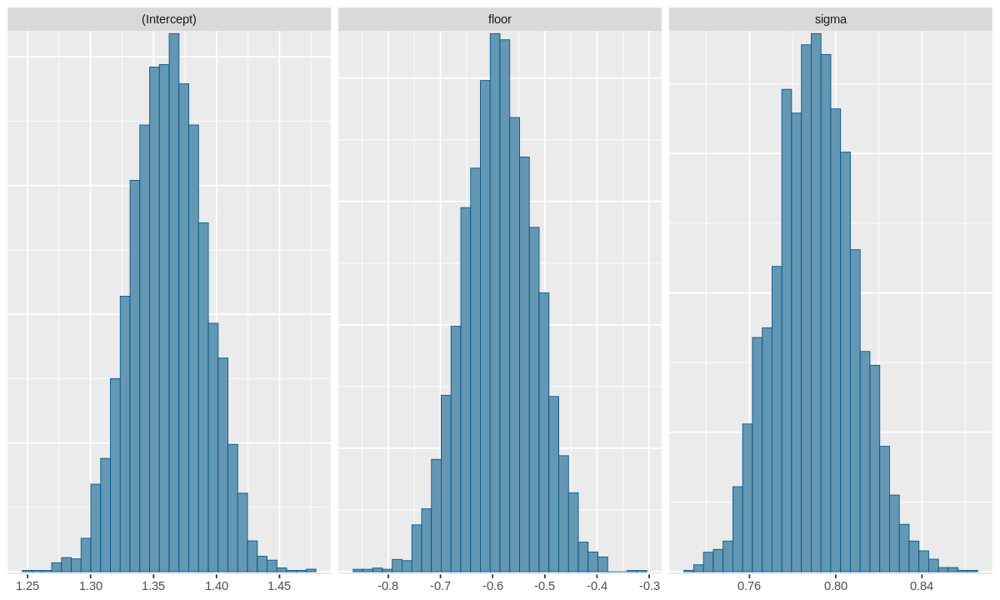

In [ ]:
options(repr.plot.width = 10, repr.plot.height = 6)
mcmc_hist(post_pooled_model)

Note: in most cases the default test statistic 'mean' is too weak to detect anything of interest.



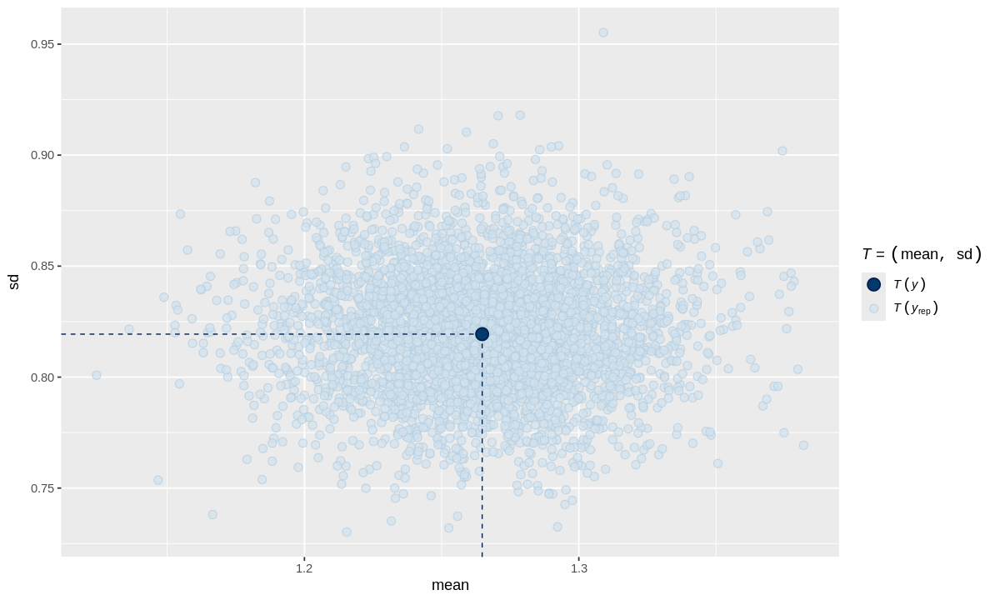

In [ ]:
pp_check(pooled_model, plotfun = "stat_2d", stat = c("mean", "sd"))

In [ ]:
print(pooled_model)

stan_glm
 family:       gaussian [identity]
 formula:      log_radon ~ floor
 observations: 919
 predictors:   2
------
            Median MAD_SD
(Intercept)  1.4    0.0  
floor       -0.6    0.1  

Auxiliary parameter(s):
      Median MAD_SD
sigma 0.8    0.0   

------
* For help interpreting the printed output see ?print.stanreg
* For info on the priors used see ?prior_summary.stanreg


## Plot posterior predictive distributions

[Posterior predictive checks (PPCs)](https://www.pymc.io/projects/docs/en/stable/learn/core_notebooks/posterior_predictive.html) are a great way to validate a model. The idea is to generate data from the model using parameters from draws from the posterior.

Elaborating slightly, one can say that PPCs analyze the degree to which data generated from the model deviate from data generated from the true distribution. So, often you will want to know if, for example, your posterior distribution is approximating your underlying distribution. The visualization aspect of this model evaluation method is also great for a 'sense check' or explaining your model to others and getting criticism.

[Graphical posterior predictive checks (PPCs)](https://mc-stan.org/bayesplot/articles/graphical-ppcs.html)

The `bayesplot` package provides various plotting functions for graphical posterior predictive checking, that is, creating graphical displays comparing observed data to simulated data from the posterior predictive distribution ([Gabry et al, 2019](https://mc-stan.org/bayesplot/articles/graphical-ppcs.html#gabry2019)).

The idea behind [posterior predictive checking](https://mc-stan.org/docs/stan-users-guide/posterior-prediction.html) is simple: if a model is a good fit then we should be able to use it to generate data that looks a lot like the data we observed. To generate the data used for posterior predictive checks (PPCs) we simulate from the posterior predictive distribution. This is the distribution of the outcome variable implied by a model after using the observed data 𝑦 (a vector of 𝑁 outcome values) to update our beliefs about unknown model parameters 𝜃.

[`posterior_predict`](https://mc-stan.org/rstanarm/reference/posterior_predict.stanreg.html): The posterior predictive distribution is the distribution of the outcome implied by the model after using the observed data to update our beliefs about the unknown parameters in the model. Simulating data from the posterior predictive distribution using the observed predictors is useful for checking the fit of the model. Drawing from the posterior predictive distribution at interesting values of the predictors also lets us visualize how a manipulation of a predictor affects (a function of) the outcome(s). With new observations of predictor variables we can use the posterior predictive distribution to generate predicted outcomes.

[`ppc_dens_overlay`](https://mc-stan.org/bayesplot/reference/PPD-distributions.html): Plot posterior or prior predictive distributions. Each of these functions makes the same plot as the corresponding `ppc_` function but without plotting any observed data `y`.

Note: in most cases the default test statistic 'mean' is too weak to detect anything of interest.

`stat_bin()` using `bins = 30`. Pick better value `binwidth`.


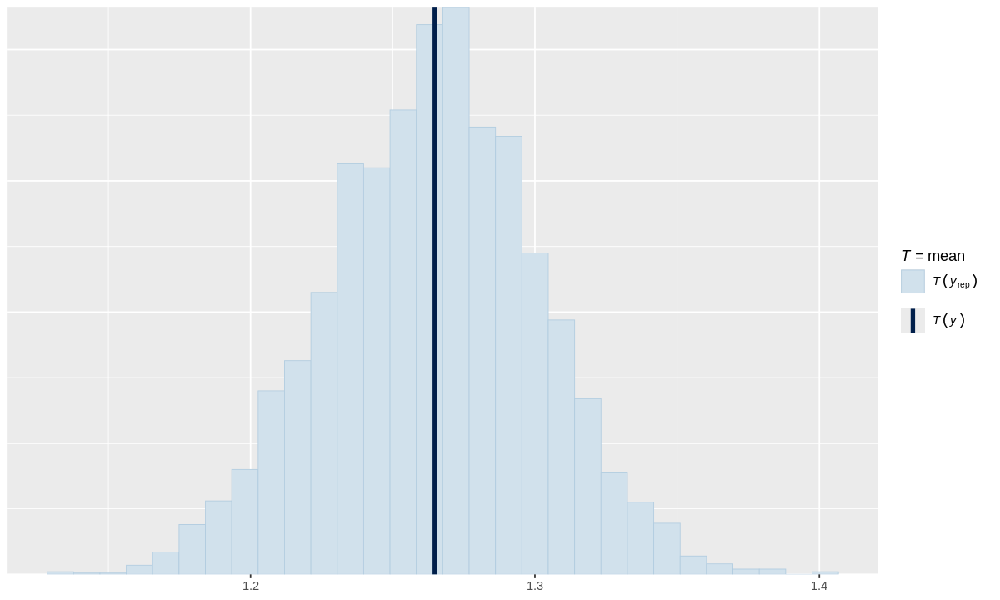

In [ ]:
options(repr.plot.width = 8, repr.plot.height = 6)
pp_check(pooled_model, plotfun = "stat", stat = "mean")

`stat_bin()` using `bins = 30`. Pick better value `binwidth`.


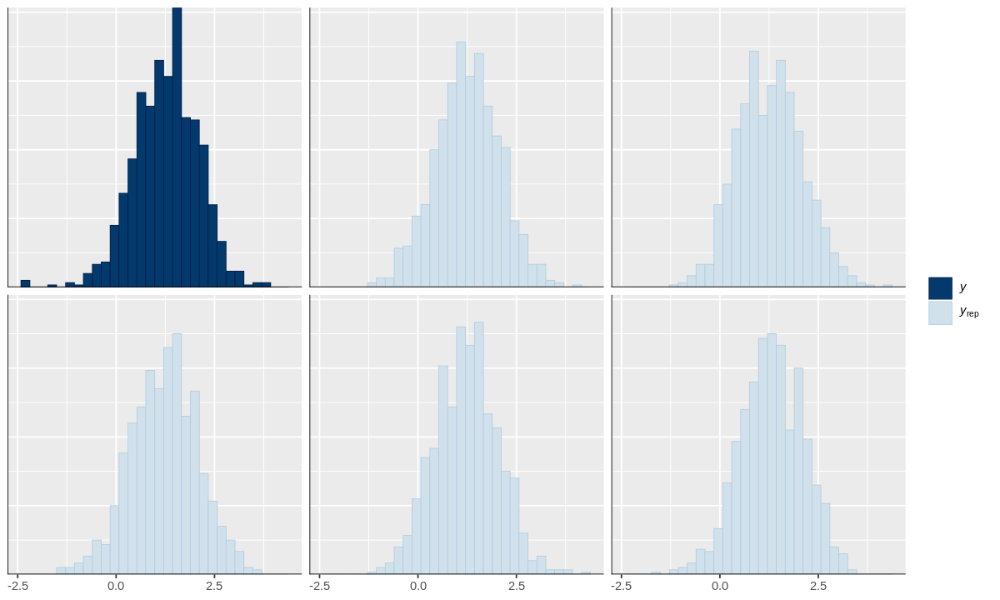

In [ ]:
options(repr.plot.width = 10, repr.plot.height = 6)
pp_check(pooled_model, plotfun = "hist", nreps = 5)

In [ ]:
y <- radon$log_radon

In [ ]:
yrep_pooled <- posterior_predict(pooled_model, draws = 500)
dim(yrep_pooled)

[1] 500 919

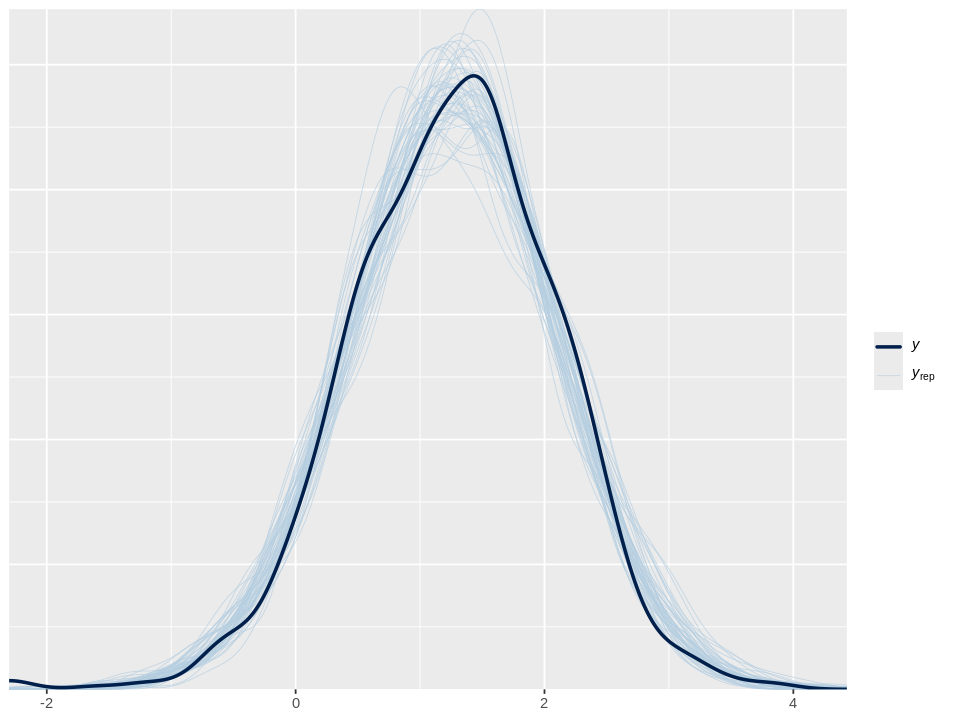

In [ ]:
options(repr.plot.width = 8, repr.plot.height = 6)
ppc_dens_overlay(y, yrep_pooled[1:50, ])

[loo](https://mc-stan.org/loo/index.html): Efficient approximate leave-one-out cross-validation for fitted Bayesian models

From existing posterior simulation draws, we compute approximate `LOO-CV` using Pareto smoothed importance sampling (`PSIS`), a new procedure for regularizing importance weights. As a byproduct of our calculations, we also obtain approximate standard errors for estimated predictive errors and for comparing predictive errors between two models. We recommend `PSIS-LOO-CV` instead of `WAIC`, because `PSIS` provides useful diagnostics and effective sample size and Monte Carlo standard error estimates.

[`loo`](https://mc-stan.org/rstanarm/reference/loo.stanreg.html): For models fit using MCMC, compute approximate leave-one-out cross-validation (`LOO`, `LOOIC`) or, less preferably, the Widely Applicable Information Criterion (`WAIC`) using the loo package. (For 𝐾-fold cross-validation see `kfold.stanreg`.) Functions for model comparison, and model weighting/averaging are also provided.

Estimates the expected log pointwise predictive density (elpd) using Pareto-smoothed importance sampling leave-one-out cross-validation (PSIS-LOO-CV). Also calculates LOO's standard error and the effective number of parameters. Read more theory here https://arxiv.org/abs/1507.04544 and here https://arxiv.org/abs/1507.02646

In [ ]:
loo_pooled = loo(pooled_model)
loo_pooled


Computed from 4000 by 919 log-likelihood matrix.

         Estimate   SE
elpd_loo  -1089.9 25.0
p_loo         3.8  0.4
looic      2179.8 50.1
------
MCSE of elpd_loo is 0.0.
MCSE and ESS estimates assume independent draws (r_eff=1).

All Pareto k estimates are good (k < 0.7).
See help('pareto-k-diagnostic') for details.

[LOO package glossary](https://mc-stan.org/loo/reference/loo-glossary.html)

`elpd`: approximated expected log pointwise predictive density (elpd).

`se`: standard error of the elpd.

`p_loo`: effective number of parameters. If we have a well-specified model, we expect the estimated effective number of parameters (`p_loo`) to be smaller than or similar to the total number of parameters in the model.

Pareto 𝑘 diagnostic values are used to assess the reliability of the estimates. In addition to the proportion of leave-one-out folds with 𝑘 values in different intervals, the minimum of the effective sample sizes in that category is shown to give idea why higher 𝑘 values are bad.

---

## **No pooling** with predictors

In [ ]:
unpooled_model <- stan_glm(
  formula = log_radon ~ 0 + floor + county,
  data = radon,
  refresh=0
)

unpooled_model

stan_glm
 family:       gaussian [identity]
 formula:      log_radon ~ 0 + floor + county
 observations: 919
 predictors:   86
------
                        Median MAD_SD
floor                   -0.7    0.1  
countyAITKIN             0.9    0.4  
countyANOKA              0.9    0.1  
countyBECKER             1.5    0.4  
countyBELTRAMI           1.6    0.3  
countyBENTON             1.5    0.4  
countyBIG STONE          1.5    0.4  
countyBLUE EARTH         2.0    0.2  
countyBROWN              2.0    0.4  
countyCARLTON            1.0    0.2  
countyCARVER             1.6    0.3  
countyCASS               1.4    0.3  
countyCHIPPEWA           1.8    0.4  
countyCHISAGO            1.1    0.3  
countyCLAY               2.0    0.2  
countyCLEARWATER         1.4    0.4  
countyCOOK               0.7    0.5  
countyCOTTONWOOD         1.3    0.4  
countyCROW WING          1.2    0.2  
countyDAKOTA             1.4    0.1  
countyDODGE              1.8    0.4  
countyDOUGLAS            1.7  

## Plot prior parameter distributions

[Prior Choice Recommendations](https://github.com/stan-dev/stan/wiki/Prior-Choice-Recommendations)

1. Flat prior (not usually recommended).

2. Super-vague but proper prior: normal(0, 1e6) (not usually recommended).

3. Weakly informative prior, very weak: normal(0, 10).

4. Generic weakly informative prior: normal(0, 1).

5. Specific informative prior: normal(0.4, 0.2) or whatever. Sometimes this can be expressed as a scaling followed by a generic prior: theta = 0.4 + 0.2*z ; z ~ normal(0, 1).

The above numbers assume that parameters are roughly on unit scale, as is done in education (where 0 is average test score in some standard population (e.g., all students at a certain grade level) and 1 is sd of test scores in that population) or medicine (where 0 is zero dose and 1 is a standard dose such as 10mcg/day of cyanocobalamin, 1,000 IU/day cholecalciferol, etc.; these examples come from Sander Greenland).

In addition, statements such as "informative" or "weakly informative" depend crucially on what questions are being asked (a point that is related to the idea that [the prior can often only be understood in the context of the likelihood](http://www.stat.columbia.edu/~gelman/research/published/entropy-19-00555-v2.pdf)).

[Default (Weakly Informative) Prior Distributions](https://mc-stan.org/rstanarm/articles/priors.html)

With very few exceptions, the default priors in [`rstanarm`](https://mc-stan.org/rstanarm/articles/priors.html) —the priors used if they aren't specified— are not flat priors. Rather, the defaults are intended to be weakly informative. That is, they are designed to provide moderate regularization and help stabilize computation. For many (if not most) applications the defaults will perform well, but this is not guaranteed (there are no default priors that make sense for every possible model specification).

[Prior predictive checks](https://www.pymc.io/projects/docs/en/stable/learn/core_notebooks/posterior_predictive.html) are also a crucial part of the Bayesian modeling workflow. Basically, they have two main benefits:

* They allow you to check whether you are indeed incorporating scientific knowledge into your model - in short, they help you check how credible your assumptions before seeing the data are.

* They can help sampling considerably, especially for generalized linear models, where the outcome space and the parameter space diverge because of the link function.

[`prior_summary`](https://mc-stan.org/rstanarm/reference/prior_summary.stanreg.html): Summarize the priors used for an [`rstanarm`](https://mc-stan.org/rstanarm/articles/priors.html) model.

In [ ]:
prior_summary(unpooled_model)

Priors for model 'unpooled_model' 
------

Coefficients
  Specified prior:
    ~ normal(location = [0,0,0,...], scale = [2.5,2.5,2.5,...])
  Adjusted prior:
    ~ normal(location = [0,0,0,...], scale = [ 5.50,31.10, 8.86,...])

Auxiliary (sigma)
  Specified prior:
    ~ exponential(rate = 1)
  Adjusted prior:
    ~ exponential(rate = 1.2)
------
See help('prior_summary.stanreg') for more details

## Fit model

[Fit](https://mc-stan.org/rstanarm/reference/stan_glm.html) the model using Stan.

`formula`, `data`, `subset`: Same as [glm](https://rdrr.io/r/stats/glm.html), but *we strongly advise against omitting the `data` argument*. Unless data is specified (and is a data frame) many post-estimation functions (including `update`, `loo`, `kfold`) are not guaranteed to work properly.

`iter`: The number of samples to draw from the posterior distribution. By default, all `rstanarm` modeling functions will run **four** randomly initialized Markov chains, each for `2000` iterations (including a warmup period of `1000` iterations that is discarded).

`chains`: The number of chains to sample. Running independent chains is important for some convergence statistics and can also reveal multiple modes in the posterior. By default, all `rstanarm` modeling functions will run **four** randomly initialized Markov chains, each for `2000` iterations (including a warmup period of `1000` iterations that is discarded).

`algorithm`: A string (possibly abbreviated) indicating the estimation approach to use. Can be `"sampling"` for MCMC (the **default**), `"optimizing"` for optimization, `"meanfield"` for variational inference with independent normal distributions, or `"fullrank"` for variational inference with a multivariate normal distribution. See [rstanarm-package](https://mc-stan.org/rstanarm/reference/rstanarm-package.html) for more details on the estimation algorithms.

[Markov Chain Monte Carlo (MCMC)](https://bookdown.org/content/4857/markov-chain-monte-carlo.html): This chapter introduces one commonplace example of [Fortuna](https://en.wikipedia.org/wiki/Rota_Fortunae#/media/File:Lydgate-siege-troy-wheel-fortune-detail.jpg) and [Minerva](https://en.wikipedia.org/wiki/Minerva#/media/File:Minerva-Vedder-Highsmith-detail-1.jpeg)'s cooperation: the estimation of posterior probability distributions using a stochastic process known as **Markov chain Monte Carlo (MCMC)** ([McElreath, 2020a, p. 263](https://bookdown.org/content/4857/markov-chain-monte-carlo.html#ref-mcelreathStatisticalRethinkingBayesian2020), **emphasis** in the original).

In [ ]:
unpooled_model <- stan_glm(
  formula = log_radon ~ 0 + floor + county,
  data = radon,
  refresh=0
)

unpooled_model

stan_glm
 family:       gaussian [identity]
 formula:      log_radon ~ 0 + floor + county
 observations: 919
 predictors:   86
------
                        Median MAD_SD
floor                   -0.7    0.1  
countyAITKIN             0.9    0.4  
countyANOKA              0.9    0.1  
countyBECKER             1.5    0.4  
countyBELTRAMI           1.6    0.3  
countyBENTON             1.5    0.4  
countyBIG STONE          1.5    0.4  
countyBLUE EARTH         2.0    0.2  
countyBROWN              2.0    0.4  
countyCARLTON            1.0    0.2  
countyCARVER             1.6    0.3  
countyCASS               1.4    0.3  
countyCHIPPEWA           1.8    0.3  
countyCHISAGO            1.1    0.3  
countyCLAY               2.0    0.2  
countyCLEARWATER         1.4    0.4  
countyCOOK               0.7    0.5  
countyCOTTONWOOD         1.3    0.4  
countyCROW WING          1.2    0.2  
countyDAKOTA             1.4    0.1  
countyDODGE              1.8    0.4  
countyDOUGLAS            1.8  

In [ ]:
summary(unpooled_model)


Model Info:
 function:     stan_glm
 family:       gaussian [identity]
 formula:      log_radon ~ 0 + floor + county
 algorithm:    sampling
 sample:       4000 (posterior sample size)
 priors:       see help('prior_summary')
 observations: 919
 predictors:   86

Estimates:
                          mean   sd   10%   50%   90%
floor                   -0.7    0.1 -0.8  -0.7  -0.6 
countyAITKIN             0.9    0.4  0.4   0.9   1.3 
countyANOKA              0.9    0.1  0.8   0.9   1.1 
countyBECKER             1.5    0.4  1.0   1.5   2.1 
countyBELTRAMI           1.6    0.3  1.2   1.6   2.0 
countyBENTON             1.5    0.4  1.0   1.5   1.9 
countyBIG STONE          1.5    0.4  1.0   1.5   2.1 
countyBLUE EARTH         2.0    0.2  1.8   2.0   2.3 
countyBROWN              2.0    0.4  1.5   2.0   2.5 
countyCARLTON            1.0    0.2  0.8   1.0   1.3 
countyCARVER             1.6    0.3  1.2   1.6   2.0 
countyCASS               1.4    0.3  1.0   1.4   1.8 
countyCHIPPEWA        

[Fitted model objects](https://mc-stan.org/rstanarm/reference/stanreg-objects.html)

The `rstanarm` model-fitting functions return an object of class `'stanreg'`, which is a list containing at a minimum the components listed below. Each stanreg object will also have additional classes (e.g. `'aov'`, `'betareg'`, `'glm'`, `'polr'`, etc.) and several additional components depending on the model and estimation algorithm.

[`summary`](https://mc-stan.org/rstanarm/reference/summary.stanreg.html): Summary method for stanreg objects. Summaries of parameter estimates and MCMC convergence diagnostics (Monte Carlo error, effective sample size, Rhat).

[Reference](https://mc-stan.org/rstanarm/reference/index.html)

* About `rstanarm`

* Fitting models

* Methods

* Additional documentation

## Plot MCMC diagnostics

[`mcmc_neff`](https://mc-stan.org/bayesplot/reference/MCMC-diagnostics.html): Ratios of effective sample size to total sample size as either points or a histogram. Values are colored using different shades (lighter is better). The chosen thresholds are somewhat arbitrary, but can be useful guidelines in practice.

[`mcmc_rhat`](https://mc-stan.org/bayesplot/reference/MCMC-diagnostics.html): [`R-hat`](https://mc-stan.org/bayesplot/articles/visual-mcmc-diagnostics.html#rhat-potential-scale-reduction-statistic) values as either points or a histogram. Values are colored using different shades (lighter is better). The chosen thresholds are somewhat arbitrary, but can be useful guidelines in practice.

[`mcmc_dens_overlay`](https://mc-stan.org/bayesplot/reference/MCMC-diagnostics.html): Various [types](https://mc-stan.org/bayesplot/reference/MCMC-distributions.html) of histograms and kernel density plots of MCMC draws.

[`mcmc_trace`](https://python.arviz.org/en/stable/examples/plot_trace.html): Trace and rank [plots](https://mc-stan.org/bayesplot/reference/MCMC-traces.html) of MCMC draws.

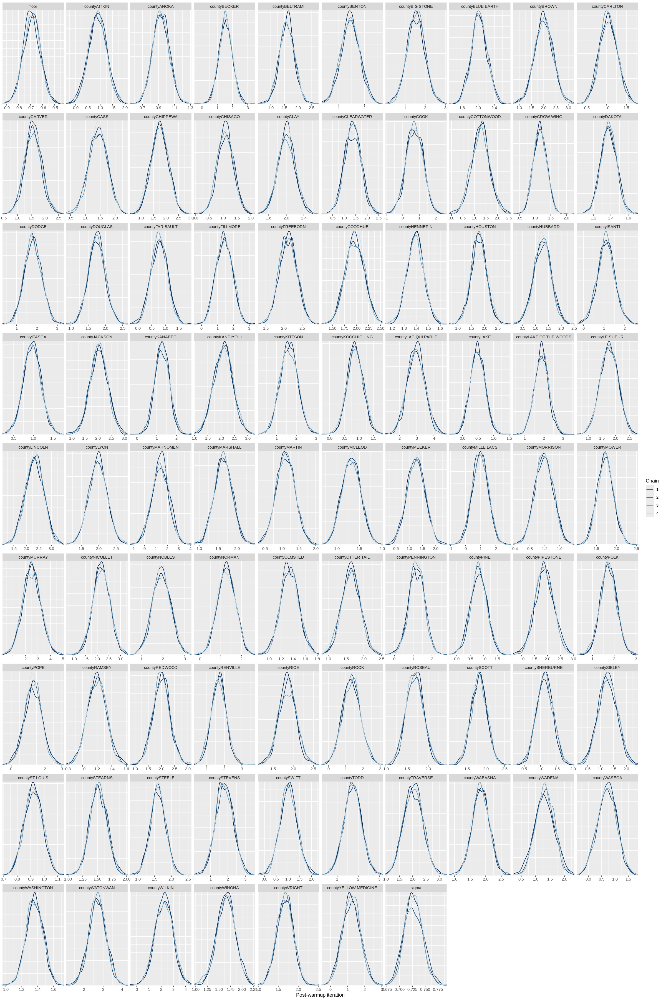

In [ ]:
options(repr.plot.width = 20, repr.plot.height = 30)
mcmc_dens_overlay(unpooled_model) +
  xlab("Post-warmup iteration")

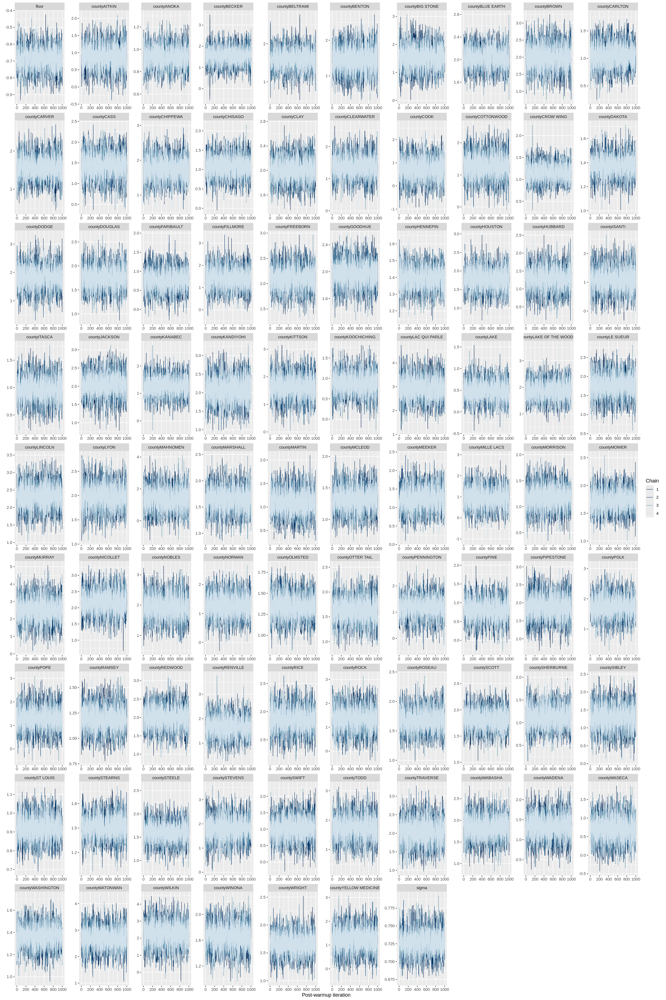

In [ ]:
options(repr.plot.width = 20, repr.plot.height = 30)
mcmc_trace(unpooled_model) +
  xlab("Post-warmup iteration")

## Plot posterior distributions

The [posterior probability](https://en.wikipedia.org/wiki/Posterior_probability) is a type of [conditional probability](https://en.wikipedia.org/wiki/Conditional_probability) that results from [updating](https://en.wikipedia.org/wiki/Bayesian_updating) the [prior probability](https://en.wikipedia.org/wiki/Prior_probability) with information summarized by the [likelihood](https://en.wikipedia.org/wiki/Likelihood_function) via an application of [Bayes' rule](https://en.wikipedia.org/wiki/Bayes%27_rule).

Chapter 7 [The Posterior - The Goal of Bayesian
Inference](https://sites.math.rutgers.edu/~zeilberg/EM20/Lambert.pdf) in "A Student's Guide to Bayesian Statistics" by Ben Lambert

[`as.array` `as.matrix` `as.data.frame`](https://mc-stan.org/rstanarm/reference/as.matrix.stanreg.html): Extract the posterior sample. For models fit using MCMC (`algorithm="sampling"`), the posterior sample -the post-warmup draws from the posterior distribution- can be extracted from a fitted model object as a matrix, data frame, or array. The `as.matrix` and `as.data.frame` methods merge all chains together, whereas the `as.array` method keeps the chains separate.

[`pp_check`](https://mc-stan.org/bayesplot/reference/pp_check.html): Posterior (or prior) predictive checks (S3 generic and default method).

In [ ]:
post_unpooled_model <- as.array(unpooled_model)
dim(post_unpooled_model)

[1] 1000    4   87

In [ ]:
dimnames(post_unpooled_model)

$iterations
NULL

$chains
[1] "chain:1" "chain:2" "chain:3" "chain:4"

$parameters
 [1] "floor"                   "countyAITKIN"           
 [3] "countyANOKA"             "countyBECKER"           
 [5] "countyBELTRAMI"          "countyBENTON"           
 [7] "countyBIG STONE"         "countyBLUE EARTH"       
 [9] "countyBROWN"             "countyCARLTON"          
[11] "countyCARVER"            "countyCASS"             
[13] "countyCHIPPEWA"          "countyCHISAGO"          
[15] "countyCLAY"              "countyCLEARWATER"       
[17] "countyCOOK"              "countyCOTTONWOOD"       
[19] "countyCROW WING"         "countyDAKOTA"           
[21] "countyDODGE"             "countyDOUGLAS"          
[23] "countyFARIBAULT"         "countyFILLMORE"         
[25] "countyFREEBORN"          "countyGOODHUE"          
[27] "countyHENNEPIN"          "countyHOUSTON"          
[29] "countyHUBBARD"           "countyISANTI"           
[31] "countyITASCA"            "countyJACKSON"          
[33] "countyKANABEC"           "countyKANDIYOHI"        
[35] "countyKITTSON"           "countyKOOCHICHING"      
[37] "countyLAC QUI PARLE"     "countyLAKE"             
[39] "countyLAKE OF THE WOODS" "countyLE SUEUR"         
[41] "countyLINCOLN"           "countyLYON"             
[43] "countyMAHNOMEN"          "countyMARSHALL"         
[45] "countyMARTIN"            "countyMCLEOD"           
[47] "countyMEEKER"            "countyMILLE LACS"       
[49] "countyMORRISON"          "countyMOWER"            
[51] "countyMURRAY"            "countyNICOLLET"         
[53] "countyNOBLES"            "countyNORMAN"           
[55] "countyOLMSTED"           "countyOTTER TAIL"       
[57] "countyPENNINGTON"        "countyPINE"             
[59] "countyPIPESTONE"         "countyPOLK"             
[61] "countyPOPE"              "countyRAMSEY"           
[63] "countyREDWOOD"           "countyRENVILLE"         
[65] "countyRICE"              "countyROCK"             
[67] "countyROSEAU"            "countySCOTT"            
[69] "countySHERBURNE"         "countySIBLEY"           
[71] "countyST LOUIS"          "countySTEARNS"          
[73] "countySTEELE"            "countySTEVENS"          
[75] "countySWIFT"             "countyTODD"             
[77] "countyTRAVERSE"          "countyWABASHA"          
[79] "countyWADENA"            "countyWASECA"           
[81] "countyWASHINGTON"        "countyWATONWAN"         
[83] "countyWILKIN"            "countyWINONA"           
[85] "countyWRIGHT"            "countyYELLOW MEDICINE"  
[87] "sigma"

In [ ]:
post_unpooled_model <- as.matrix(unpooled_model)
dim(post_unpooled_model)

[1] 4000   87

In [ ]:
dimnames(post_unpooled_model)

$iterations
NULL

$parameters
 [1] "floor"                   "countyAITKIN"           
 [3] "countyANOKA"             "countyBECKER"           
 [5] "countyBELTRAMI"          "countyBENTON"           
 [7] "countyBIG STONE"         "countyBLUE EARTH"       
 [9] "countyBROWN"             "countyCARLTON"          
[11] "countyCARVER"            "countyCASS"             
[13] "countyCHIPPEWA"          "countyCHISAGO"          
[15] "countyCLAY"              "countyCLEARWATER"       
[17] "countyCOOK"              "countyCOTTONWOOD"       
[19] "countyCROW WING"         "countyDAKOTA"           
[21] "countyDODGE"             "countyDOUGLAS"          
[23] "countyFARIBAULT"         "countyFILLMORE"         
[25] "countyFREEBORN"          "countyGOODHUE"          
[27] "countyHENNEPIN"          "countyHOUSTON"          
[29] "countyHUBBARD"           "countyISANTI"           
[31] "countyITASCA"            "countyJACKSON"          
[33] "countyKANABEC"           "countyKANDIYOHI"        
[35] "countyKITTSON"           "countyKOOCHICHING"      
[37] "countyLAC QUI PARLE"     "countyLAKE"             
[39] "countyLAKE OF THE WOODS" "countyLE SUEUR"         
[41] "countyLINCOLN"           "countyLYON"             
[43] "countyMAHNOMEN"          "countyMARSHALL"         
[45] "countyMARTIN"            "countyMCLEOD"           
[47] "countyMEEKER"            "countyMILLE LACS"       
[49] "countyMORRISON"          "countyMOWER"            
[51] "countyMURRAY"            "countyNICOLLET"         
[53] "countyNOBLES"            "countyNORMAN"           
[55] "countyOLMSTED"           "countyOTTER TAIL"       
[57] "countyPENNINGTON"        "countyPINE"             
[59] "countyPIPESTONE"         "countyPOLK"             
[61] "countyPOPE"              "countyRAMSEY"           
[63] "countyREDWOOD"           "countyRENVILLE"         
[65] "countyRICE"              "countyROCK"             
[67] "countyROSEAU"            "countySCOTT"            
[69] "countySHERBURNE"         "countySIBLEY"           
[71] "countyST LOUIS"          "countySTEARNS"          
[73] "countySTEELE"            "countySTEVENS"          
[75] "countySWIFT"             "countyTODD"             
[77] "countyTRAVERSE"          "countyWABASHA"          
[79] "countyWADENA"            "countyWASECA"           
[81] "countyWASHINGTON"        "countyWATONWAN"         
[83] "countyWILKIN"            "countyWINONA"           
[85] "countyWRIGHT"            "countyYELLOW MEDICINE"  
[87] "sigma"

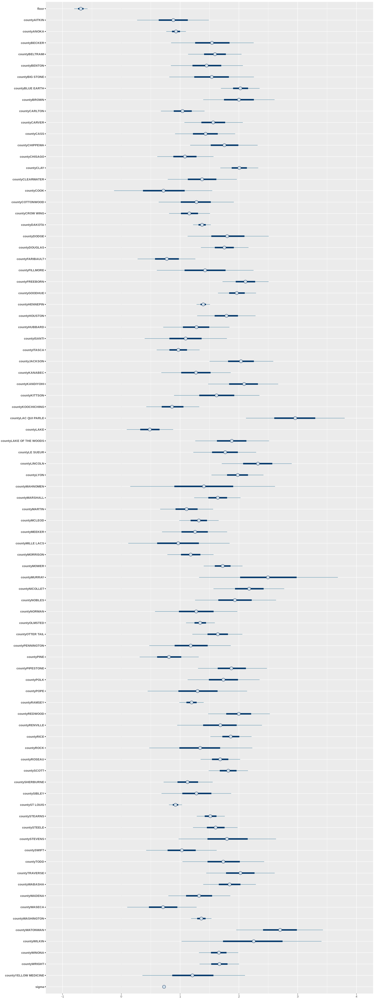

In [ ]:
options(repr.plot.width = 15, repr.plot.height = 40)
mcmc_intervals(post_unpooled_model)
# g1 <- mcmc_intervals(post_unpooled_model, pars = c("(Intercept)"))
# g2 <- mcmc_intervals(post_unpooled_model, pars = c("sigma"))
# g1 + g2

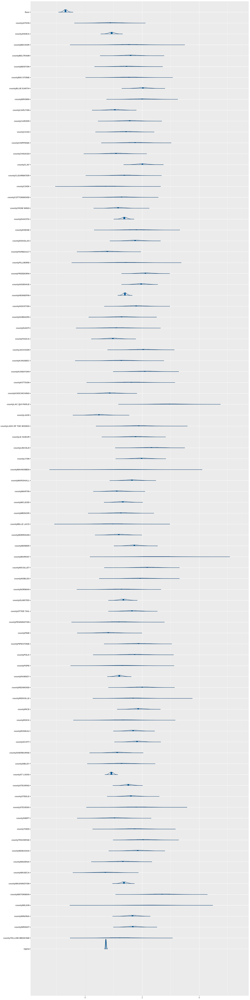

In [ ]:
options(repr.plot.width = 15, repr.plot.height = 60)
mcmc_areas(post_unpooled_model)

`stat_bin()` using `bins = 30`. Pick better value `binwidth`.


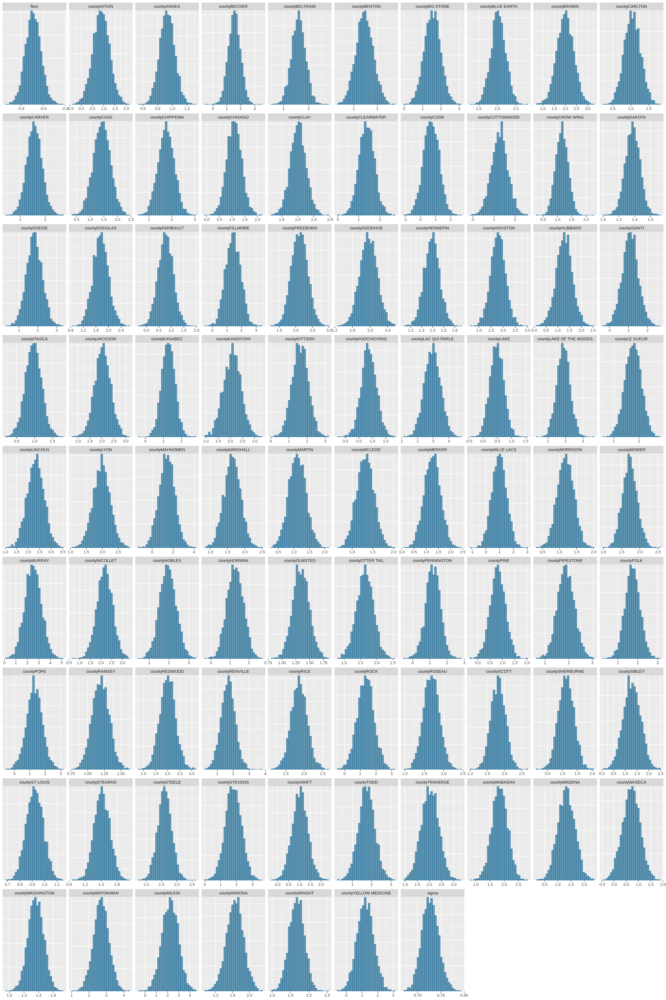

In [ ]:
options(repr.plot.width = 20, repr.plot.height = 30)
mcmc_hist(post_unpooled_model)

In [ ]:
print(unpooled_model)

stan_glm
 family:       gaussian [identity]
 formula:      log_radon ~ 0 + floor + county
 observations: 919
 predictors:   86
------
                        Median MAD_SD
floor                   -0.7    0.1  
countyAITKIN             0.9    0.4  
countyANOKA              0.9    0.1  
countyBECKER             1.5    0.4  
countyBELTRAMI           1.6    0.3  
countyBENTON             1.5    0.4  
countyBIG STONE          1.5    0.4  
countyBLUE EARTH         2.0    0.2  
countyBROWN              2.0    0.4  
countyCARLTON            1.0    0.2  
countyCARVER             1.6    0.3  
countyCASS               1.4    0.3  
countyCHIPPEWA           1.8    0.3  
countyCHISAGO            1.1    0.3  
countyCLAY               2.0    0.2  
countyCLEARWATER         1.4    0.4  
countyCOOK               0.7    0.5  
countyCOTTONWOOD         1.3    0.4  
countyCROW WING          1.2    0.2  
countyDAKOTA             1.4    0.1  
countyDODGE              1.8    0.4  
countyDOUGLAS            1.8  

## Plot posterior predictive distributions

[Posterior predictive checks (PPCs)](https://www.pymc.io/projects/docs/en/stable/learn/core_notebooks/posterior_predictive.html) are a great way to validate a model. The idea is to generate data from the model using parameters from draws from the posterior.

Elaborating slightly, one can say that PPCs analyze the degree to which data generated from the model deviate from data generated from the true distribution. So, often you will want to know if, for example, your posterior distribution is approximating your underlying distribution. The visualization aspect of this model evaluation method is also great for a 'sense check' or explaining your model to others and getting criticism.

[Graphical posterior predictive checks (PPCs)](https://mc-stan.org/bayesplot/articles/graphical-ppcs.html)

The `bayesplot` package provides various plotting functions for graphical posterior predictive checking, that is, creating graphical displays comparing observed data to simulated data from the posterior predictive distribution ([Gabry et al, 2019](https://mc-stan.org/bayesplot/articles/graphical-ppcs.html#gabry2019)).

The idea behind [posterior predictive checking](https://mc-stan.org/docs/stan-users-guide/posterior-prediction.html) is simple: if a model is a good fit then we should be able to use it to generate data that looks a lot like the data we observed. To generate the data used for posterior predictive checks (PPCs) we simulate from the posterior predictive distribution. This is the distribution of the outcome variable implied by a model after using the observed data 𝑦 (a vector of 𝑁 outcome values) to update our beliefs about unknown model parameters 𝜃.

[`posterior_predict`](https://mc-stan.org/rstanarm/reference/posterior_predict.stanreg.html): The posterior predictive distribution is the distribution of the outcome implied by the model after using the observed data to update our beliefs about the unknown parameters in the model. Simulating data from the posterior predictive distribution using the observed predictors is useful for checking the fit of the model. Drawing from the posterior predictive distribution at interesting values of the predictors also lets us visualize how a manipulation of a predictor affects (a function of) the outcome(s). With new observations of predictor variables we can use the posterior predictive distribution to generate predicted outcomes.

[`ppc_dens_overlay`](https://mc-stan.org/bayesplot/reference/PPD-distributions.html): Plot posterior or prior predictive distributions. Each of these functions makes the same plot as the corresponding `ppc_` function but without plotting any observed data `y`.

Note: in most cases the default test statistic 'mean' is too weak to detect anything of interest.

`stat_bin()` using `bins = 30`. Pick better value `binwidth`.


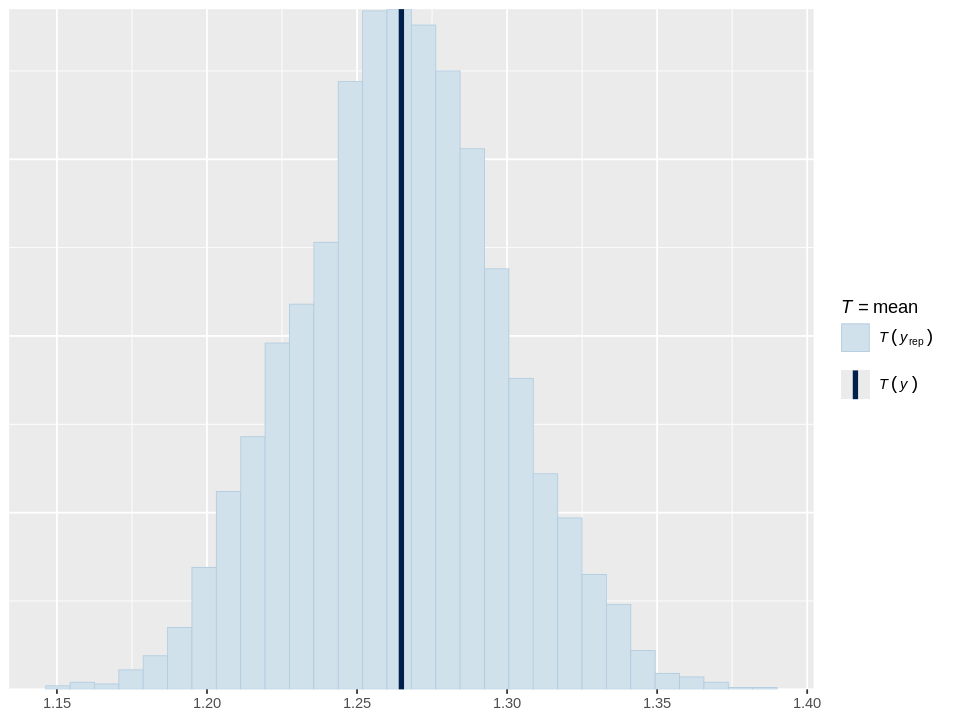

In [ ]:
options(repr.plot.width = 8, repr.plot.height = 6)
pp_check(unpooled_model, plotfun = "stat", stat = "mean")

`stat_bin()` using `bins = 30`. Pick better value `binwidth`.


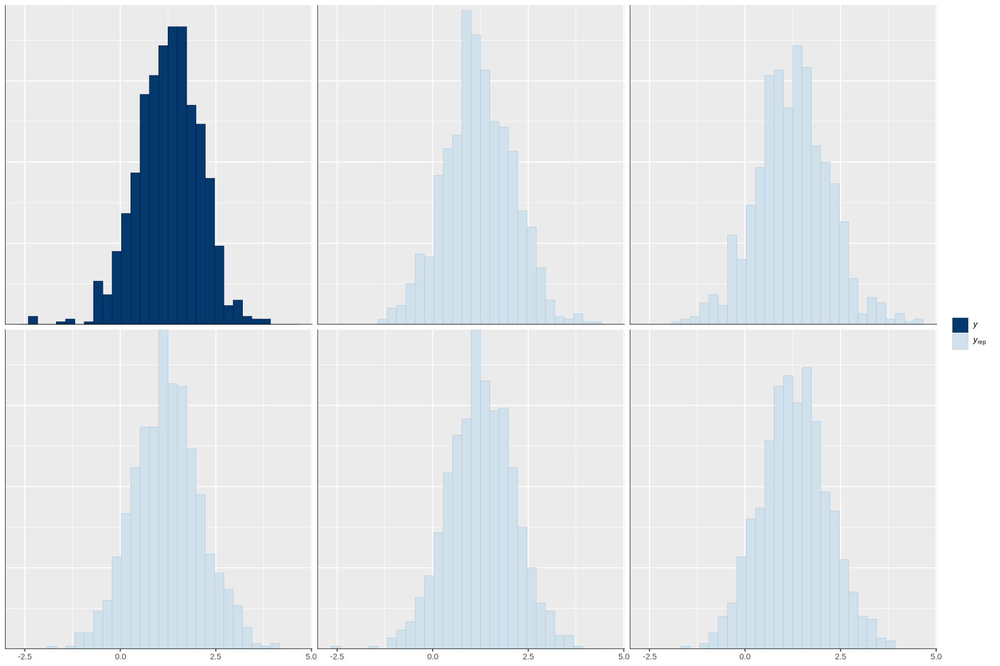

In [ ]:
options(repr.plot.width = 15, repr.plot.height = 10)
pp_check(unpooled_model, plotfun = "hist", nreps = 5)

In [ ]:
y <- radon$log_radon

In [ ]:
yrep_unpooled <- posterior_predict(unpooled_model, draws = 500)
dim(yrep_unpooled)

[1] 500 919

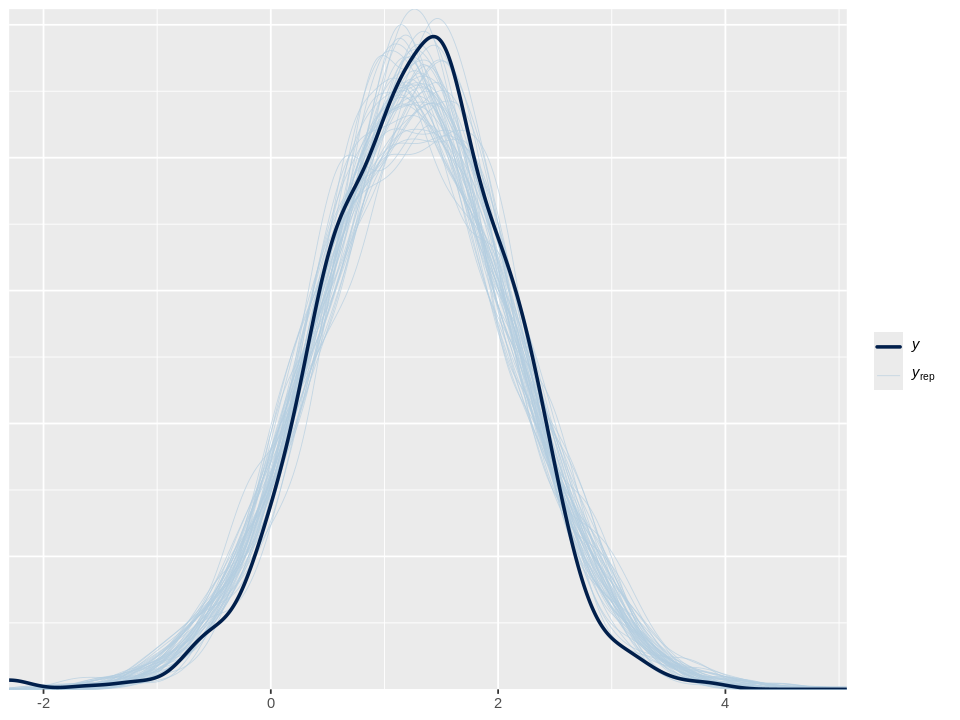

In [ ]:
options(repr.plot.width = 8, repr.plot.height = 6)
ppc_dens_overlay(y, yrep_unpooled[1:50, ])

[loo](https://mc-stan.org/loo/index.html): Efficient approximate leave-one-out cross-validation for fitted Bayesian models

From existing posterior simulation draws, we compute approximate `LOO-CV` using Pareto smoothed importance sampling (`PSIS`), a new procedure for regularizing importance weights. As a byproduct of our calculations, we also obtain approximate standard errors for estimated predictive errors and for comparing predictive errors between two models. We recommend `PSIS-LOO-CV` instead of `WAIC`, because `PSIS` provides useful diagnostics and effective sample size and Monte Carlo standard error estimates.

[`loo`](https://mc-stan.org/rstanarm/reference/loo.stanreg.html): For models fit using MCMC, compute approximate leave-one-out cross-validation (`LOO`, `LOOIC`) or, less preferably, the Widely Applicable Information Criterion (`WAIC`) using the loo package. (For 𝐾-fold cross-validation see `kfold.stanreg`.) Functions for model comparison, and model weighting/averaging are also provided.

Estimates the expected log pointwise predictive density (elpd) using Pareto-smoothed importance sampling leave-one-out cross-validation (PSIS-LOO-CV). Also calculates LOO's standard error and the effective number of parameters. Read more theory here https://arxiv.org/abs/1507.04544 and here https://arxiv.org/abs/1507.02646

In [ ]:
loo_unpooled = loo(unpooled_model)
loo_unpooled

Warning message:
“Found 8 observation(s) with a pareto_k > 0.7. We recommend calling 'loo' again with argument 'k_threshold = 0.7' in order to calculate the ELPD without the assumption that these observations are negligible. This will refit the model 8 times to compute the ELPDs for the problematic observations directly.
”



Computed from 4000 by 919 log-likelihood matrix.

         Estimate   SE
elpd_loo  -1063.4 28.6
p_loo        87.6  8.1
looic      2126.7 57.2
------
MCSE of elpd_loo is NA.
MCSE and ESS estimates assume independent draws (r_eff=1).

Pareto k diagnostic values:
                         Count Pct.    Min. ESS
(-Inf, 0.7]   (good)     911   99.1%   141     
   (0.7, 1]   (bad)        8    0.9%   <NA>    
   (1, Inf)   (very bad)   0    0.0%   <NA>    
See help('pareto-k-diagnostic') for details.

[LOO package glossary](https://mc-stan.org/loo/reference/loo-glossary.html)

`elpd`: approximated expected log pointwise predictive density (elpd).

`se`: standard error of the elpd.

`p_loo`: effective number of parameters. If we have a well-specified model, we expect the estimated effective number of parameters (`p_loo`) to be smaller than or similar to the total number of parameters in the model.

Pareto 𝑘 diagnostic values are used to assess the reliability of the estimates. In addition to the proportion of leave-one-out folds with 𝑘 values in different intervals, the minimum of the effective sample sizes in that category is shown to give idea why higher 𝑘 values are bad.

---

## **Partial pooling** without predictors

In [ ]:
partial_pooling_model <- stan_lmer(
  formula = log_radon ~ floor + (1 | county),
  data = radon,
  refresh=0
)

partial_pooling_model

stan_lmer
 family:       gaussian [identity]
 formula:      log_radon ~ floor + (1 | county)
 observations: 919
------
            Median MAD_SD
(Intercept)  1.5    0.0  
floor       -0.7    0.1  

Auxiliary parameter(s):
      Median MAD_SD
sigma 0.7    0.0   

Error terms:
 Groups   Name        Std.Dev.
 county   (Intercept) 0.32    
 Residual             0.73    
Num. levels: county 85 

------
* For help interpreting the printed output see ?print.stanreg
* For info on the priors used see ?prior_summary.stanreg

## Plot prior parameter distributions

[Prior Choice Recommendations](https://github.com/stan-dev/stan/wiki/Prior-Choice-Recommendations)

1. Flat prior (not usually recommended).

2. Super-vague but proper prior: normal(0, 1e6) (not usually recommended).

3. Weakly informative prior, very weak: normal(0, 10).

4. Generic weakly informative prior: normal(0, 1).

5. Specific informative prior: normal(0.4, 0.2) or whatever. Sometimes this can be expressed as a scaling followed by a generic prior: theta = 0.4 + 0.2*z ; z ~ normal(0, 1).

The above numbers assume that parameters are roughly on unit scale, as is done in education (where 0 is average test score in some standard population (e.g., all students at a certain grade level) and 1 is sd of test scores in that population) or medicine (where 0 is zero dose and 1 is a standard dose such as 10mcg/day of cyanocobalamin, 1,000 IU/day cholecalciferol, etc.; these examples come from Sander Greenland).

In addition, statements such as "informative" or "weakly informative" depend crucially on what questions are being asked (a point that is related to the idea that [the prior can often only be understood in the context of the likelihood](http://www.stat.columbia.edu/~gelman/research/published/entropy-19-00555-v2.pdf)).

[Default (Weakly Informative) Prior Distributions](https://mc-stan.org/rstanarm/articles/priors.html)

With very few exceptions, the default priors in [`rstanarm`](https://mc-stan.org/rstanarm/articles/priors.html) —the priors used if they aren't specified— are not flat priors. Rather, the defaults are intended to be weakly informative. That is, they are designed to provide moderate regularization and help stabilize computation. For many (if not most) applications the defaults will perform well, but this is not guaranteed (there are no default priors that make sense for every possible model specification).

[Prior predictive checks](https://www.pymc.io/projects/docs/en/stable/learn/core_notebooks/posterior_predictive.html) are also a crucial part of the Bayesian modeling workflow. Basically, they have two main benefits:

* They allow you to check whether you are indeed incorporating scientific knowledge into your model - in short, they help you check how credible your assumptions before seeing the data are.

* They can help sampling considerably, especially for generalized linear models, where the outcome space and the parameter space diverge because of the link function.

[`prior_summary`](https://mc-stan.org/rstanarm/reference/prior_summary.stanreg.html): Summarize the priors used for an [`rstanarm`](https://mc-stan.org/rstanarm/articles/priors.html) model.

In [ ]:
prior_summary(partial_pooling_model)

Priors for model 'partial_pooling_model' 
------
Intercept (after predictors centered)
  Specified prior:
    ~ normal(location = 1.3, scale = 2.5)
  Adjusted prior:
    ~ normal(location = 1.3, scale = 2)

Coefficients
  Specified prior:
    ~ normal(location = 0, scale = 2.5)
  Adjusted prior:
    ~ normal(location = 0, scale = 5.5)

Auxiliary (sigma)
  Specified prior:
    ~ exponential(rate = 1)
  Adjusted prior:
    ~ exponential(rate = 1.2)

Covariance
 ~ decov(reg. = 1, conc. = 1, shape = 1, scale = 1)
------
See help('prior_summary.stanreg') for more details

## Fit model

[Fit](https://mc-stan.org/rstanarm/reference/stan_glm.html) the model using Stan.

`formula`, `data`, `subset`: Same as [glm](https://rdrr.io/r/stats/glm.html), but *we strongly advise against omitting the `data` argument*. Unless data is specified (and is a data frame) many post-estimation functions (including `update`, `loo`, `kfold`) are not guaranteed to work properly.

`iter`: The number of samples to draw from the posterior distribution. By default, all `rstanarm` modeling functions will run **four** randomly initialized Markov chains, each for `2000` iterations (including a warmup period of `1000` iterations that is discarded).

`chains`: The number of chains to sample. Running independent chains is important for some convergence statistics and can also reveal multiple modes in the posterior. By default, all `rstanarm` modeling functions will run **four** randomly initialized Markov chains, each for `2000` iterations (including a warmup period of `1000` iterations that is discarded).

`algorithm`: A string (possibly abbreviated) indicating the estimation approach to use. Can be `"sampling"` for MCMC (the **default**), `"optimizing"` for optimization, `"meanfield"` for variational inference with independent normal distributions, or `"fullrank"` for variational inference with a multivariate normal distribution. See [rstanarm-package](https://mc-stan.org/rstanarm/reference/rstanarm-package.html) for more details on the estimation algorithms.

[Markov Chain Monte Carlo (MCMC)](https://bookdown.org/content/4857/markov-chain-monte-carlo.html): This chapter introduces one commonplace example of [Fortuna](https://en.wikipedia.org/wiki/Rota_Fortunae#/media/File:Lydgate-siege-troy-wheel-fortune-detail.jpg) and [Minerva](https://en.wikipedia.org/wiki/Minerva#/media/File:Minerva-Vedder-Highsmith-detail-1.jpeg)'s cooperation: the estimation of posterior probability distributions using a stochastic process known as **Markov chain Monte Carlo (MCMC)** ([McElreath, 2020a, p. 263](https://bookdown.org/content/4857/markov-chain-monte-carlo.html#ref-mcelreathStatisticalRethinkingBayesian2020), **emphasis** in the original).

In [ ]:
partial_pooling_model <- stan_lmer(
  formula = log_radon ~ floor + (1 | county),
  data = radon,
  refresh=0
)

partial_pooling_model

stan_lmer
 family:       gaussian [identity]
 formula:      log_radon ~ floor + (1 | county)
 observations: 919
------
            Median MAD_SD
(Intercept)  1.5    0.1  
floor       -0.7    0.1  

Auxiliary parameter(s):
      Median MAD_SD
sigma 0.7    0.0   

Error terms:
 Groups   Name        Std.Dev.
 county   (Intercept) 0.33    
 Residual             0.73    
Num. levels: county 85 

------
* For help interpreting the printed output see ?print.stanreg
* For info on the priors used see ?prior_summary.stanreg

In [ ]:
summary(partial_pooling_model)


Model Info:
 function:     stan_lmer
 family:       gaussian [identity]
 formula:      log_radon ~ floor + (1 | county)
 algorithm:    sampling
 sample:       4000 (posterior sample size)
 priors:       see help('prior_summary')
 observations: 919
 groups:       county (85)

Estimates:
                                          mean   sd   10%   50%   90%
(Intercept)                              1.5    0.1  1.4   1.5   1.6 
floor                                   -0.7    0.1 -0.8  -0.7  -0.6 
b[(Intercept) county:AITKIN]            -0.3    0.2 -0.6  -0.3   0.0 
b[(Intercept) county:ANOKA]             -0.5    0.1 -0.6  -0.5  -0.4 
b[(Intercept) county:BECKER]             0.0    0.3 -0.3   0.0   0.3 
b[(Intercept) county:BELTRAMI]           0.1    0.2 -0.2   0.1   0.3 
b[(Intercept) county:BENTON]             0.0    0.2 -0.3   0.0   0.3 
b[(Intercept) county:BIG_STONE]          0.0    0.3 -0.3   0.0   0.3 
b[(Intercept) county:BLUE_EARTH]         0.4    0.2  0.2   0.4   0.6 
b[(Intercept

[Fitted model objects](https://mc-stan.org/rstanarm/reference/stanreg-objects.html)

The `rstanarm` model-fitting functions return an object of class `'stanreg'`, which is a list containing at a minimum the components listed below. Each stanreg object will also have additional classes (e.g. `'aov'`, `'betareg'`, `'glm'`, `'polr'`, etc.) and several additional components depending on the model and estimation algorithm.

[`summary`](https://mc-stan.org/rstanarm/reference/summary.stanreg.html): Summary method for stanreg objects. Summaries of parameter estimates and MCMC convergence diagnostics (Monte Carlo error, effective sample size, Rhat).

[Reference](https://mc-stan.org/rstanarm/reference/index.html)

* About `rstanarm`

* Fitting models

* Methods

* Additional documentation

## Plot MCMC diagnostics

[`mcmc_neff`](https://mc-stan.org/bayesplot/reference/MCMC-diagnostics.html): Ratios of effective sample size to total sample size as either points or a histogram. Values are colored using different shades (lighter is better). The chosen thresholds are somewhat arbitrary, but can be useful guidelines in practice.

[`mcmc_rhat`](https://mc-stan.org/bayesplot/reference/MCMC-diagnostics.html): [`R-hat`](https://mc-stan.org/bayesplot/articles/visual-mcmc-diagnostics.html#rhat-potential-scale-reduction-statistic) values as either points or a histogram. Values are colored using different shades (lighter is better). The chosen thresholds are somewhat arbitrary, but can be useful guidelines in practice.

[`mcmc_dens_overlay`](https://mc-stan.org/bayesplot/reference/MCMC-diagnostics.html): Various [types](https://mc-stan.org/bayesplot/reference/MCMC-distributions.html) of histograms and kernel density plots of MCMC draws.

[`mcmc_trace`](https://python.arviz.org/en/stable/examples/plot_trace.html): Trace and rank [plots](https://mc-stan.org/bayesplot/reference/MCMC-traces.html) of MCMC draws.

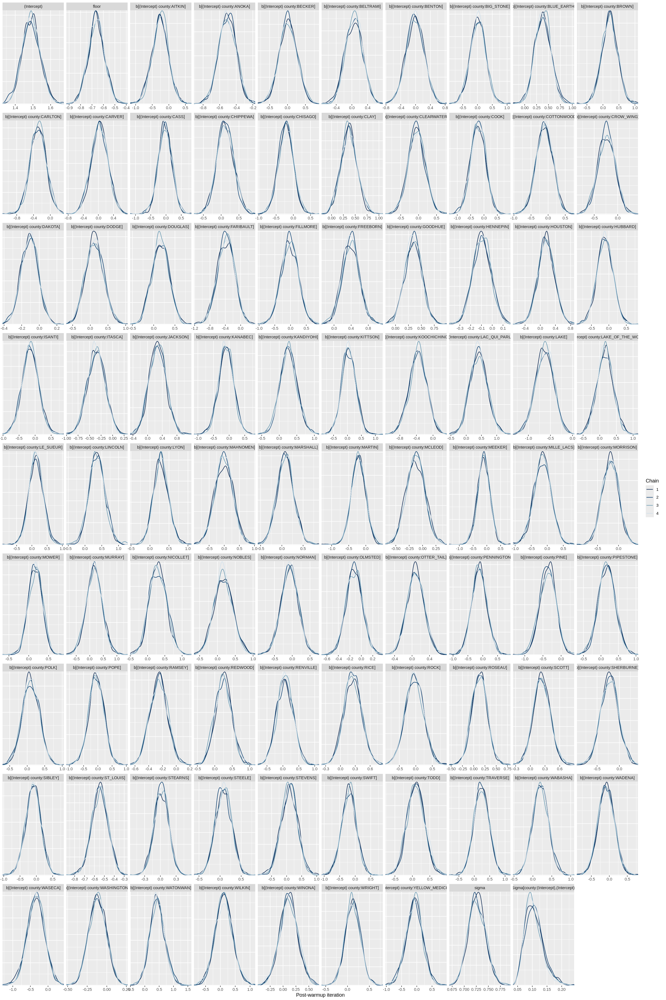

In [ ]:
options(repr.plot.width = 20, repr.plot.height = 30)
mcmc_dens_overlay(partial_pooling_model) +
  xlab("Post-warmup iteration")

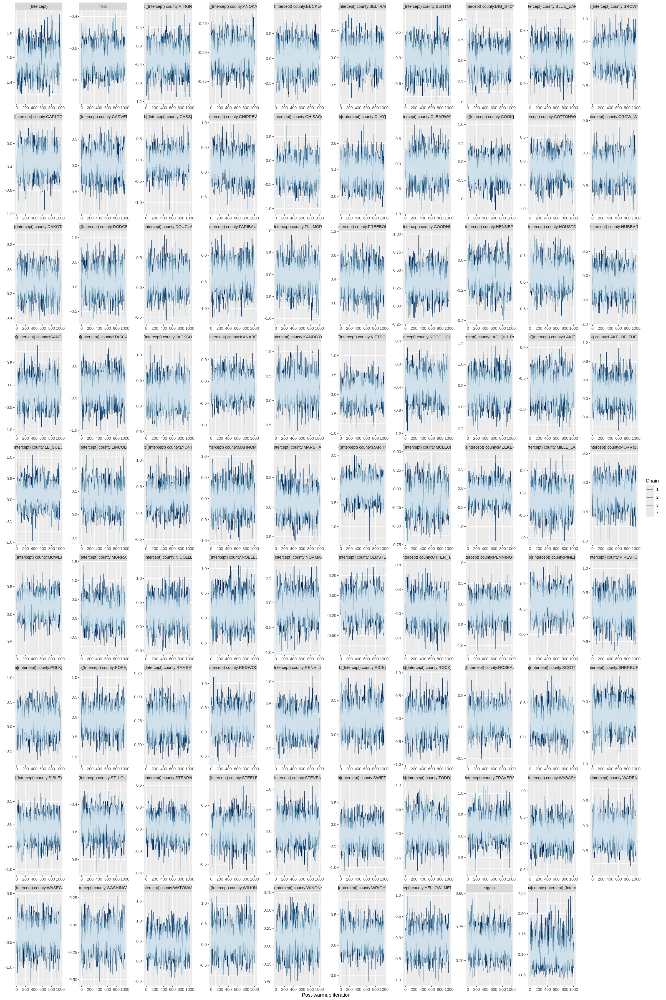

In [ ]:
options(repr.plot.width = 20, repr.plot.height = 30)
mcmc_trace(partial_pooling_model) +
  xlab("Post-warmup iteration")

## Plot posterior distributions

The [posterior probability](https://en.wikipedia.org/wiki/Posterior_probability) is a type of [conditional probability](https://en.wikipedia.org/wiki/Conditional_probability) that results from [updating](https://en.wikipedia.org/wiki/Bayesian_updating) the [prior probability](https://en.wikipedia.org/wiki/Prior_probability) with information summarized by the [likelihood](https://en.wikipedia.org/wiki/Likelihood_function) via an application of [Bayes' rule](https://en.wikipedia.org/wiki/Bayes%27_rule).

Chapter 7 [The Posterior - The Goal of Bayesian
Inference](https://sites.math.rutgers.edu/~zeilberg/EM20/Lambert.pdf) in "A Student's Guide to Bayesian Statistics" by Ben Lambert

[`as.array` `as.matrix` `as.data.frame`](https://mc-stan.org/rstanarm/reference/as.matrix.stanreg.html): Extract the posterior sample. For models fit using MCMC (`algorithm="sampling"`), the posterior sample -the post-warmup draws from the posterior distribution- can be extracted from a fitted model object as a matrix, data frame, or array. The `as.matrix` and `as.data.frame` methods merge all chains together, whereas the `as.array` method keeps the chains separate.

[`pp_check`](https://mc-stan.org/bayesplot/reference/pp_check.html): Posterior (or prior) predictive checks (S3 generic and default method).

In [ ]:
post_partial_pooling_model <- as.array(partial_pooling_model)
dim(post_partial_pooling_model)

[1] 1000    4   89

In [ ]:
dimnames(post_partial_pooling_model)

$iterations
NULL

$chains
[1] "chain:1" "chain:2" "chain:3" "chain:4"

$parameters
 [1] "(Intercept)"                            
 [2] "floor"                                  
 [3] "b[(Intercept) county:AITKIN]"           
 [4] "b[(Intercept) county:ANOKA]"            
 [5] "b[(Intercept) county:BECKER]"           
 [6] "b[(Intercept) county:BELTRAMI]"         
 [7] "b[(Intercept) county:BENTON]"           
 [8] "b[(Intercept) county:BIG_STONE]"        
 [9] "b[(Intercept) county:BLUE_EARTH]"       
[10] "b[(Intercept) county:BROWN]"            
[11] "b[(Intercept) county:CARLTON]"          
[12] "b[(Intercept) county:CARVER]"           
[13] "b[(Intercept) county:CASS]"             
[14] "b[(Intercept) county:CHIPPEWA]"         
[15] "b[(Intercept) county:CHISAGO]"          
[16] "b[(Intercept) county:CLAY]"             
[17] "b[(Intercept) county:CLEARWATER]"       
[18] "b[(Intercept) county:COOK]"             
[19] "b[(Intercept) county:COTTONWOOD]"       
[20] "b[(Intercept) county:CROW_WING]"        
[21] "b[(Intercept) county:DAKOTA]"           
[22] "b[(Intercept) county:DODGE]"            
[23] "b[(Intercept) county:DOUGLAS]"          
[24] "b[(Intercept) county:FARIBAULT]"        
[25] "b[(Intercept) county:FILLMORE]"         
[26] "b[(Intercept) county:FREEBORN]"         
[27] "b[(Intercept) county:GOODHUE]"          
[28] "b[(Intercept) county:HENNEPIN]"         
[29] "b[(Intercept) county:HOUSTON]"          
[30] "b[(Intercept) county:HUBBARD]"          
[31] "b[(Intercept) county:ISANTI]"           
[32] "b[(Intercept) county:ITASCA]"           
[33] "b[(Intercept) county:JACKSON]"          
[34] "b[(Intercept) county:KANABEC]"          
[35] "b[(Intercept) county:KANDIYOHI]"        
[36] "b[(Intercept) county:KITTSON]"          
[37] "b[(Intercept) county:KOOCHICHING]"      
[38] "b[(Intercept) county:LAC_QUI_PARLE]"    
[39] "b[(Intercept) county:LAKE]"             
[40] "b[(Intercept) county:LAKE_OF_THE_WOODS]"
[41] "b[(Intercept) county:LE_SUEUR]"         
[42] "b[(Intercept) county:LINCOLN]"          
[43] "b[(Intercept) county:LYON]"             
[44] "b[(Intercept) county:MAHNOMEN]"         
[45] "b[(Intercept) county:MARSHALL]"         
[46] "b[(Intercept) county:MARTIN]"           
[47] "b[(Intercept) county:MCLEOD]"           
[48] "b[(Intercept) county:MEEKER]"           
[49] "b[(Intercept) county:MILLE_LACS]"       
[50] "b[(Intercept) county:MORRISON]"         
[51] "b[(Intercept) county:MOWER]"            
[52] "b[(Intercept) county:MURRAY]"           
[53] "b[(Intercept) county:NICOLLET]"         
[54] "b[(Intercept) county:NOBLES]"           
[55] "b[(Intercept) county:NORMAN]"           
[56] "b[(Intercept) county:OLMSTED]"          
[57] "b[(Intercept) county:OTTER_TAIL]"       
[58] "b[(Intercept) county:PENNINGTON]"       
[59] "b[(Intercept) county:PINE]"             
[60] "b[(Intercept) county:PIPESTONE]"        
[61] "b[(Intercept) county:POLK]"             
[62] "b[(Intercept) county:POPE]"             
[63] "b[(Intercept) county:RAMSEY]"           
[64] "b[(Intercept) county:REDWOOD]"          
[65] "b[(Intercept) county:RENVILLE]"         
[66] "b[(Intercept) county:RICE]"             
[67] "b[(Intercept) county:ROCK]"             
[68] "b[(Intercept) county:ROSEAU]"           
[69] "b[(Intercept) county:SCOTT]"            
[70] "b[(Intercept) county:SHERBURNE]"        
[71] "b[(Intercept) county:SIBLEY]"           
[72] "b[(Intercept) county:ST_LOUIS]"         
[73] "b[(Intercept) county:STEARNS]"          
[74] "b[(Intercept) county:STEELE]"           
[75] "b[(Intercept) county:STEVENS]"          
[76] "b[(Intercept) county:SWIFT]"            
[77] "b[(Intercept) county:TODD]"             
[78] "b[(Intercept) county:TRAVERSE]"         
[79] "b[(Intercept) county:WABASHA]"          
[80] "b[(Intercept) county:WADENA]"           
[81] "b[(Intercept) county:WASECA]"           
[82] "b[(Intercept) county:WASHINGTON]"       
[83] "b[(Intercept) county:WATONWAN]"         
[84] "b[(Interce

In [ ]:
post_partial_pooling_model <- as.matrix(partial_pooling_model)
dim(post_partial_pooling_model)

[1] 4000   89

In [ ]:
dimnames(post_partial_pooling_model)

$iterations
NULL

$parameters
 [1] "(Intercept)"                            
 [2] "floor"                                  
 [3] "b[(Intercept) county:AITKIN]"           
 [4] "b[(Intercept) county:ANOKA]"            
 [5] "b[(Intercept) county:BECKER]"           
 [6] "b[(Intercept) county:BELTRAMI]"         
 [7] "b[(Intercept) county:BENTON]"           
 [8] "b[(Intercept) county:BIG_STONE]"        
 [9] "b[(Intercept) county:BLUE_EARTH]"       
[10] "b[(Intercept) county:BROWN]"            
[11] "b[(Intercept) county:CARLTON]"          
[12] "b[(Intercept) county:CARVER]"           
[13] "b[(Intercept) county:CASS]"             
[14] "b[(Intercept) county:CHIPPEWA]"         
[15] "b[(Intercept) county:CHISAGO]"          
[16] "b[(Intercept) county:CLAY]"             
[17] "b[(Intercept) county:CLEARWATER]"       
[18] "b[(Intercept) county:COOK]"             
[19] "b[(Intercept) county:COTTONWOOD]"       
[20] "b[(Intercept) county:CROW_WING]"        
[21] "b[(Intercept) county:DAKOTA]"           
[22] "b[(Intercept) county:DODGE]"            
[23] "b[(Intercept) county:DOUGLAS]"          
[24] "b[(Intercept) county:FARIBAULT]"        
[25] "b[(Intercept) county:FILLMORE]"         
[26] "b[(Intercept) county:FREEBORN]"         
[27] "b[(Intercept) county:GOODHUE]"          
[28] "b[(Intercept) county:HENNEPIN]"         
[29] "b[(Intercept) county:HOUSTON]"          
[30] "b[(Intercept) county:HUBBARD]"          
[31] "b[(Intercept) county:ISANTI]"           
[32] "b[(Intercept) county:ITASCA]"           
[33] "b[(Intercept) county:JACKSON]"          
[34] "b[(Intercept) county:KANABEC]"          
[35] "b[(Intercept) county:KANDIYOHI]"        
[36] "b[(Intercept) county:KITTSON]"          
[37] "b[(Intercept) county:KOOCHICHING]"      
[38] "b[(Intercept) county:LAC_QUI_PARLE]"    
[39] "b[(Intercept) county:LAKE]"             
[40] "b[(Intercept) county:LAKE_OF_THE_WOODS]"
[41] "b[(Intercept) county:LE_SUEUR]"         
[42] "b[(Intercept) county:LINCOLN]"          
[43] "b[(Intercept) county:LYON]"             
[44] "b[(Intercept) county:MAHNOMEN]"         
[45] "b[(Intercept) county:MARSHALL]"         
[46] "b[(Intercept) county:MARTIN]"           
[47] "b[(Intercept) county:MCLEOD]"           
[48] "b[(Intercept) county:MEEKER]"           
[49] "b[(Intercept) county:MILLE_LACS]"       
[50] "b[(Intercept) county:MORRISON]"         
[51] "b[(Intercept) county:MOWER]"            
[52] "b[(Intercept) county:MURRAY]"           
[53] "b[(Intercept) county:NICOLLET]"         
[54] "b[(Intercept) county:NOBLES]"           
[55] "b[(Intercept) county:NORMAN]"           
[56] "b[(Intercept) county:OLMSTED]"          
[57] "b[(Intercept) county:OTTER_TAIL]"       
[58] "b[(Intercept) county:PENNINGTON]"       
[59] "b[(Intercept) county:PINE]"             
[60] "b[(Intercept) county:PIPESTONE]"        
[61] "b[(Intercept) county:POLK]"             
[62] "b[(Intercept) county:POPE]"             
[63] "b[(Intercept) county:RAMSEY]"           
[64] "b[(Intercept) county:REDWOOD]"          
[65] "b[(Intercept) county:RENVILLE]"         
[66] "b[(Intercept) county:RICE]"             
[67] "b[(Intercept) county:ROCK]"             
[68] "b[(Intercept) county:ROSEAU]"           
[69] "b[(Intercept) county:SCOTT]"            
[70] "b[(Intercept) county:SHERBURNE]"        
[71] "b[(Intercept) county:SIBLEY]"           
[72] "b[(Intercept) county:ST_LOUIS]"         
[73] "b[(Intercept) county:STEARNS]"          
[74] "b[(Intercept) county:STEELE]"           
[75] "b[(Intercept) county:STEVENS]"          
[76] "b[(Intercept) county:SWIFT]"            
[77] "b[(Intercept) county:TODD]"             
[78] "b[(Intercept) county:TRAVERSE]"         
[79] "b[(Intercept) county:WABASHA]"          
[80] "b[(Intercept) county:WADENA]"           
[81] "b[(Intercept) county:WASECA]"           
[82] "b[(Intercept) county:WASHINGTON]"       
[83] "b[(Intercept) county:WATONWAN]"         
[84] "b[(Intercept) county:WILKIN]"           
[85] "b[(Intercept) co

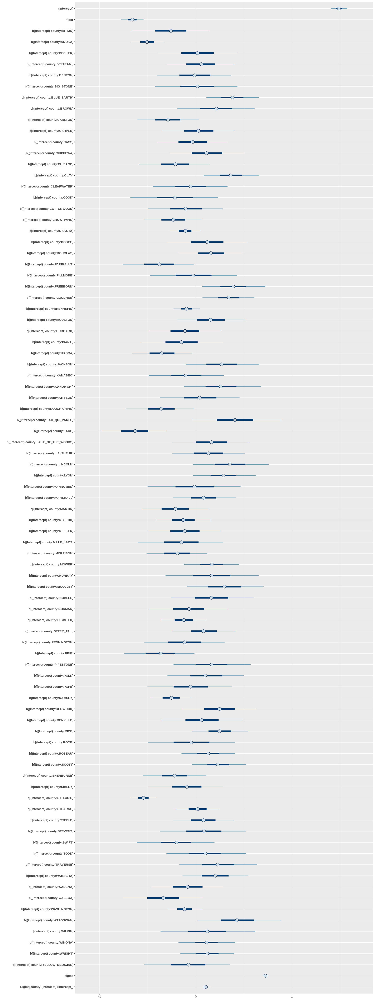

In [ ]:
options(repr.plot.width = 15, repr.plot.height = 40)
mcmc_intervals(post_partial_pooling_model)
# g1 <- mcmc_intervals(post_partial_pooling_model, pars = c("(Intercept)"))
# g2 <- mcmc_intervals(post_partial_pooling_model, pars = c("sigma"))
# g1 + g2

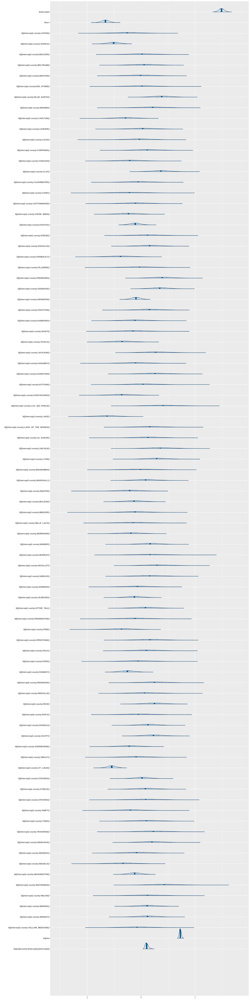

In [ ]:
options(repr.plot.width = 15, repr.plot.height = 60)
mcmc_areas(post_partial_pooling_model)

`stat_bin()` using `bins = 30`. Pick better value `binwidth`.


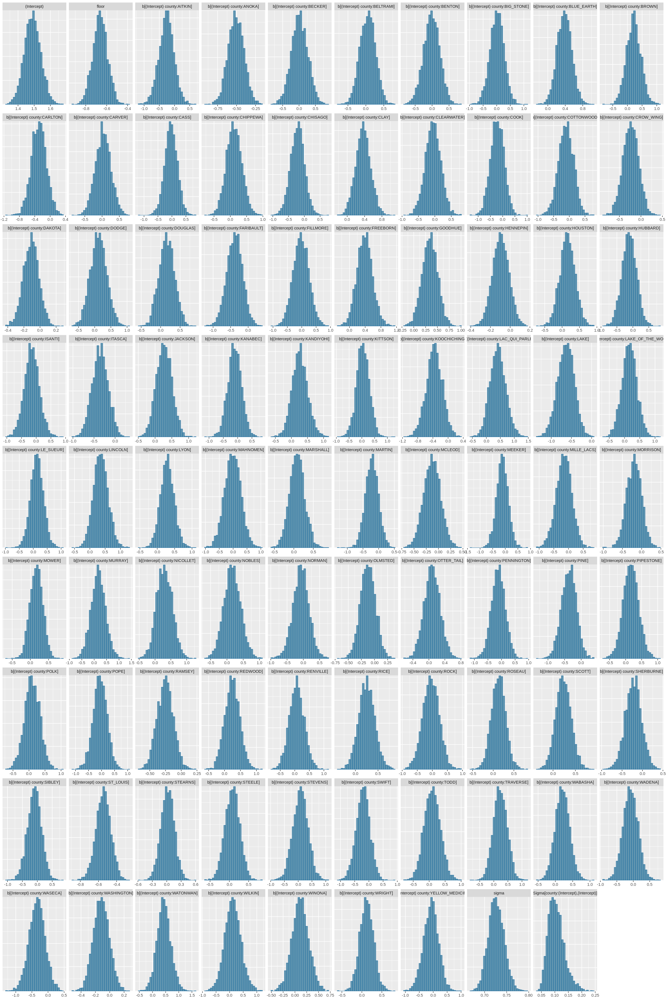

In [ ]:
options(repr.plot.width = 20, repr.plot.height = 30)
mcmc_hist(post_partial_pooling_model)

In [ ]:
print(partial_pooling_model)

stan_lmer
 family:       gaussian [identity]
 formula:      log_radon ~ floor + (1 | county)
 observations: 919
------
            Median MAD_SD
(Intercept)  1.5    0.1  
floor       -0.7    0.1  

Auxiliary parameter(s):
      Median MAD_SD
sigma 0.7    0.0   

Error terms:
 Groups   Name        Std.Dev.
 county   (Intercept) 0.33    
 Residual             0.73    
Num. levels: county 85 

------
* For help interpreting the printed output see ?print.stanreg
* For info on the priors used see ?prior_summary.stanreg


## Plot posterior predictive distributions

[Posterior predictive checks (PPCs)](https://www.pymc.io/projects/docs/en/stable/learn/core_notebooks/posterior_predictive.html) are a great way to validate a model. The idea is to generate data from the model using parameters from draws from the posterior.

Elaborating slightly, one can say that PPCs analyze the degree to which data generated from the model deviate from data generated from the true distribution. So, often you will want to know if, for example, your posterior distribution is approximating your underlying distribution. The visualization aspect of this model evaluation method is also great for a 'sense check' or explaining your model to others and getting criticism.

[Graphical posterior predictive checks (PPCs)](https://mc-stan.org/bayesplot/articles/graphical-ppcs.html)

The `bayesplot` package provides various plotting functions for graphical posterior predictive checking, that is, creating graphical displays comparing observed data to simulated data from the posterior predictive distribution ([Gabry et al, 2019](https://mc-stan.org/bayesplot/articles/graphical-ppcs.html#gabry2019)).

The idea behind [posterior predictive checking](https://mc-stan.org/docs/stan-users-guide/posterior-prediction.html) is simple: if a model is a good fit then we should be able to use it to generate data that looks a lot like the data we observed. To generate the data used for posterior predictive checks (PPCs) we simulate from the posterior predictive distribution. This is the distribution of the outcome variable implied by a model after using the observed data 𝑦 (a vector of 𝑁 outcome values) to update our beliefs about unknown model parameters 𝜃.

[`posterior_predict`](https://mc-stan.org/rstanarm/reference/posterior_predict.stanreg.html): The posterior predictive distribution is the distribution of the outcome implied by the model after using the observed data to update our beliefs about the unknown parameters in the model. Simulating data from the posterior predictive distribution using the observed predictors is useful for checking the fit of the model. Drawing from the posterior predictive distribution at interesting values of the predictors also lets us visualize how a manipulation of a predictor affects (a function of) the outcome(s). With new observations of predictor variables we can use the posterior predictive distribution to generate predicted outcomes.

[`ppc_dens_overlay`](https://mc-stan.org/bayesplot/reference/PPD-distributions.html): Plot posterior or prior predictive distributions. Each of these functions makes the same plot as the corresponding `ppc_` function but without plotting any observed data `y`.

Note: in most cases the default test statistic 'mean' is too weak to detect anything of interest.

`stat_bin()` using `bins = 30`. Pick better value `binwidth`.


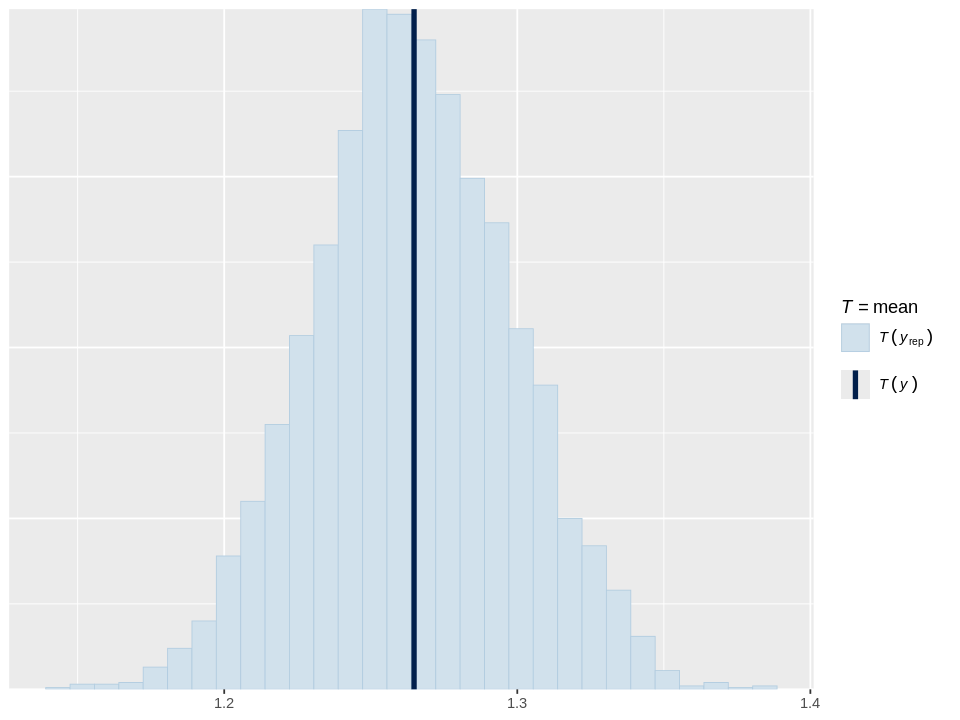

In [ ]:
options(repr.plot.width = 8, repr.plot.height = 6)
pp_check(partial_pooling_model, plotfun = "stat", stat = "mean")

`stat_bin()` using `bins = 30`. Pick better value `binwidth`.


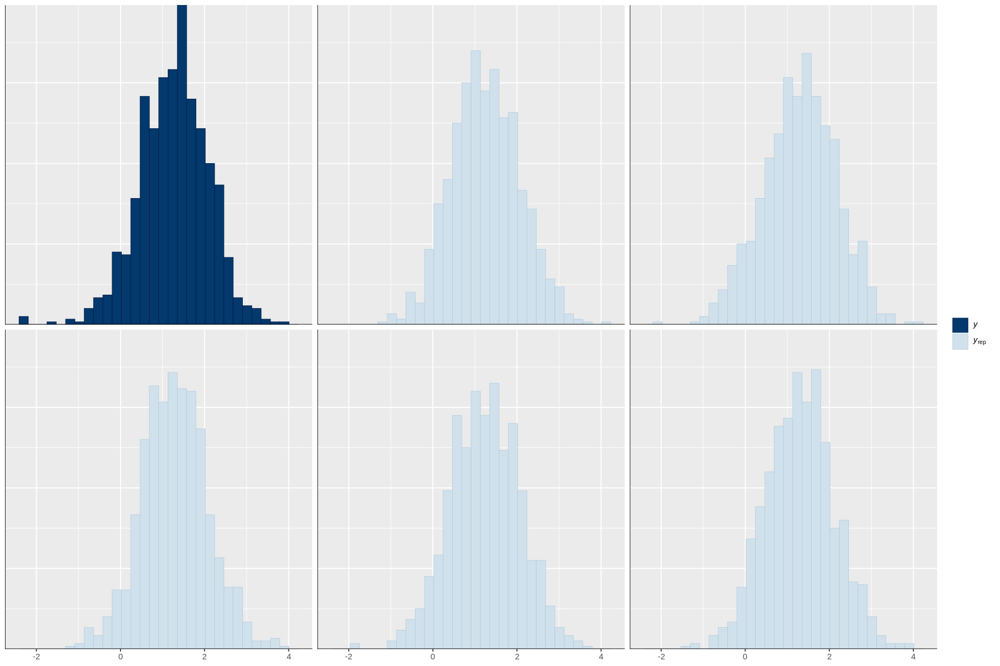

In [ ]:
options(repr.plot.width = 15, repr.plot.height = 10)
pp_check(partial_pooling_model, plotfun = "hist", nreps = 5)

In [ ]:
y <- radon$log_radon

In [ ]:
yrep_partial_pooling <- posterior_predict(partial_pooling_model, draws = 500)
dim(yrep_partial_pooling)

[1] 500 919

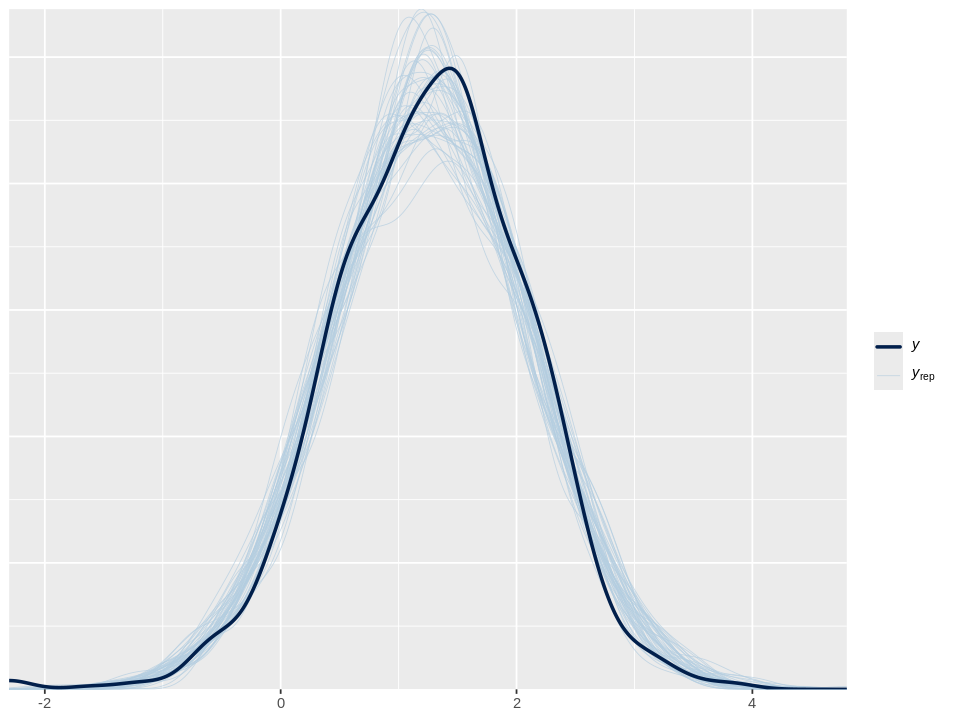

In [ ]:
options(repr.plot.width = 8, repr.plot.height = 6)
ppc_dens_overlay(y, yrep_partial_pooling[1:50, ])

[loo](https://mc-stan.org/loo/index.html): Efficient approximate leave-one-out cross-validation for fitted Bayesian models

From existing posterior simulation draws, we compute approximate `LOO-CV` using Pareto smoothed importance sampling (`PSIS`), a new procedure for regularizing importance weights. As a byproduct of our calculations, we also obtain approximate standard errors for estimated predictive errors and for comparing predictive errors between two models. We recommend `PSIS-LOO-CV` instead of `WAIC`, because `PSIS` provides useful diagnostics and effective sample size and Monte Carlo standard error estimates.

[`loo`](https://mc-stan.org/rstanarm/reference/loo.stanreg.html): For models fit using MCMC, compute approximate leave-one-out cross-validation (`LOO`, `LOOIC`) or, less preferably, the Widely Applicable Information Criterion (`WAIC`) using the loo package. (For 𝐾-fold cross-validation see `kfold.stanreg`.) Functions for model comparison, and model weighting/averaging are also provided.

Estimates the expected log pointwise predictive density (elpd) using Pareto-smoothed importance sampling leave-one-out cross-validation (PSIS-LOO-CV). Also calculates LOO's standard error and the effective number of parameters. Read more theory here https://arxiv.org/abs/1507.04544 and here https://arxiv.org/abs/1507.02646

In [ ]:
loo_partial_pooled = loo(partial_pooling_model)
loo_partial_pooled


Computed from 4000 by 919 log-likelihood matrix.

         Estimate   SE
elpd_loo  -1037.2 28.0
p_loo        49.8  4.3
looic      2074.3 56.1
------
MCSE of elpd_loo is 0.2.
MCSE and ESS estimates assume independent draws (r_eff=1).

All Pareto k estimates are good (k < 0.7).
See help('pareto-k-diagnostic') for details.

[LOO package glossary](https://mc-stan.org/loo/reference/loo-glossary.html)

`elpd`: approximated expected log pointwise predictive density (elpd).

`se`: standard error of the elpd.

`p_loo`: effective number of parameters. If we have a well-specified model, we expect the estimated effective number of parameters (`p_loo`) to be smaller than or similar to the total number of parameters in the model.

Pareto 𝑘 diagnostic values are used to assess the reliability of the estimates. In addition to the proportion of leave-one-out folds with 𝑘 values in different intervals, the minimum of the effective sample sizes in that category is shown to give idea why higher 𝑘 values are bad.

---

## Compare models

In [ ]:
# Compute LOO objects for each model
loo_pooled <- loo(pooled_model)
loo_unpooled <- loo(unpooled_model)
loo_partial_pooled <- loo(partial_pooling_model)

In [ ]:
# Compare models
comparison <- loo_compare(
  loo_pooled,
  loo_unpooled,
  loo_partial_pooled
)

# Round to 2 decimals
print(round(comparison, 2))

                      elpd_diff se_diff
partial_pooling_model   0.0       0.0  
unpooled_model        -26.2       6.4  
pooled_model          -52.7      10.8  


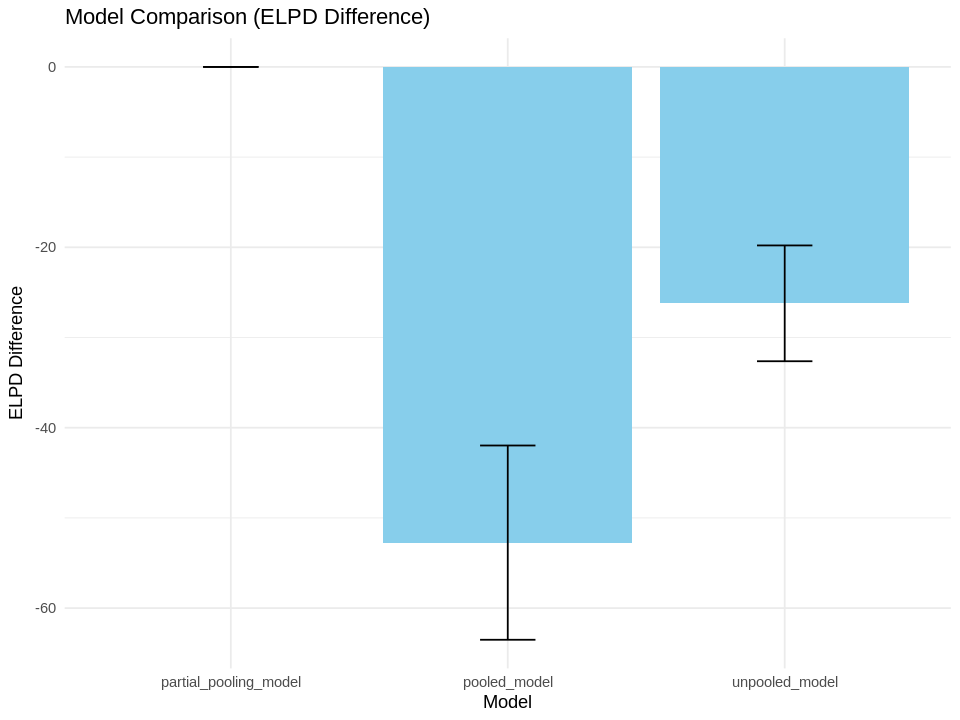

In [ ]:
plot_data <- as.data.frame(comparison)
plot_data$model_name <- rownames(plot_data)

ggplot(plot_data, aes(x = model_name, y = elpd_diff)) +
  geom_bar(stat = "identity", fill = "skyblue") +
  geom_errorbar(aes(ymin = elpd_diff - se_diff, ymax = elpd_diff + se_diff), width = 0.2) +
  labs(title = "Model Comparison (ELPD Difference)",
       x = "Model",
       y = "ELPD Difference") +
  theme_minimal()